In [1]:
data_dir = './data'


import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


In [2]:

%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

# mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
# pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

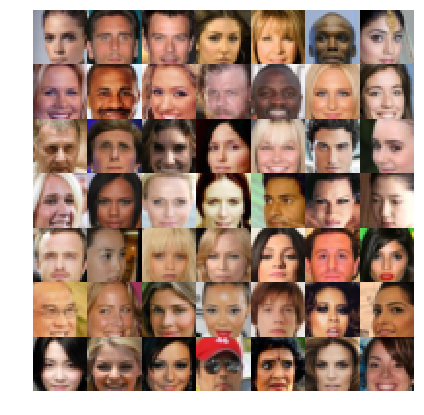

In [3]:
show_n_images = 49

pyplot.figure(figsize=(7,7))
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[650:650+show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))
_ = pyplot.axis('off')

In [4]:
import tensorflow as tf

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    input_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real')
    input_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')
    
    return input_real, input_z, learning_rate


tests.test_model_inputs(model_inputs)

Tests Passed


In [6]:
def discriminator(images, reuse=False):
    
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """

    alpha = 0.1 
    dropout = 0.3
    with tf.variable_scope('discriminator', reuse=reuse):
        
        def leaky_relu(x, alpha=alpha, name='leaky_relu'): 
            return tf.maximum(x, alpha * x, name=name)
        
        lambd = 0.01
        
        #  64
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same',
                              kernel_initializer=tf.contrib.layers.xavier_initializer(),
                              kernel_regularizer=tf.contrib.layers.l2_regularizer(lambd))
          # leaky relu 
        x1 = leaky_relu(x1)
        # dropout
        x1 = tf.layers.dropout(x1, rate=dropout, training=True)
        
        #  128
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, use_bias=False, padding='same',
                              kernel_initializer=tf.contrib.layers.xavier_initializer(),
                              kernel_regularizer=tf.contrib.layers.l2_regularizer(lambd))
        
          # batch normalisation and leaky relu
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = leaky_relu(x2)
        # dropout
        x2 = tf.layers.dropout(x2, rate=dropout, training=True)
        
        #  256
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, use_bias=False, padding='same', 
                              kernel_initializer=tf.contrib.layers.xavier_initializer(),
                              kernel_regularizer=tf.contrib.layers.l2_regularizer(lambd))
          # batch normalisation and leaky relu
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = leaky_relu(x3)
        # dropout
        x3 = tf.layers.dropout(x3, rate=dropout, training=True)
        
        # flatten layer
        flat = tf.reshape(x3, (-1, 4*4*256))
        # output layer
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
    return out, logits



tests.test_discriminator(discriminator, tf)

Tests Passed


In [11]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    dropout = 0.45 # was 0.3 or 0.4, guess 0.4 is good
    alpha = 0.1
    lambd = 0.01
    with tf.variable_scope('generator', reuse= not is_train):
        
        def leaky_relu(x, alpha=alpha, name='leaky_relu'): 
            return tf.maximum(x, alpha * x, name=name)
        
        
        
        # first fully connected layer
        x1 = tf.layers.dense(z, 2*2*1024)
        
        # reshape to 4*4*512
        x1 = tf.reshape(x1, (-1, 2, 2, 1024))
        
          ## batch normalisation and leaky relu
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = leaky_relu(x1)
    
#         print(x1.shape)
        
        # 2nd layer - conv_t - change to (4*4*512)
        x1 = tf.layers.conv2d_transpose(x1, 512, 3, strides=1, use_bias=False ,padding='valid', 
                                        kernel_initializer=tf.contrib.layers.xavier_initializer(),
                                        kernel_regularizer=tf.contrib.layers.l2_regularizer(lambd))
          ## batch normalisation and leaky relu
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = leaky_relu(x1)
        # dropout
        x1 = tf.layers.dropout(x1, rate=dropout, training=is_train)

#         print(x1.shape)
        
        
        
        # 2nd layer - conv_t - change to (7*7*256)
        x2 = tf.layers.conv2d_transpose(x1, 256, 4, strides=1, use_bias=False ,padding='valid', 
                                        kernel_initializer=tf.contrib.layers.xavier_initializer(),
                                        kernel_regularizer=tf.contrib.layers.l2_regularizer(lambd))
          ## batch normalisation and leaky relu
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = leaky_relu(x2)
        # dropout
        x2 = tf.layers.dropout(x2, rate=dropout, training=is_train)

#         print(x2.shape)
        
        # 3rd layer - conv_t - change to (14*14*128)
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, use_bias=False, padding='same',
                                        kernel_initializer=tf.contrib.layers.xavier_initializer(),
                                        kernel_regularizer=tf.contrib.layers.l2_regularizer(lambd))
          ## batch normalisation and leaky relu
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = leaky_relu(x3)
        # dropout
        x3 = tf.layers.dropout(x3, rate=0.3, training=is_train)  # may change to 0.4 is better
        
#         print(x3.shape)
        # output layer - (28*28*out_channel_dim)
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides=2, padding='same')
#         print(logits.shape)

    return tf.tanh(logits)



tests.test_generator(generator, tf)

Tests Passed


In [12]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # generator output
    g_model = generator(input_z, out_channel_dim, is_train=True)
    
    # discriminator output
    d_out_real, d_logits_real = discriminator(input_real, reuse=False)
    d_out_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                    labels=tf.ones_like(d_logits_fake)))
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                                         labels=tf.ones_like(d_logits_real) * 0.9))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                         labels=tf.zeros_like(d_logits_fake)))
    d_loss = d_loss_real + d_loss_fake
    return d_loss, g_loss



tests.test_model_loss(model_loss)

Tests Passed


In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """

    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    
#     with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
#         d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
#         g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
    
    all_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    g_update_ops = [var for var in all_update_ops if var.name.startswith('generator')]
    d_update_ops = [var for var in all_update_ops if var.name.startswith('discriminator')]

    
    with tf.control_dependencies(d_update_ops):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(d_loss, var_list = d_vars)

    with tf.control_dependencies(g_update_ops):
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(g_loss, var_list = g_vars)    
    return d_train_opt, g_train_opt

tests.test_model_opt(model_opt, tf)

Tests Passed


In [14]:
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.figure(figsize=(7,7))
    pyplot.imshow(images_grid, cmap=cmap)
    _ = pyplot.axis('off')
    pyplot.show()

In [15]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """

    input_real, input_z, _ = model_inputs(data_shape[1], 
                                                      data_shape[2], 
                                                      data_shape[3], 
                                                      z_dim)
#     out_channel_dim = 1 if data_image_mode == 'L' else 3
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])#

    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    # store training history
    d_loss_history = []
    g_loss_history = []
    
    
#     saver = tf.train.Saver()
#     sample_z = np.random.uniform(-1, 1, size=(72, z_dim))



    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            steps = 0
            for batch_images in get_batches(batch_size):
                steps += 1
                # sample random noise for Generator
                
                batch_images = batch_images * 2
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images})
#                 _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images})

                if steps % 25 == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})
                    print("Epoch {}: Step {}...".format(epoch_i+1, steps+1),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    d_loss_history.append(train_loss_d)
                    g_loss_history.append(train_loss_g)
                    # Save losses to view after training
#                     losses.append((train_loss_d, train_loss_g))

                if steps % 100 == 0:
                    show_generator_output(sess, 49, input_z, data_shape[3], data_image_mode)

    return (d_loss_history, g_loss_history)

In [16]:
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.4.1
Default GPU Device: /device:GPU:0


Epoch 1: Step 26... Discriminator Loss: 2.9533... Generator Loss: 0.1581
Epoch 1: Step 51... Discriminator Loss: 0.7721... Generator Loss: 2.3108
Epoch 1: Step 76... Discriminator Loss: 0.7411... Generator Loss: 4.1585
Epoch 1: Step 101... Discriminator Loss: 0.7848... Generator Loss: 1.9603


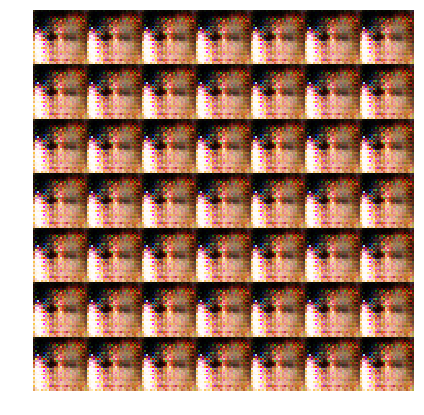

Epoch 1: Step 126... Discriminator Loss: 0.5966... Generator Loss: 2.1515
Epoch 1: Step 151... Discriminator Loss: 1.7720... Generator Loss: 0.3982
Epoch 1: Step 176... Discriminator Loss: 1.3082... Generator Loss: 0.7980
Epoch 1: Step 201... Discriminator Loss: 1.2931... Generator Loss: 2.4436


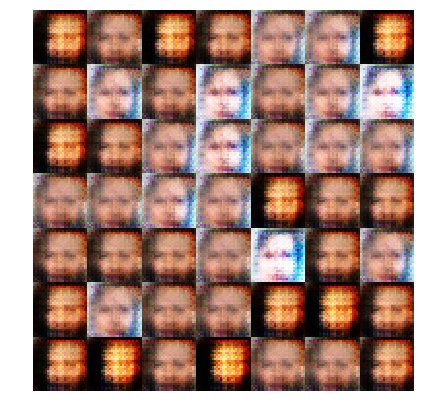

Epoch 1: Step 226... Discriminator Loss: 1.3022... Generator Loss: 2.0916
Epoch 1: Step 251... Discriminator Loss: 0.9551... Generator Loss: 1.5694
Epoch 1: Step 276... Discriminator Loss: 1.6085... Generator Loss: 0.9432
Epoch 1: Step 301... Discriminator Loss: 1.5201... Generator Loss: 0.9451


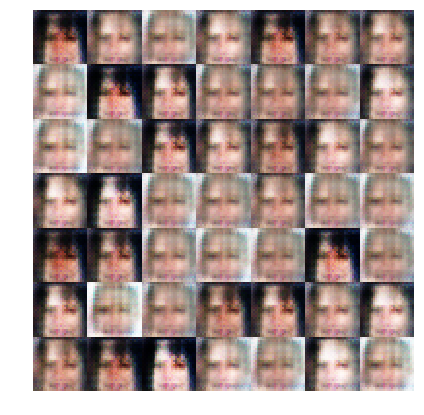

Epoch 1: Step 326... Discriminator Loss: 1.5947... Generator Loss: 0.9170
Epoch 1: Step 351... Discriminator Loss: 1.6594... Generator Loss: 0.5035
Epoch 1: Step 376... Discriminator Loss: 1.5878... Generator Loss: 0.5487
Epoch 1: Step 401... Discriminator Loss: 1.6113... Generator Loss: 0.7565


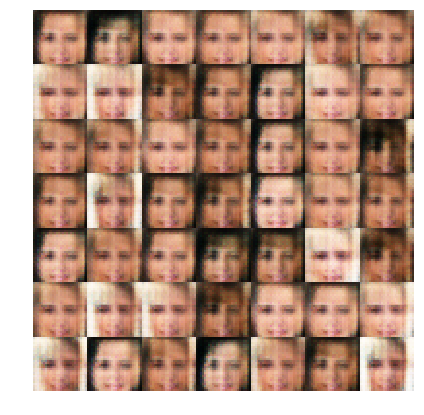

Epoch 1: Step 426... Discriminator Loss: 1.3271... Generator Loss: 0.8281
Epoch 1: Step 451... Discriminator Loss: 1.5312... Generator Loss: 0.8539
Epoch 1: Step 476... Discriminator Loss: 1.3769... Generator Loss: 0.9369
Epoch 1: Step 501... Discriminator Loss: 1.4382... Generator Loss: 0.8541


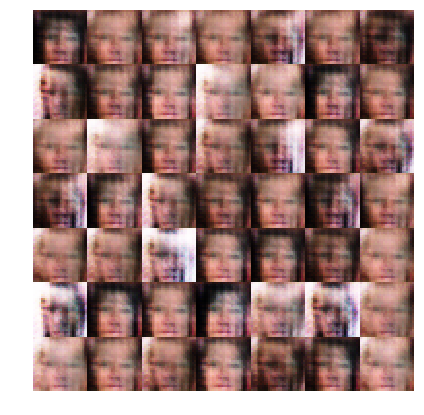

Epoch 1: Step 526... Discriminator Loss: 1.3976... Generator Loss: 0.8907
Epoch 1: Step 551... Discriminator Loss: 1.1874... Generator Loss: 0.8417
Epoch 1: Step 576... Discriminator Loss: 1.4586... Generator Loss: 0.7704
Epoch 1: Step 601... Discriminator Loss: 1.4634... Generator Loss: 0.6164


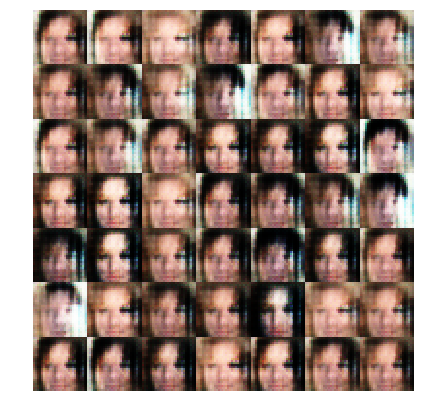

Epoch 1: Step 626... Discriminator Loss: 1.4731... Generator Loss: 0.7588
Epoch 1: Step 651... Discriminator Loss: 1.3011... Generator Loss: 1.1236
Epoch 1: Step 676... Discriminator Loss: 1.4351... Generator Loss: 0.8468
Epoch 1: Step 701... Discriminator Loss: 1.5002... Generator Loss: 0.7463


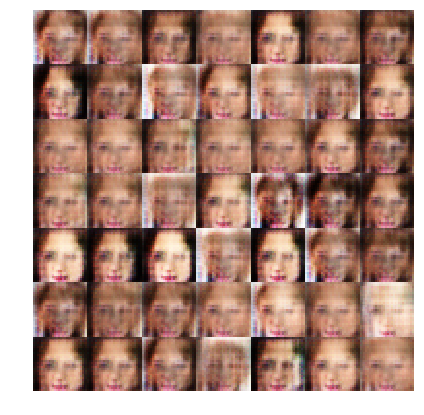

Epoch 1: Step 726... Discriminator Loss: 1.3571... Generator Loss: 0.9864
Epoch 1: Step 751... Discriminator Loss: 1.3608... Generator Loss: 0.8486
Epoch 1: Step 776... Discriminator Loss: 1.3505... Generator Loss: 0.8831
Epoch 1: Step 801... Discriminator Loss: 1.4477... Generator Loss: 0.8066


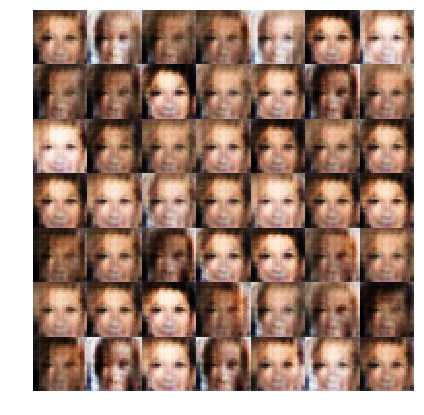

Epoch 1: Step 826... Discriminator Loss: 1.3781... Generator Loss: 0.6643
Epoch 1: Step 851... Discriminator Loss: 1.5241... Generator Loss: 0.6773
Epoch 1: Step 876... Discriminator Loss: 1.3748... Generator Loss: 0.7621
Epoch 1: Step 901... Discriminator Loss: 1.3631... Generator Loss: 0.8046


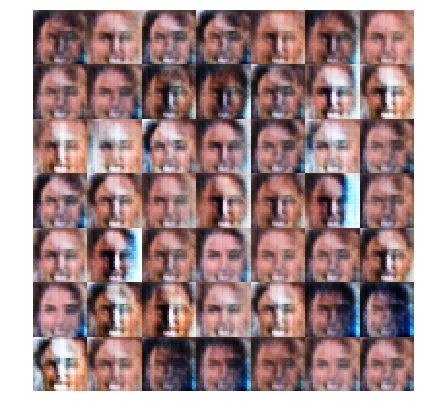

Epoch 1: Step 926... Discriminator Loss: 1.3913... Generator Loss: 0.7911
Epoch 1: Step 951... Discriminator Loss: 1.3618... Generator Loss: 0.8882
Epoch 1: Step 976... Discriminator Loss: 1.4863... Generator Loss: 0.7759
Epoch 1: Step 1001... Discriminator Loss: 1.4388... Generator Loss: 0.6683


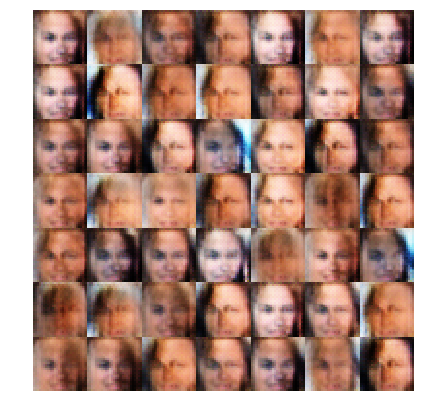

Epoch 1: Step 1026... Discriminator Loss: 1.5152... Generator Loss: 1.0198
Epoch 1: Step 1051... Discriminator Loss: 1.4422... Generator Loss: 0.8157
Epoch 1: Step 1076... Discriminator Loss: 1.3669... Generator Loss: 0.7279
Epoch 1: Step 1101... Discriminator Loss: 1.5141... Generator Loss: 0.5246


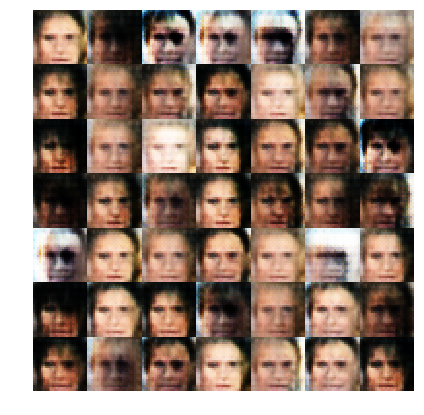

Epoch 1: Step 1126... Discriminator Loss: 1.4494... Generator Loss: 0.5657
Epoch 1: Step 1151... Discriminator Loss: 1.4487... Generator Loss: 0.9625
Epoch 1: Step 1176... Discriminator Loss: 1.3935... Generator Loss: 0.7642
Epoch 1: Step 1201... Discriminator Loss: 1.4415... Generator Loss: 0.7615


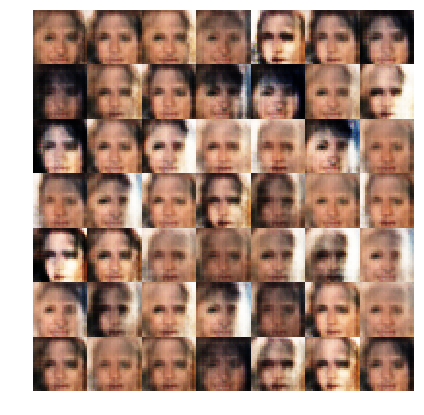

Epoch 1: Step 1226... Discriminator Loss: 1.3630... Generator Loss: 0.6646
Epoch 1: Step 1251... Discriminator Loss: 1.4369... Generator Loss: 0.7901
Epoch 1: Step 1276... Discriminator Loss: 1.3952... Generator Loss: 0.8118
Epoch 1: Step 1301... Discriminator Loss: 1.3032... Generator Loss: 0.7228


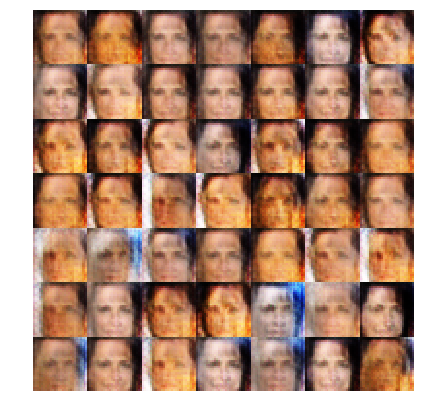

Epoch 1: Step 1326... Discriminator Loss: 1.3821... Generator Loss: 0.7211
Epoch 1: Step 1351... Discriminator Loss: 1.3581... Generator Loss: 0.7769
Epoch 1: Step 1376... Discriminator Loss: 1.4499... Generator Loss: 0.7412
Epoch 1: Step 1401... Discriminator Loss: 1.3677... Generator Loss: 0.8525


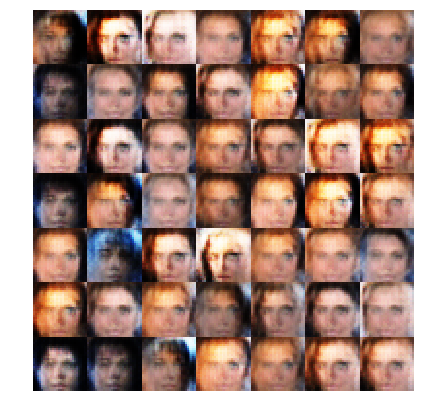

Epoch 1: Step 1426... Discriminator Loss: 1.3852... Generator Loss: 0.7878
Epoch 1: Step 1451... Discriminator Loss: 1.4521... Generator Loss: 0.7466
Epoch 1: Step 1476... Discriminator Loss: 1.4019... Generator Loss: 0.7912
Epoch 1: Step 1501... Discriminator Loss: 1.4285... Generator Loss: 0.8388


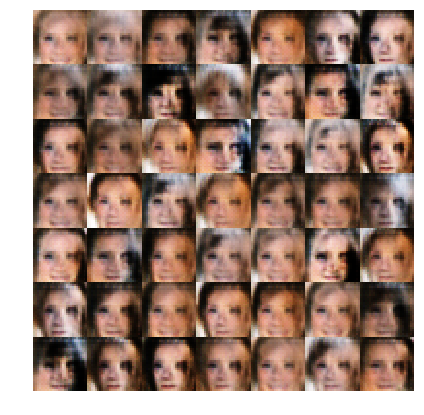

Epoch 1: Step 1526... Discriminator Loss: 1.4139... Generator Loss: 0.9475
Epoch 1: Step 1551... Discriminator Loss: 1.3070... Generator Loss: 0.8625
Epoch 1: Step 1576... Discriminator Loss: 1.4232... Generator Loss: 0.7243
Epoch 1: Step 1601... Discriminator Loss: 1.4033... Generator Loss: 0.7493


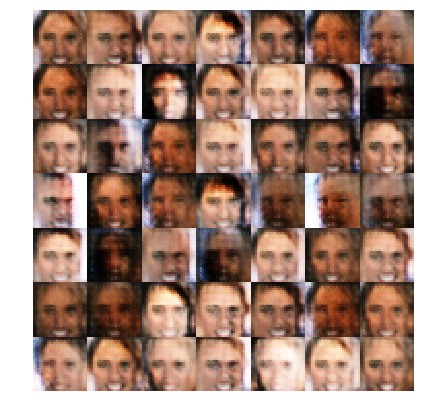

Epoch 1: Step 1626... Discriminator Loss: 1.4867... Generator Loss: 1.0528
Epoch 1: Step 1651... Discriminator Loss: 1.3280... Generator Loss: 0.7513
Epoch 1: Step 1676... Discriminator Loss: 1.3674... Generator Loss: 0.8056
Epoch 1: Step 1701... Discriminator Loss: 1.3957... Generator Loss: 0.7162


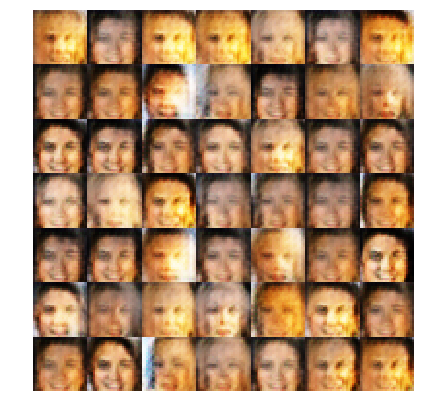

Epoch 1: Step 1726... Discriminator Loss: 1.3919... Generator Loss: 0.6982
Epoch 1: Step 1751... Discriminator Loss: 1.3406... Generator Loss: 0.8796
Epoch 1: Step 1776... Discriminator Loss: 1.3646... Generator Loss: 0.8234
Epoch 1: Step 1801... Discriminator Loss: 1.3819... Generator Loss: 0.8773


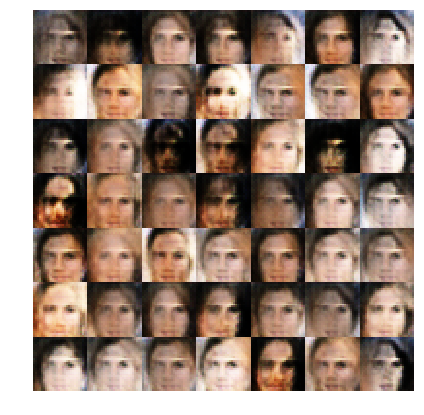

Epoch 1: Step 1826... Discriminator Loss: 1.3764... Generator Loss: 0.7565
Epoch 1: Step 1851... Discriminator Loss: 1.3778... Generator Loss: 0.8774
Epoch 1: Step 1876... Discriminator Loss: 1.4007... Generator Loss: 0.6445
Epoch 1: Step 1901... Discriminator Loss: 1.4173... Generator Loss: 0.7804


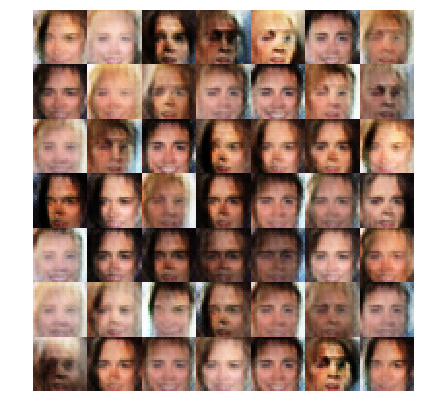

Epoch 1: Step 1926... Discriminator Loss: 1.4021... Generator Loss: 0.7718
Epoch 1: Step 1951... Discriminator Loss: 1.4031... Generator Loss: 0.7598
Epoch 1: Step 1976... Discriminator Loss: 1.4406... Generator Loss: 0.7568
Epoch 1: Step 2001... Discriminator Loss: 1.4387... Generator Loss: 0.6852


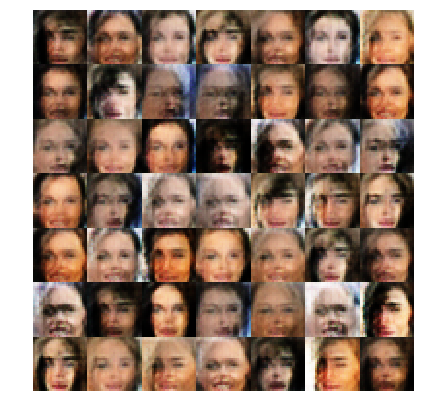

Epoch 1: Step 2026... Discriminator Loss: 1.4172... Generator Loss: 0.7936
Epoch 1: Step 2051... Discriminator Loss: 1.3720... Generator Loss: 0.7821
Epoch 1: Step 2076... Discriminator Loss: 1.4200... Generator Loss: 0.7369
Epoch 1: Step 2101... Discriminator Loss: 1.3826... Generator Loss: 0.8872


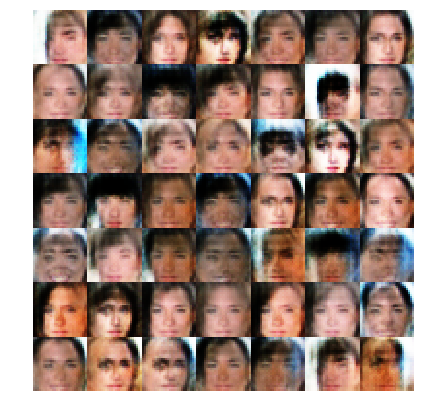

Epoch 1: Step 2126... Discriminator Loss: 1.4446... Generator Loss: 0.8082
Epoch 1: Step 2151... Discriminator Loss: 1.3842... Generator Loss: 0.7761
Epoch 1: Step 2176... Discriminator Loss: 1.3884... Generator Loss: 0.7603
Epoch 1: Step 2201... Discriminator Loss: 1.3908... Generator Loss: 0.8326


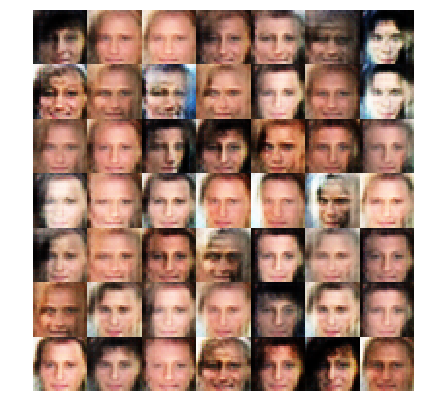

Epoch 1: Step 2226... Discriminator Loss: 1.3685... Generator Loss: 0.8448
Epoch 1: Step 2251... Discriminator Loss: 1.4034... Generator Loss: 0.7565
Epoch 1: Step 2276... Discriminator Loss: 1.4317... Generator Loss: 0.8388
Epoch 1: Step 2301... Discriminator Loss: 1.3804... Generator Loss: 0.7489


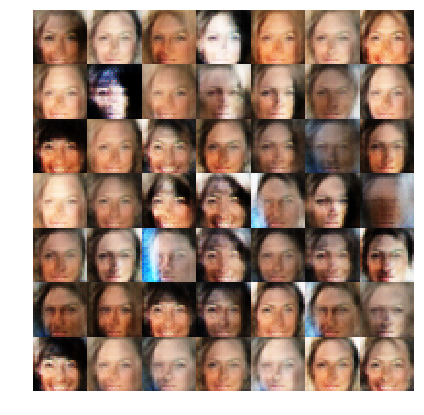

Epoch 1: Step 2326... Discriminator Loss: 1.3779... Generator Loss: 0.6875
Epoch 1: Step 2351... Discriminator Loss: 1.3220... Generator Loss: 0.8214
Epoch 1: Step 2376... Discriminator Loss: 1.4229... Generator Loss: 0.7631
Epoch 1: Step 2401... Discriminator Loss: 1.3899... Generator Loss: 0.8533


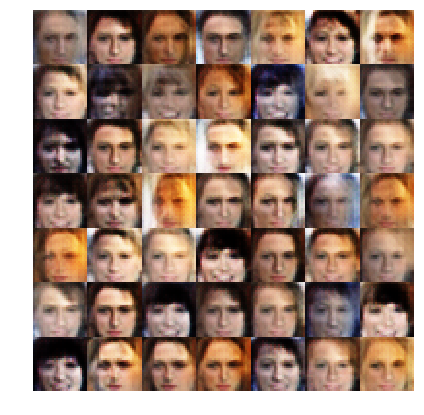

Epoch 1: Step 2426... Discriminator Loss: 1.3714... Generator Loss: 0.7744
Epoch 1: Step 2451... Discriminator Loss: 1.4051... Generator Loss: 0.8839
Epoch 1: Step 2476... Discriminator Loss: 1.3795... Generator Loss: 0.7532
Epoch 1: Step 2501... Discriminator Loss: 1.3501... Generator Loss: 0.8695


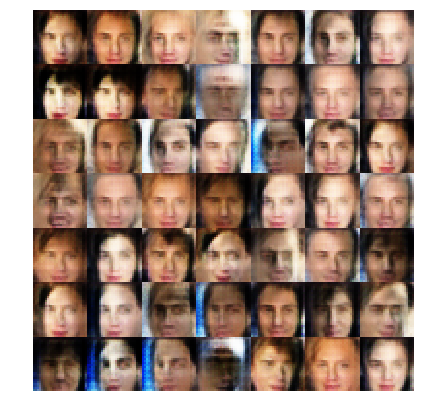

Epoch 1: Step 2526... Discriminator Loss: 1.3938... Generator Loss: 0.8421
Epoch 1: Step 2551... Discriminator Loss: 1.4015... Generator Loss: 0.7158
Epoch 1: Step 2576... Discriminator Loss: 1.3875... Generator Loss: 0.7223
Epoch 1: Step 2601... Discriminator Loss: 1.4152... Generator Loss: 0.7694


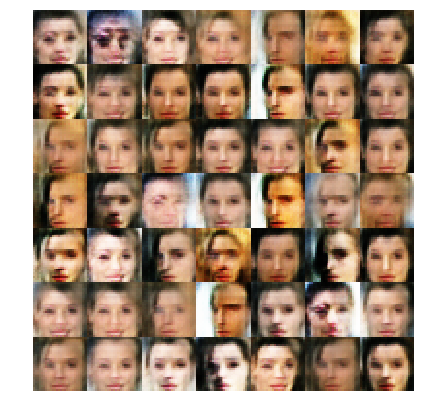

Epoch 1: Step 2626... Discriminator Loss: 1.3974... Generator Loss: 0.7604
Epoch 1: Step 2651... Discriminator Loss: 1.4473... Generator Loss: 0.9699
Epoch 1: Step 2676... Discriminator Loss: 1.3429... Generator Loss: 0.8130
Epoch 1: Step 2701... Discriminator Loss: 1.3829... Generator Loss: 0.8751


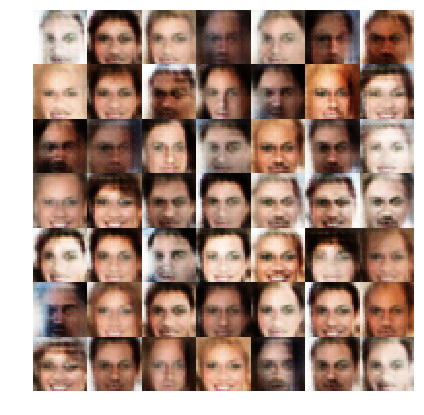

Epoch 1: Step 2726... Discriminator Loss: 1.3854... Generator Loss: 0.8495
Epoch 1: Step 2751... Discriminator Loss: 1.4172... Generator Loss: 0.7355
Epoch 1: Step 2776... Discriminator Loss: 1.4253... Generator Loss: 0.7020
Epoch 1: Step 2801... Discriminator Loss: 1.4060... Generator Loss: 0.7978


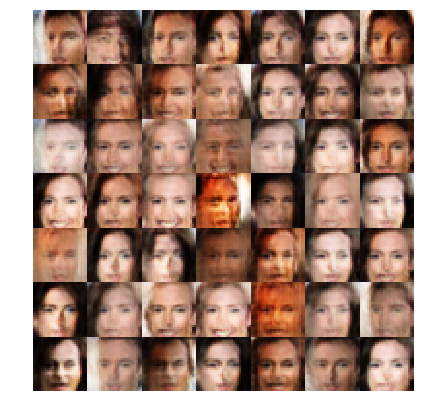

Epoch 1: Step 2826... Discriminator Loss: 1.4031... Generator Loss: 0.7504
Epoch 1: Step 2851... Discriminator Loss: 1.3742... Generator Loss: 0.8202
Epoch 1: Step 2876... Discriminator Loss: 1.3581... Generator Loss: 0.8231
Epoch 1: Step 2901... Discriminator Loss: 1.4247... Generator Loss: 0.8533


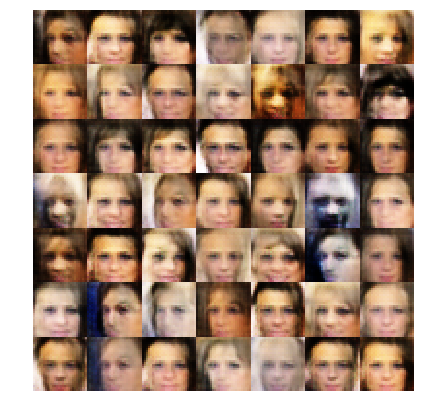

Epoch 1: Step 2926... Discriminator Loss: 1.3873... Generator Loss: 0.7851
Epoch 1: Step 2951... Discriminator Loss: 1.3922... Generator Loss: 0.7501
Epoch 1: Step 2976... Discriminator Loss: 1.3934... Generator Loss: 0.7484
Epoch 1: Step 3001... Discriminator Loss: 1.3651... Generator Loss: 0.8230


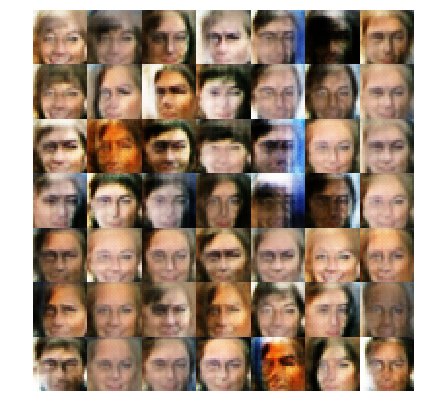

Epoch 1: Step 3026... Discriminator Loss: 1.3712... Generator Loss: 0.6904
Epoch 1: Step 3051... Discriminator Loss: 1.3967... Generator Loss: 0.8571
Epoch 1: Step 3076... Discriminator Loss: 1.3844... Generator Loss: 0.7096
Epoch 1: Step 3101... Discriminator Loss: 1.4329... Generator Loss: 0.9000


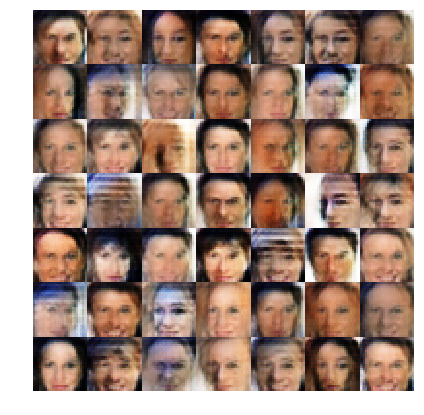

Epoch 1: Step 3126... Discriminator Loss: 1.3868... Generator Loss: 0.8810
Epoch 1: Step 3151... Discriminator Loss: 1.3829... Generator Loss: 0.6962
Epoch 2: Step 26... Discriminator Loss: 1.3650... Generator Loss: 0.8620
Epoch 2: Step 51... Discriminator Loss: 1.3778... Generator Loss: 0.8768
Epoch 2: Step 76... Discriminator Loss: 1.3625... Generator Loss: 0.8262
Epoch 2: Step 101... Discriminator Loss: 1.3794... Generator Loss: 0.7728


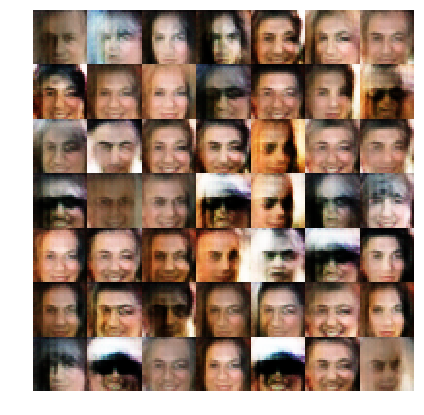

Epoch 2: Step 126... Discriminator Loss: 1.3626... Generator Loss: 0.8126
Epoch 2: Step 151... Discriminator Loss: 1.3796... Generator Loss: 0.9172
Epoch 2: Step 176... Discriminator Loss: 1.4209... Generator Loss: 0.7525
Epoch 2: Step 201... Discriminator Loss: 1.3767... Generator Loss: 0.7962


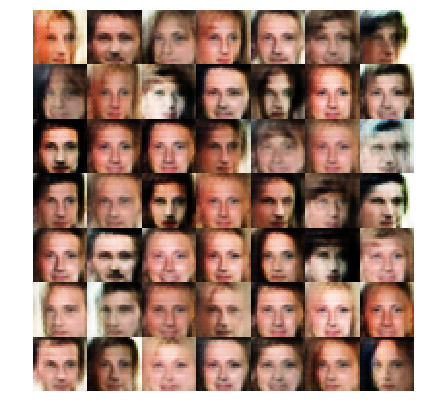

Epoch 2: Step 226... Discriminator Loss: 1.3864... Generator Loss: 0.7528
Epoch 2: Step 251... Discriminator Loss: 1.4183... Generator Loss: 0.8088
Epoch 2: Step 276... Discriminator Loss: 1.4261... Generator Loss: 0.9454
Epoch 2: Step 301... Discriminator Loss: 1.3997... Generator Loss: 0.8045


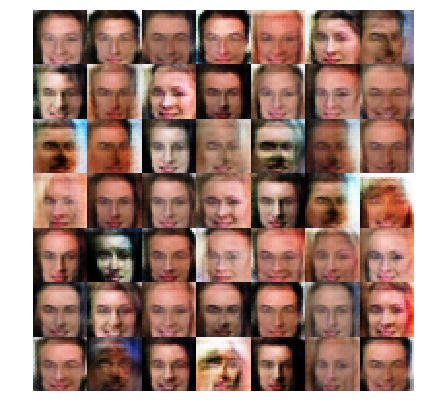

Epoch 2: Step 326... Discriminator Loss: 1.3822... Generator Loss: 0.7456
Epoch 2: Step 351... Discriminator Loss: 1.3867... Generator Loss: 0.7707
Epoch 2: Step 376... Discriminator Loss: 1.3484... Generator Loss: 0.7381
Epoch 2: Step 401... Discriminator Loss: 1.3589... Generator Loss: 0.7643


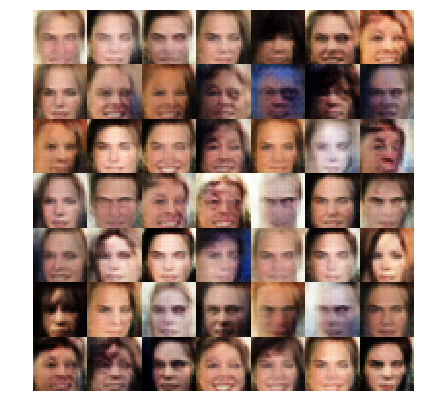

Epoch 2: Step 426... Discriminator Loss: 1.3999... Generator Loss: 0.6978
Epoch 2: Step 451... Discriminator Loss: 1.3980... Generator Loss: 0.7089
Epoch 2: Step 476... Discriminator Loss: 1.3827... Generator Loss: 0.7905
Epoch 2: Step 501... Discriminator Loss: 1.3677... Generator Loss: 0.8561


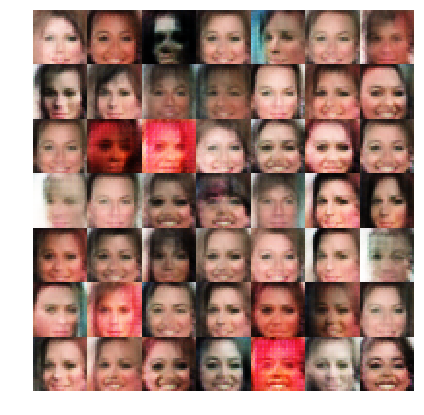

Epoch 2: Step 526... Discriminator Loss: 1.4124... Generator Loss: 0.7715
Epoch 2: Step 551... Discriminator Loss: 1.3726... Generator Loss: 0.7821
Epoch 2: Step 576... Discriminator Loss: 1.3767... Generator Loss: 0.7311
Epoch 2: Step 601... Discriminator Loss: 1.3681... Generator Loss: 0.8263


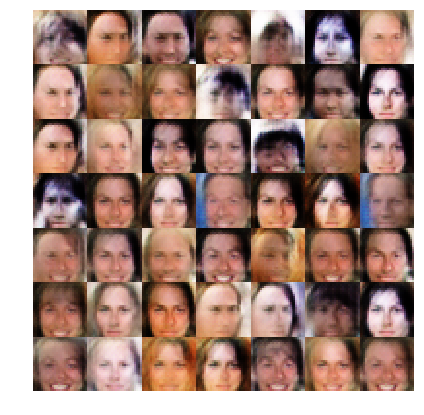

Epoch 2: Step 626... Discriminator Loss: 1.4053... Generator Loss: 0.7344
Epoch 2: Step 651... Discriminator Loss: 1.3670... Generator Loss: 0.8003
Epoch 2: Step 676... Discriminator Loss: 1.3329... Generator Loss: 0.7906
Epoch 2: Step 701... Discriminator Loss: 1.6524... Generator Loss: 0.4632


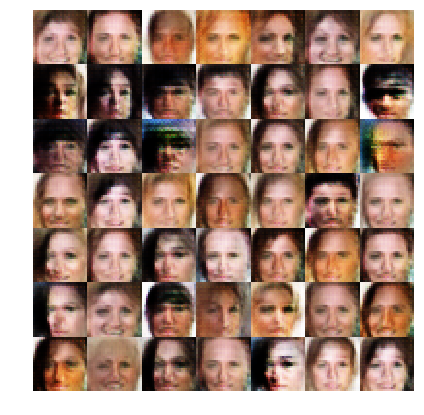

Epoch 2: Step 726... Discriminator Loss: 1.4387... Generator Loss: 0.7838
Epoch 2: Step 751... Discriminator Loss: 1.4032... Generator Loss: 0.9232
Epoch 2: Step 776... Discriminator Loss: 1.4471... Generator Loss: 0.6938
Epoch 2: Step 801... Discriminator Loss: 1.4119... Generator Loss: 0.7725


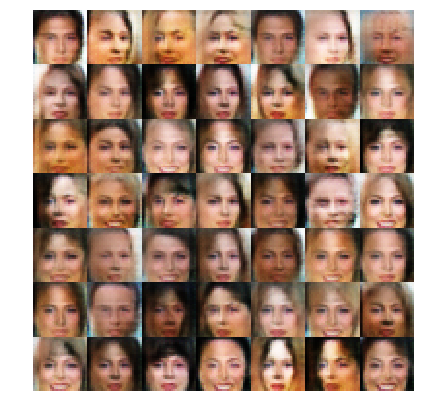

Epoch 2: Step 826... Discriminator Loss: 1.3704... Generator Loss: 0.8648
Epoch 2: Step 851... Discriminator Loss: 1.4017... Generator Loss: 0.7336
Epoch 2: Step 876... Discriminator Loss: 1.3685... Generator Loss: 0.7265
Epoch 2: Step 901... Discriminator Loss: 1.3989... Generator Loss: 0.6926


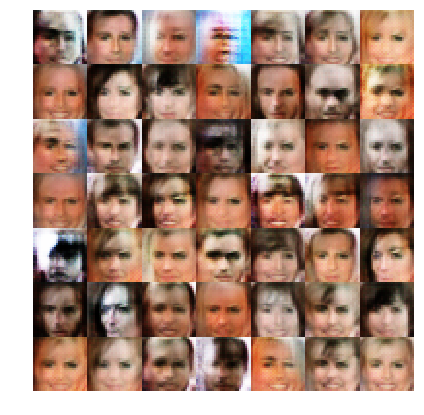

Epoch 2: Step 926... Discriminator Loss: 1.4024... Generator Loss: 0.8710
Epoch 2: Step 951... Discriminator Loss: 1.3886... Generator Loss: 0.8176
Epoch 2: Step 976... Discriminator Loss: 1.4065... Generator Loss: 0.8103
Epoch 2: Step 1001... Discriminator Loss: 1.3632... Generator Loss: 0.8202


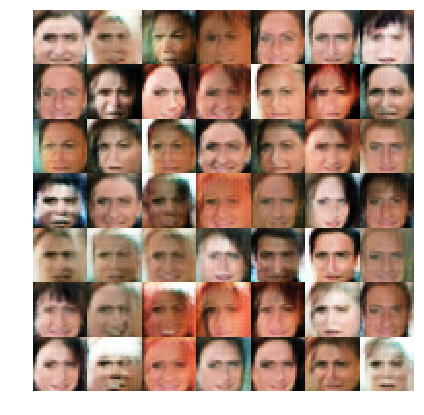

Epoch 2: Step 1026... Discriminator Loss: 1.3903... Generator Loss: 0.8425
Epoch 2: Step 1051... Discriminator Loss: 1.3601... Generator Loss: 0.8196
Epoch 2: Step 1076... Discriminator Loss: 1.3717... Generator Loss: 0.7502
Epoch 2: Step 1101... Discriminator Loss: 1.3880... Generator Loss: 0.8262


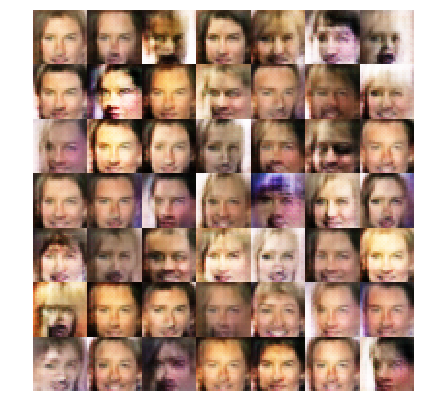

Epoch 2: Step 1126... Discriminator Loss: 1.3622... Generator Loss: 0.7598
Epoch 2: Step 1151... Discriminator Loss: 1.4262... Generator Loss: 0.6417
Epoch 2: Step 1176... Discriminator Loss: 1.3911... Generator Loss: 0.8367
Epoch 2: Step 1201... Discriminator Loss: 1.3889... Generator Loss: 0.8398


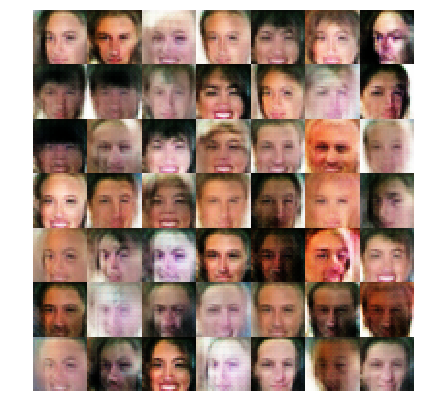

Epoch 2: Step 1226... Discriminator Loss: 1.3725... Generator Loss: 0.6955
Epoch 2: Step 1251... Discriminator Loss: 1.3648... Generator Loss: 0.8226
Epoch 2: Step 1276... Discriminator Loss: 1.4221... Generator Loss: 0.8384
Epoch 2: Step 1301... Discriminator Loss: 1.3687... Generator Loss: 0.7271


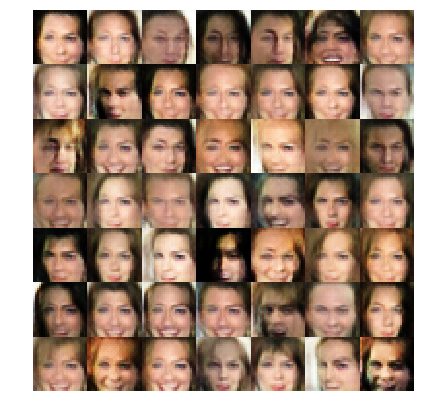

Epoch 2: Step 1326... Discriminator Loss: 1.3822... Generator Loss: 0.8850
Epoch 2: Step 1351... Discriminator Loss: 1.3862... Generator Loss: 0.8799
Epoch 2: Step 1376... Discriminator Loss: 1.3804... Generator Loss: 0.8133
Epoch 2: Step 1401... Discriminator Loss: 1.3853... Generator Loss: 0.8344


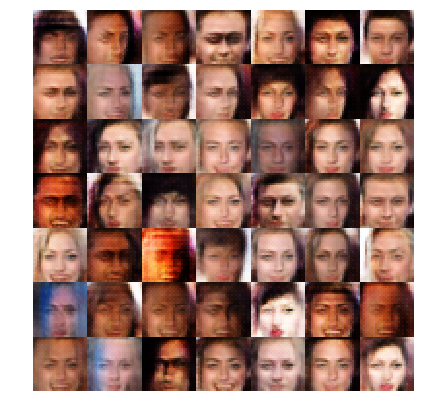

Epoch 2: Step 1426... Discriminator Loss: 1.4007... Generator Loss: 0.8833
Epoch 2: Step 1451... Discriminator Loss: 1.4020... Generator Loss: 0.7547
Epoch 2: Step 1476... Discriminator Loss: 1.3708... Generator Loss: 0.6577
Epoch 2: Step 1501... Discriminator Loss: 1.4074... Generator Loss: 0.8374


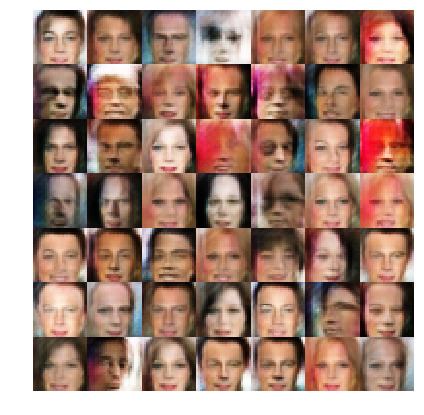

Epoch 2: Step 1526... Discriminator Loss: 1.3702... Generator Loss: 0.8493
Epoch 2: Step 1551... Discriminator Loss: 1.3636... Generator Loss: 0.7526
Epoch 2: Step 1576... Discriminator Loss: 1.4017... Generator Loss: 0.7628
Epoch 2: Step 1601... Discriminator Loss: 1.3497... Generator Loss: 0.7741


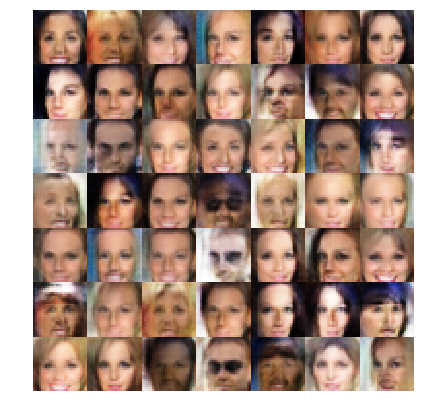

Epoch 2: Step 1626... Discriminator Loss: 1.3975... Generator Loss: 0.7471
Epoch 2: Step 1651... Discriminator Loss: 1.3937... Generator Loss: 0.8460
Epoch 2: Step 1676... Discriminator Loss: 1.3639... Generator Loss: 0.7646
Epoch 2: Step 1701... Discriminator Loss: 1.4379... Generator Loss: 0.8220


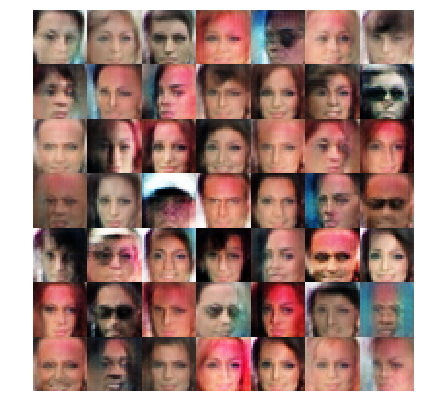

Epoch 2: Step 1726... Discriminator Loss: 1.3751... Generator Loss: 0.7483
Epoch 2: Step 1751... Discriminator Loss: 1.4045... Generator Loss: 0.8845
Epoch 2: Step 1776... Discriminator Loss: 1.3824... Generator Loss: 0.7851
Epoch 2: Step 1801... Discriminator Loss: 1.4078... Generator Loss: 0.8430


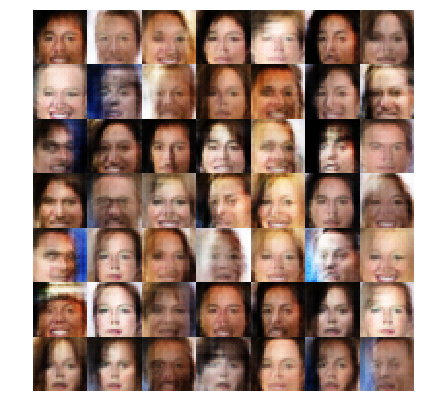

Epoch 2: Step 1826... Discriminator Loss: 1.3889... Generator Loss: 0.8508
Epoch 2: Step 1851... Discriminator Loss: 1.3725... Generator Loss: 0.7808
Epoch 2: Step 1876... Discriminator Loss: 1.3557... Generator Loss: 0.7851
Epoch 2: Step 1901... Discriminator Loss: 1.3273... Generator Loss: 0.8207


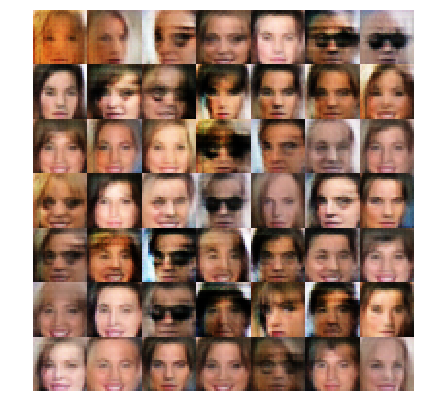

Epoch 2: Step 1926... Discriminator Loss: 1.3931... Generator Loss: 0.8799
Epoch 2: Step 1951... Discriminator Loss: 1.3866... Generator Loss: 0.8148
Epoch 2: Step 1976... Discriminator Loss: 1.3886... Generator Loss: 0.7383
Epoch 2: Step 2001... Discriminator Loss: 1.3571... Generator Loss: 0.7740


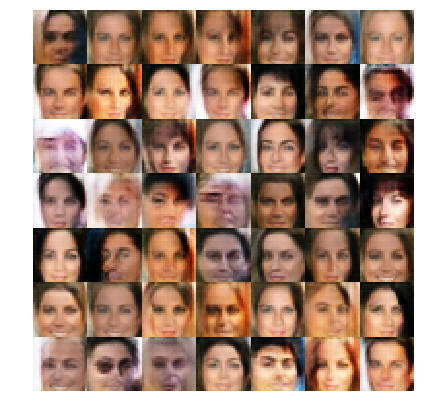

Epoch 2: Step 2026... Discriminator Loss: 1.3505... Generator Loss: 0.8345
Epoch 2: Step 2051... Discriminator Loss: 1.3792... Generator Loss: 0.8429
Epoch 2: Step 2076... Discriminator Loss: 1.3603... Generator Loss: 0.7431
Epoch 2: Step 2101... Discriminator Loss: 1.3778... Generator Loss: 0.8075


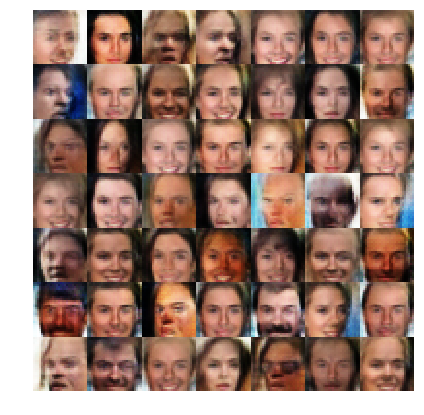

Epoch 2: Step 2126... Discriminator Loss: 1.3603... Generator Loss: 0.8543
Epoch 2: Step 2151... Discriminator Loss: 1.3672... Generator Loss: 0.7585
Epoch 2: Step 2176... Discriminator Loss: 1.3903... Generator Loss: 0.6241
Epoch 2: Step 2201... Discriminator Loss: 1.4034... Generator Loss: 0.8850


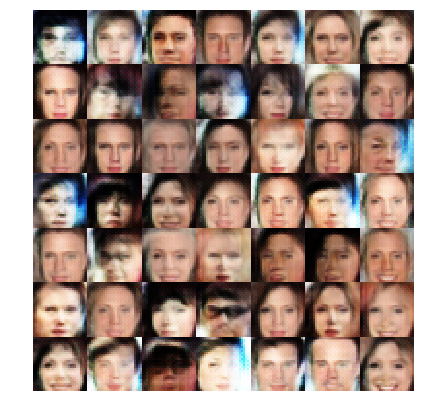

Epoch 2: Step 2226... Discriminator Loss: 1.3692... Generator Loss: 0.8555
Epoch 2: Step 2251... Discriminator Loss: 1.4196... Generator Loss: 0.6104
Epoch 2: Step 2276... Discriminator Loss: 1.3797... Generator Loss: 0.8417
Epoch 2: Step 2301... Discriminator Loss: 1.3874... Generator Loss: 0.8375


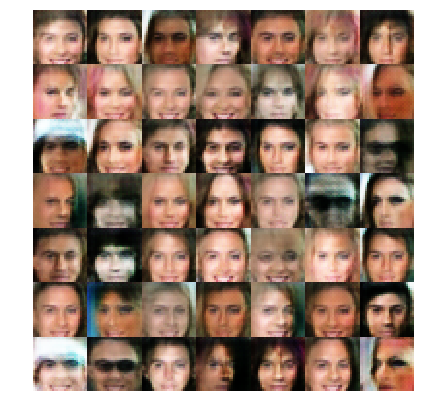

Epoch 2: Step 2326... Discriminator Loss: 1.4496... Generator Loss: 0.5638
Epoch 2: Step 2351... Discriminator Loss: 1.3812... Generator Loss: 0.8566
Epoch 2: Step 2376... Discriminator Loss: 1.3963... Generator Loss: 0.6662
Epoch 2: Step 2401... Discriminator Loss: 1.4173... Generator Loss: 0.8435


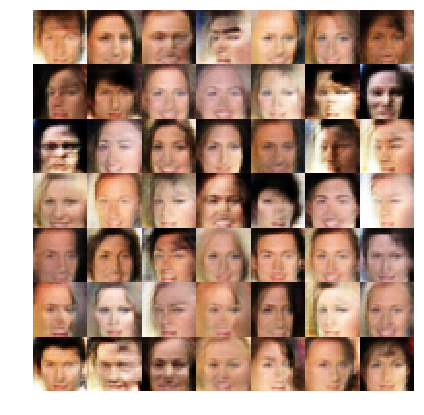

Epoch 2: Step 2426... Discriminator Loss: 1.3869... Generator Loss: 0.8608
Epoch 2: Step 2451... Discriminator Loss: 1.3603... Generator Loss: 0.8760
Epoch 2: Step 2476... Discriminator Loss: 1.3617... Generator Loss: 0.8340
Epoch 2: Step 2501... Discriminator Loss: 1.3495... Generator Loss: 0.9856


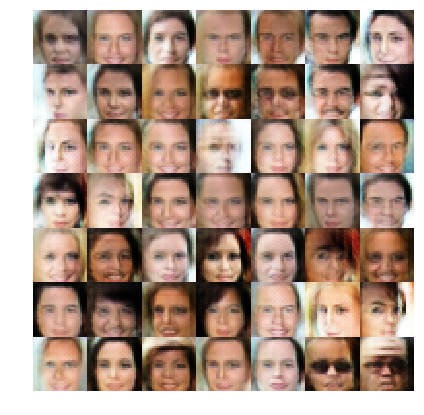

Epoch 2: Step 2526... Discriminator Loss: 1.3427... Generator Loss: 0.9133
Epoch 2: Step 2551... Discriminator Loss: 1.3370... Generator Loss: 0.8168
Epoch 2: Step 2576... Discriminator Loss: 1.3314... Generator Loss: 0.8336
Epoch 2: Step 2601... Discriminator Loss: 1.3395... Generator Loss: 0.8197


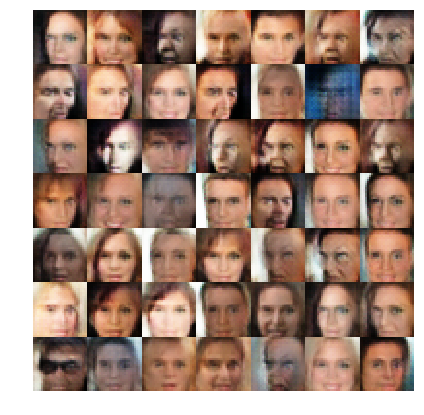

Epoch 2: Step 2626... Discriminator Loss: 1.3251... Generator Loss: 0.8319
Epoch 2: Step 2651... Discriminator Loss: 1.3349... Generator Loss: 0.9171
Epoch 2: Step 2676... Discriminator Loss: 1.3660... Generator Loss: 0.7664
Epoch 2: Step 2701... Discriminator Loss: 1.3732... Generator Loss: 0.8519


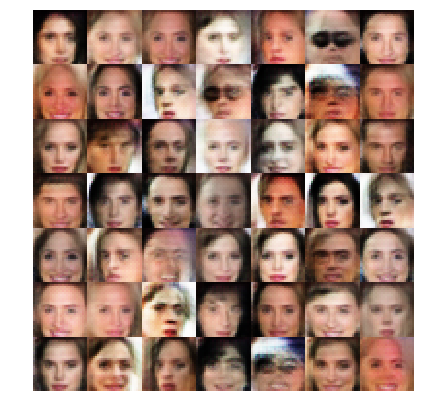

Epoch 2: Step 2726... Discriminator Loss: 1.3738... Generator Loss: 0.6920
Epoch 2: Step 2751... Discriminator Loss: 1.4213... Generator Loss: 0.6168
Epoch 2: Step 2776... Discriminator Loss: 1.3470... Generator Loss: 0.7664
Epoch 2: Step 2801... Discriminator Loss: 1.3067... Generator Loss: 0.8886


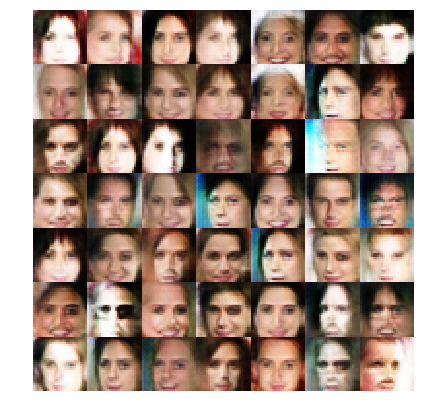

Epoch 2: Step 2826... Discriminator Loss: 1.3519... Generator Loss: 0.7868
Epoch 2: Step 2851... Discriminator Loss: 1.3486... Generator Loss: 0.8014
Epoch 2: Step 2876... Discriminator Loss: 1.3684... Generator Loss: 0.8291
Epoch 2: Step 2901... Discriminator Loss: 1.3380... Generator Loss: 0.9448


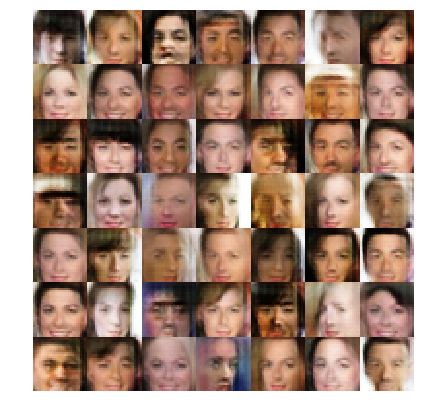

Epoch 2: Step 2926... Discriminator Loss: 1.3281... Generator Loss: 0.8004
Epoch 2: Step 2951... Discriminator Loss: 1.4035... Generator Loss: 0.7862
Epoch 2: Step 2976... Discriminator Loss: 1.3632... Generator Loss: 0.7394
Epoch 2: Step 3001... Discriminator Loss: 1.3675... Generator Loss: 0.8208


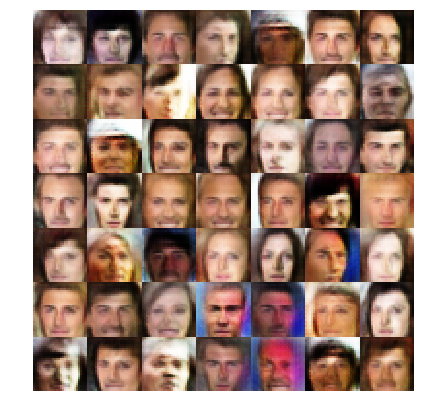

Epoch 2: Step 3026... Discriminator Loss: 1.3168... Generator Loss: 0.8136
Epoch 2: Step 3051... Discriminator Loss: 1.3426... Generator Loss: 0.9201
Epoch 2: Step 3076... Discriminator Loss: 1.3417... Generator Loss: 0.7559
Epoch 2: Step 3101... Discriminator Loss: 1.3715... Generator Loss: 0.8770


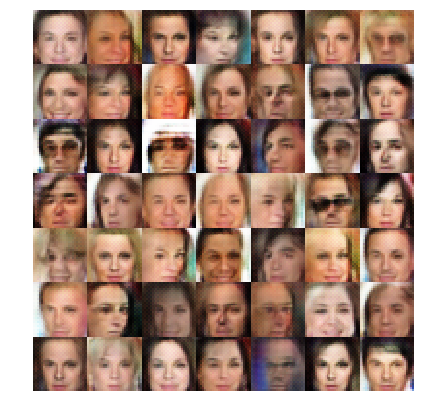

Epoch 2: Step 3126... Discriminator Loss: 1.3340... Generator Loss: 0.8752
Epoch 2: Step 3151... Discriminator Loss: 1.3893... Generator Loss: 0.7969
Epoch 3: Step 26... Discriminator Loss: 1.3669... Generator Loss: 0.7939
Epoch 3: Step 51... Discriminator Loss: 1.3877... Generator Loss: 0.8206
Epoch 3: Step 76... Discriminator Loss: 1.4984... Generator Loss: 0.5604
Epoch 3: Step 101... Discriminator Loss: 1.4076... Generator Loss: 0.8792


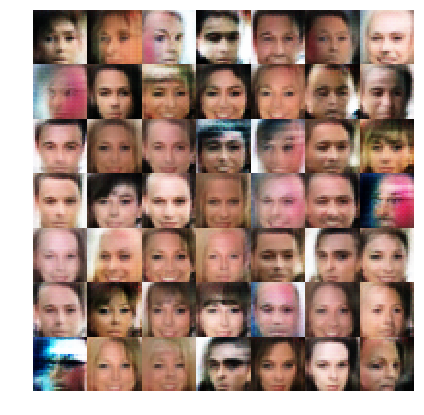

Epoch 3: Step 126... Discriminator Loss: 1.3769... Generator Loss: 0.7984
Epoch 3: Step 151... Discriminator Loss: 1.3546... Generator Loss: 0.9051
Epoch 3: Step 176... Discriminator Loss: 1.3321... Generator Loss: 0.8452
Epoch 3: Step 201... Discriminator Loss: 1.3479... Generator Loss: 0.8312


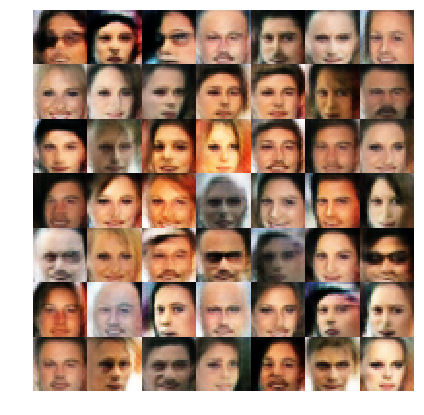

Epoch 3: Step 226... Discriminator Loss: 1.3539... Generator Loss: 0.7058
Epoch 3: Step 251... Discriminator Loss: 1.3850... Generator Loss: 0.7513
Epoch 3: Step 276... Discriminator Loss: 1.3514... Generator Loss: 0.8614
Epoch 3: Step 301... Discriminator Loss: 1.3979... Generator Loss: 0.8166


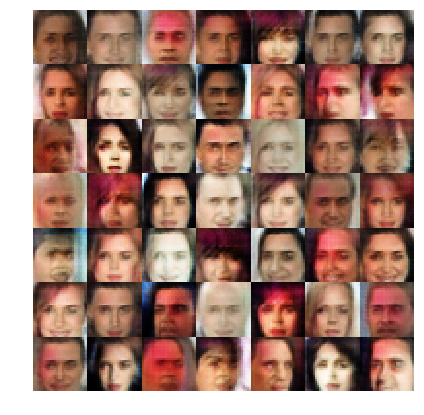

Epoch 3: Step 326... Discriminator Loss: 1.3694... Generator Loss: 0.8508
Epoch 3: Step 351... Discriminator Loss: 1.3495... Generator Loss: 0.8615
Epoch 3: Step 376... Discriminator Loss: 1.3338... Generator Loss: 0.6370
Epoch 3: Step 401... Discriminator Loss: 1.3657... Generator Loss: 0.8800


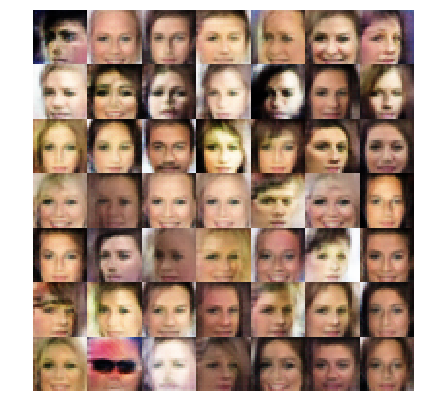

Epoch 3: Step 426... Discriminator Loss: 1.3758... Generator Loss: 0.7055
Epoch 3: Step 451... Discriminator Loss: 1.3437... Generator Loss: 0.8450
Epoch 3: Step 476... Discriminator Loss: 1.3176... Generator Loss: 0.8687
Epoch 3: Step 501... Discriminator Loss: 1.4113... Generator Loss: 0.6644


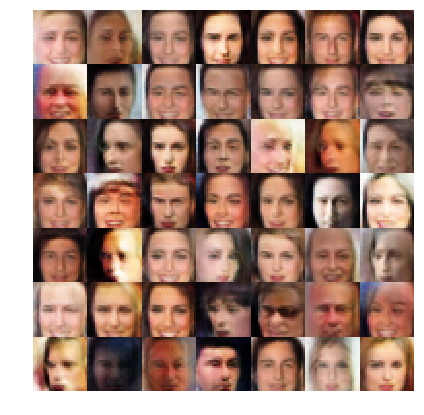

Epoch 3: Step 526... Discriminator Loss: 1.3349... Generator Loss: 0.7767
Epoch 3: Step 551... Discriminator Loss: 1.3518... Generator Loss: 0.8993
Epoch 3: Step 576... Discriminator Loss: 1.3526... Generator Loss: 0.8162
Epoch 3: Step 601... Discriminator Loss: 1.3611... Generator Loss: 0.9751


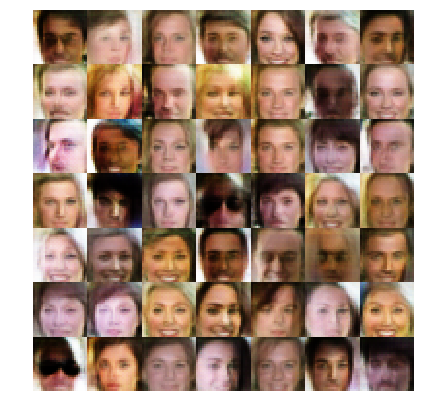

Epoch 3: Step 626... Discriminator Loss: 1.2889... Generator Loss: 0.7389
Epoch 3: Step 651... Discriminator Loss: 1.3667... Generator Loss: 0.8070
Epoch 3: Step 676... Discriminator Loss: 1.3812... Generator Loss: 0.6964
Epoch 3: Step 701... Discriminator Loss: 1.3243... Generator Loss: 0.7865


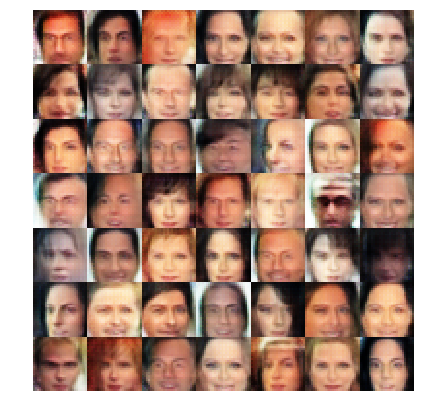

Epoch 3: Step 726... Discriminator Loss: 1.3756... Generator Loss: 0.7323
Epoch 3: Step 751... Discriminator Loss: 1.3598... Generator Loss: 0.8437
Epoch 3: Step 776... Discriminator Loss: 1.3637... Generator Loss: 0.8274
Epoch 3: Step 801... Discriminator Loss: 1.3874... Generator Loss: 0.7786


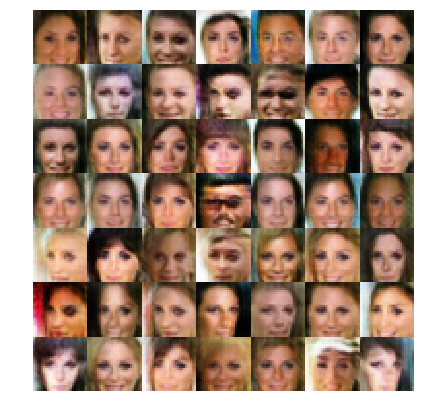

Epoch 3: Step 826... Discriminator Loss: 1.3309... Generator Loss: 0.7246
Epoch 3: Step 851... Discriminator Loss: 1.3373... Generator Loss: 0.5887
Epoch 3: Step 876... Discriminator Loss: 1.3824... Generator Loss: 0.8023
Epoch 3: Step 901... Discriminator Loss: 1.3099... Generator Loss: 0.8458


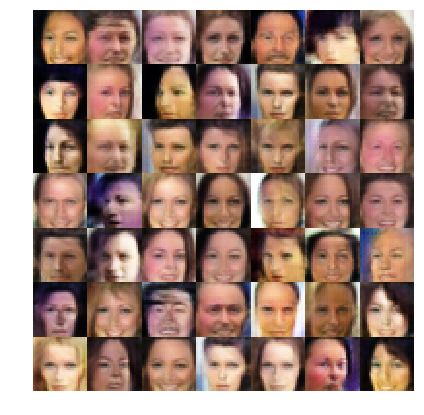

Epoch 3: Step 926... Discriminator Loss: 1.3962... Generator Loss: 0.8385
Epoch 3: Step 951... Discriminator Loss: 1.4228... Generator Loss: 0.7261
Epoch 3: Step 976... Discriminator Loss: 1.3577... Generator Loss: 0.7359
Epoch 3: Step 1001... Discriminator Loss: 1.3316... Generator Loss: 0.8444


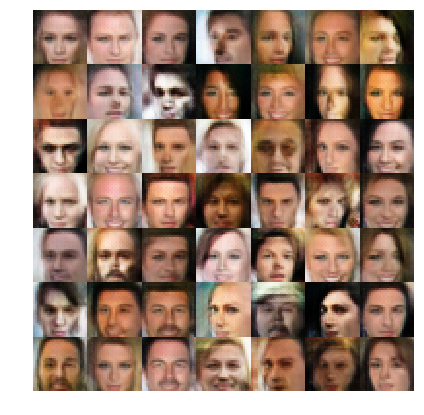

Epoch 3: Step 1026... Discriminator Loss: 1.3965... Generator Loss: 0.9105
Epoch 3: Step 1051... Discriminator Loss: 1.3898... Generator Loss: 0.7236
Epoch 3: Step 1076... Discriminator Loss: 1.3083... Generator Loss: 0.8547
Epoch 3: Step 1101... Discriminator Loss: 1.3285... Generator Loss: 0.8313


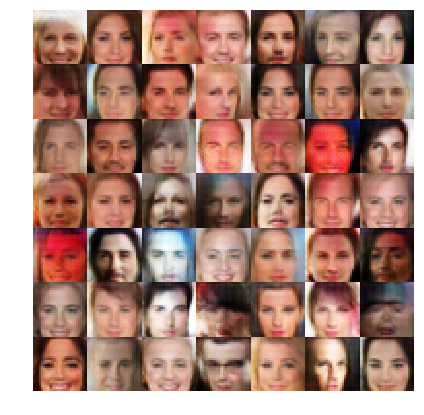

Epoch 3: Step 1126... Discriminator Loss: 1.2918... Generator Loss: 0.7940
Epoch 3: Step 1151... Discriminator Loss: 1.3299... Generator Loss: 0.8221
Epoch 3: Step 1176... Discriminator Loss: 1.3320... Generator Loss: 0.8472
Epoch 3: Step 1201... Discriminator Loss: 1.3245... Generator Loss: 0.9213


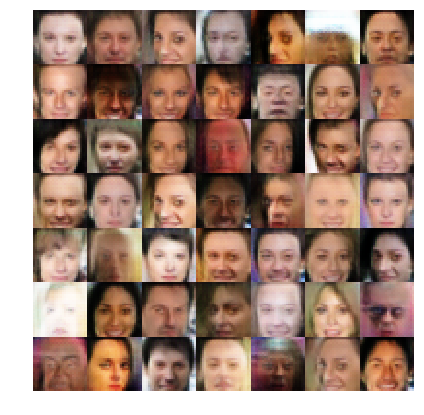

Epoch 3: Step 1226... Discriminator Loss: 1.3720... Generator Loss: 0.7895
Epoch 3: Step 1251... Discriminator Loss: 1.3359... Generator Loss: 0.8160
Epoch 3: Step 1276... Discriminator Loss: 1.3316... Generator Loss: 0.7706
Epoch 3: Step 1301... Discriminator Loss: 1.3599... Generator Loss: 0.7674


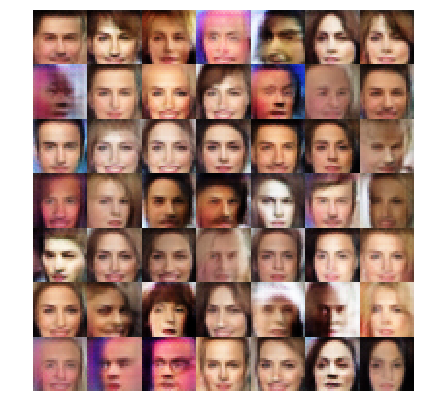

Epoch 3: Step 1326... Discriminator Loss: 1.2980... Generator Loss: 0.8100
Epoch 3: Step 1351... Discriminator Loss: 1.3604... Generator Loss: 0.8132
Epoch 3: Step 1376... Discriminator Loss: 1.3354... Generator Loss: 0.8801
Epoch 3: Step 1401... Discriminator Loss: 1.3948... Generator Loss: 0.9577


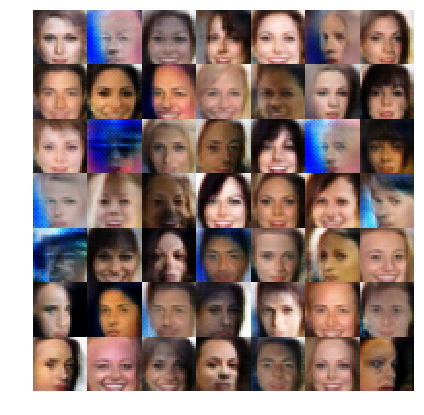

Epoch 3: Step 1426... Discriminator Loss: 1.3587... Generator Loss: 0.9020
Epoch 3: Step 1451... Discriminator Loss: 1.3349... Generator Loss: 0.7703
Epoch 3: Step 1476... Discriminator Loss: 1.2846... Generator Loss: 0.7037
Epoch 3: Step 1501... Discriminator Loss: 1.3500... Generator Loss: 0.8340


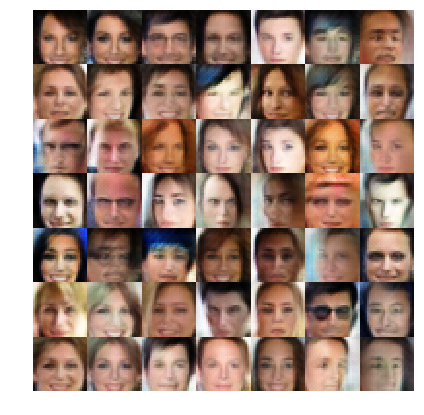

Epoch 3: Step 1526... Discriminator Loss: 1.3304... Generator Loss: 0.9283
Epoch 3: Step 1551... Discriminator Loss: 1.3635... Generator Loss: 0.8166
Epoch 3: Step 1576... Discriminator Loss: 1.3743... Generator Loss: 0.9612
Epoch 3: Step 1601... Discriminator Loss: 1.2766... Generator Loss: 0.8618


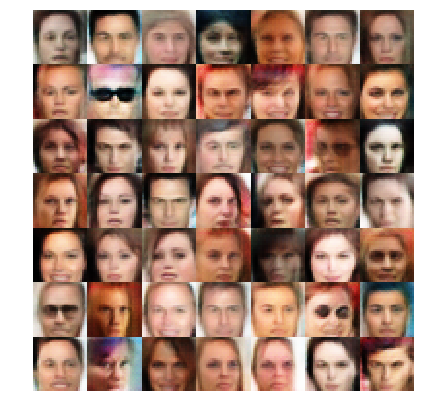

Epoch 3: Step 1626... Discriminator Loss: 1.3703... Generator Loss: 0.8386
Epoch 3: Step 1651... Discriminator Loss: 1.3757... Generator Loss: 0.8190
Epoch 3: Step 1676... Discriminator Loss: 1.3450... Generator Loss: 0.8209
Epoch 3: Step 1701... Discriminator Loss: 1.3350... Generator Loss: 0.8751


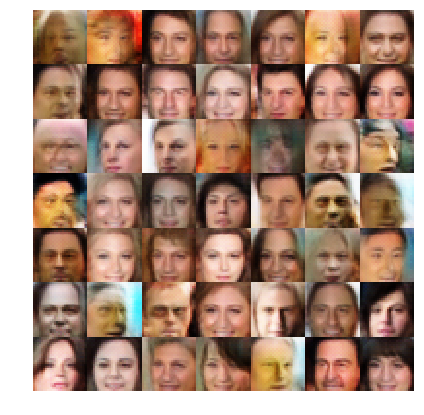

Epoch 3: Step 1726... Discriminator Loss: 1.3564... Generator Loss: 0.9067
Epoch 3: Step 1751... Discriminator Loss: 1.4452... Generator Loss: 0.6995
Epoch 3: Step 1776... Discriminator Loss: 1.3097... Generator Loss: 0.7778
Epoch 3: Step 1801... Discriminator Loss: 1.3752... Generator Loss: 0.8952


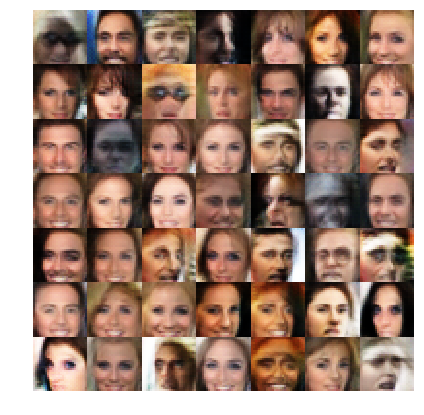

Epoch 3: Step 1826... Discriminator Loss: 1.2935... Generator Loss: 0.8201
Epoch 3: Step 1851... Discriminator Loss: 1.3249... Generator Loss: 0.7087
Epoch 3: Step 1876... Discriminator Loss: 1.3020... Generator Loss: 0.8044
Epoch 3: Step 1901... Discriminator Loss: 1.3512... Generator Loss: 0.7902


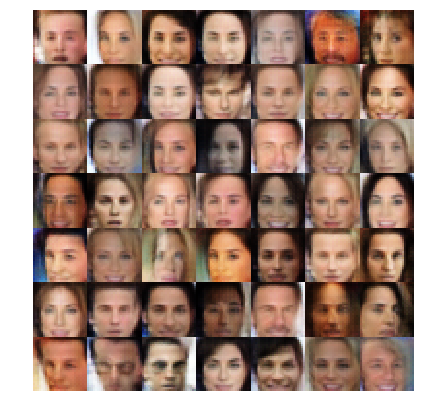

Epoch 3: Step 1926... Discriminator Loss: 1.3167... Generator Loss: 0.9011
Epoch 3: Step 1951... Discriminator Loss: 1.2904... Generator Loss: 0.8427
Epoch 3: Step 1976... Discriminator Loss: 1.3717... Generator Loss: 0.8457
Epoch 3: Step 2001... Discriminator Loss: 1.3278... Generator Loss: 0.8390


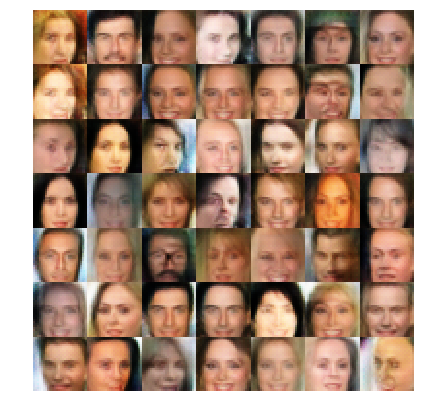

Epoch 3: Step 2026... Discriminator Loss: 1.2967... Generator Loss: 0.7863
Epoch 3: Step 2051... Discriminator Loss: 1.3805... Generator Loss: 1.0166
Epoch 3: Step 2076... Discriminator Loss: 1.3115... Generator Loss: 0.7913
Epoch 3: Step 2101... Discriminator Loss: 1.2409... Generator Loss: 0.8291


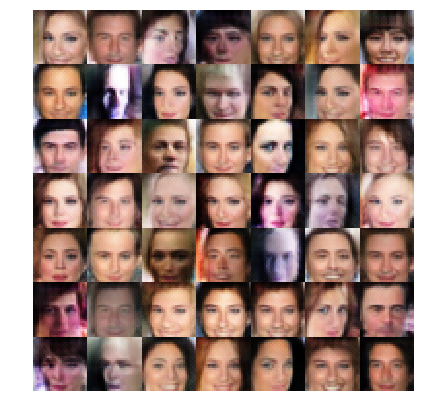

Epoch 3: Step 2126... Discriminator Loss: 1.3113... Generator Loss: 0.7904
Epoch 3: Step 2151... Discriminator Loss: 1.3257... Generator Loss: 0.7432
Epoch 3: Step 2176... Discriminator Loss: 1.4066... Generator Loss: 0.6138
Epoch 3: Step 2201... Discriminator Loss: 1.2892... Generator Loss: 0.8889


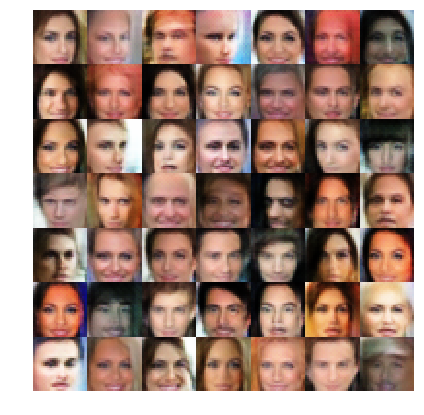

Epoch 3: Step 2226... Discriminator Loss: 1.2901... Generator Loss: 0.8646
Epoch 3: Step 2251... Discriminator Loss: 1.3568... Generator Loss: 0.7550
Epoch 3: Step 2276... Discriminator Loss: 1.3326... Generator Loss: 0.7986
Epoch 3: Step 2301... Discriminator Loss: 1.3047... Generator Loss: 0.8598


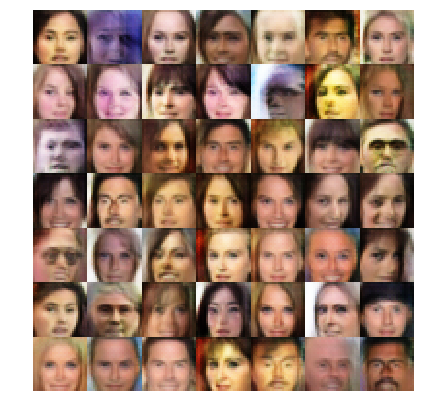

Epoch 3: Step 2326... Discriminator Loss: 1.2274... Generator Loss: 0.7590
Epoch 3: Step 2351... Discriminator Loss: 1.2568... Generator Loss: 0.8411
Epoch 3: Step 2376... Discriminator Loss: 1.3440... Generator Loss: 0.7034
Epoch 3: Step 2401... Discriminator Loss: 1.3447... Generator Loss: 0.6789


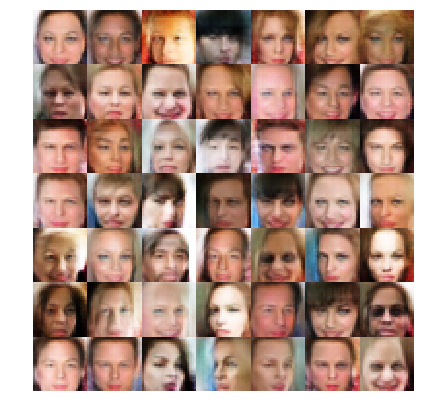

Epoch 3: Step 2426... Discriminator Loss: 1.2849... Generator Loss: 0.8549
Epoch 3: Step 2451... Discriminator Loss: 1.3118... Generator Loss: 0.9687
Epoch 3: Step 2476... Discriminator Loss: 1.3104... Generator Loss: 0.8882
Epoch 3: Step 2501... Discriminator Loss: 1.2896... Generator Loss: 1.0051


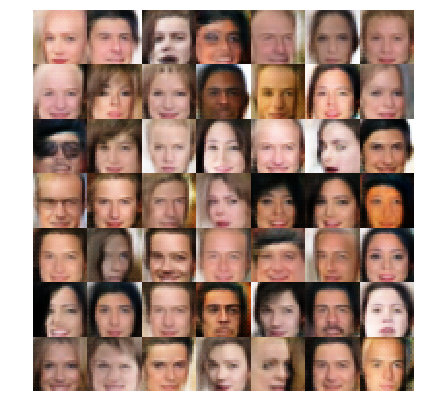

Epoch 3: Step 2526... Discriminator Loss: 1.2960... Generator Loss: 0.8065
Epoch 3: Step 2551... Discriminator Loss: 1.3203... Generator Loss: 0.7207
Epoch 3: Step 2576... Discriminator Loss: 1.3080... Generator Loss: 0.8668
Epoch 3: Step 2601... Discriminator Loss: 1.2480... Generator Loss: 0.9112


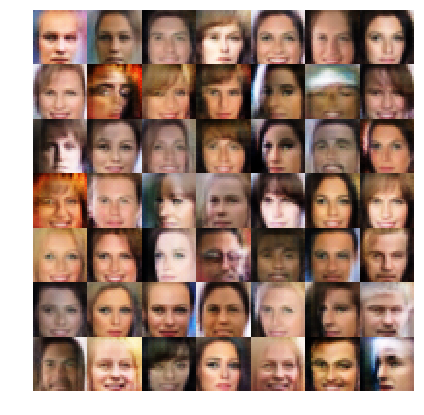

Epoch 3: Step 2626... Discriminator Loss: 1.3197... Generator Loss: 0.8331
Epoch 3: Step 2651... Discriminator Loss: 1.3090... Generator Loss: 1.0177
Epoch 3: Step 2676... Discriminator Loss: 1.2875... Generator Loss: 0.9269
Epoch 3: Step 2701... Discriminator Loss: 1.3398... Generator Loss: 1.0707


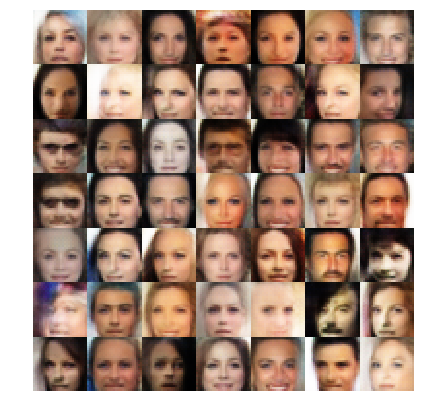

Epoch 3: Step 2726... Discriminator Loss: 1.2858... Generator Loss: 1.0007
Epoch 3: Step 2751... Discriminator Loss: 1.2986... Generator Loss: 0.7197
Epoch 3: Step 2776... Discriminator Loss: 1.3419... Generator Loss: 0.8362
Epoch 3: Step 2801... Discriminator Loss: 1.3505... Generator Loss: 0.7939


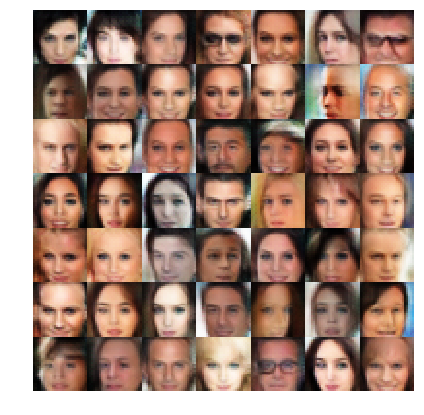

Epoch 3: Step 2826... Discriminator Loss: 1.2462... Generator Loss: 0.8852
Epoch 3: Step 2851... Discriminator Loss: 1.2997... Generator Loss: 0.9080
Epoch 3: Step 2876... Discriminator Loss: 1.3783... Generator Loss: 0.7847
Epoch 3: Step 2901... Discriminator Loss: 1.3084... Generator Loss: 0.8912


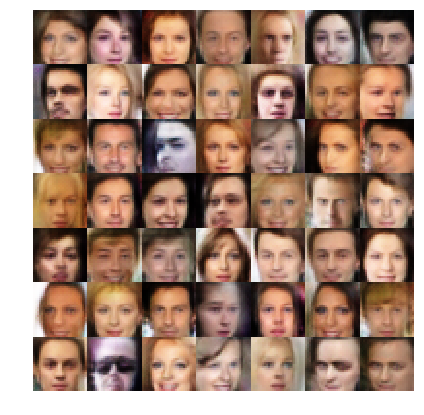

Epoch 3: Step 2926... Discriminator Loss: 1.2629... Generator Loss: 1.0451
Epoch 3: Step 2951... Discriminator Loss: 1.2929... Generator Loss: 0.6815
Epoch 3: Step 2976... Discriminator Loss: 1.2557... Generator Loss: 0.8187
Epoch 3: Step 3001... Discriminator Loss: 1.2162... Generator Loss: 0.8711


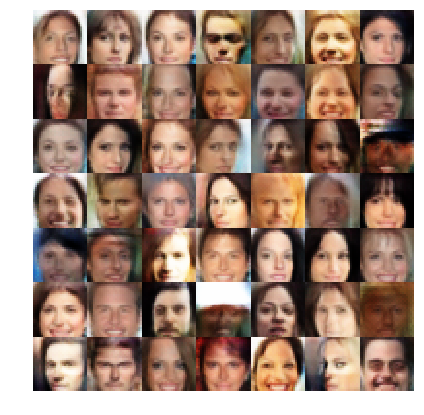

Epoch 3: Step 3026... Discriminator Loss: 1.1961... Generator Loss: 0.8663
Epoch 3: Step 3051... Discriminator Loss: 1.3066... Generator Loss: 0.8807
Epoch 3: Step 3076... Discriminator Loss: 1.3050... Generator Loss: 0.8477
Epoch 3: Step 3101... Discriminator Loss: 1.3050... Generator Loss: 0.7537


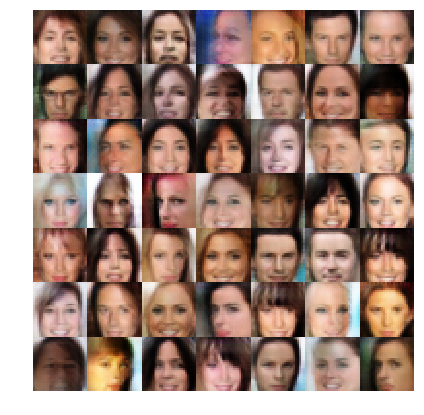

Epoch 3: Step 3126... Discriminator Loss: 1.2865... Generator Loss: 0.9099
Epoch 3: Step 3151... Discriminator Loss: 1.3100... Generator Loss: 0.6675
Epoch 4: Step 26... Discriminator Loss: 1.2031... Generator Loss: 0.9559
Epoch 4: Step 51... Discriminator Loss: 1.2501... Generator Loss: 1.1648
Epoch 4: Step 76... Discriminator Loss: 1.2591... Generator Loss: 0.8368
Epoch 4: Step 101... Discriminator Loss: 1.3334... Generator Loss: 0.7641


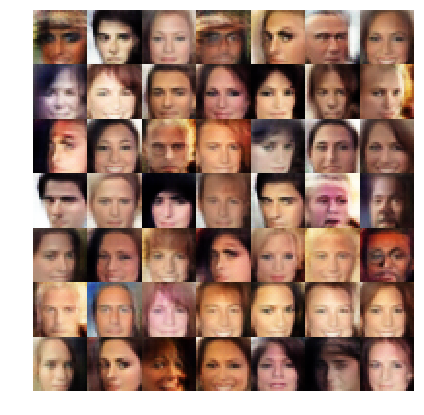

Epoch 4: Step 126... Discriminator Loss: 1.2865... Generator Loss: 0.8954
Epoch 4: Step 151... Discriminator Loss: 1.3537... Generator Loss: 1.1346
Epoch 4: Step 176... Discriminator Loss: 1.2450... Generator Loss: 0.7188
Epoch 4: Step 201... Discriminator Loss: 1.3427... Generator Loss: 0.9589


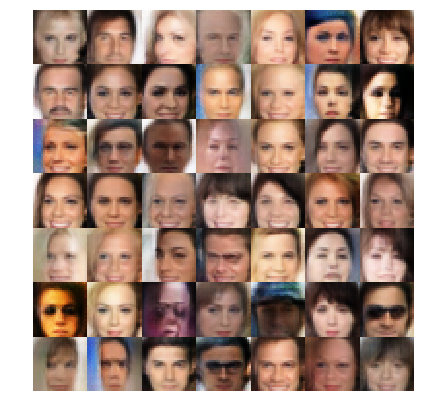

Epoch 4: Step 226... Discriminator Loss: 1.3066... Generator Loss: 0.8069
Epoch 4: Step 251... Discriminator Loss: 1.3105... Generator Loss: 0.9079
Epoch 4: Step 276... Discriminator Loss: 1.2299... Generator Loss: 0.9074
Epoch 4: Step 301... Discriminator Loss: 1.2022... Generator Loss: 0.9753


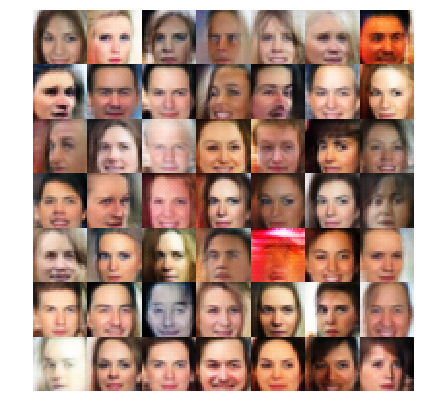

Epoch 4: Step 326... Discriminator Loss: 1.2754... Generator Loss: 1.1957
Epoch 4: Step 351... Discriminator Loss: 1.2327... Generator Loss: 0.9792
Epoch 4: Step 376... Discriminator Loss: 1.2432... Generator Loss: 0.6940
Epoch 4: Step 401... Discriminator Loss: 1.2685... Generator Loss: 1.0705


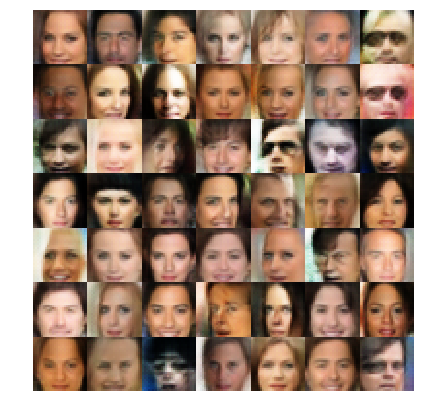

Epoch 4: Step 426... Discriminator Loss: 1.2695... Generator Loss: 0.8329
Epoch 4: Step 451... Discriminator Loss: 1.2282... Generator Loss: 0.9683
Epoch 4: Step 476... Discriminator Loss: 1.2441... Generator Loss: 1.0654
Epoch 4: Step 501... Discriminator Loss: 1.3733... Generator Loss: 0.7765


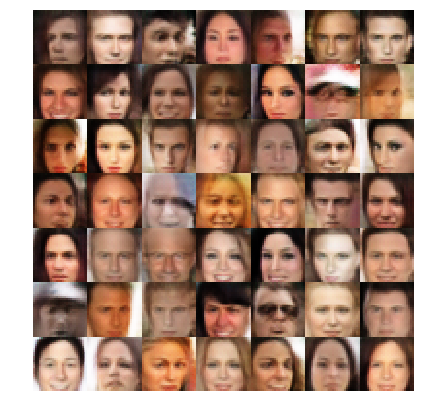

Epoch 4: Step 526... Discriminator Loss: 1.2137... Generator Loss: 0.9689
Epoch 4: Step 551... Discriminator Loss: 1.3685... Generator Loss: 0.6243
Epoch 4: Step 576... Discriminator Loss: 1.2017... Generator Loss: 0.8678
Epoch 4: Step 601... Discriminator Loss: 1.3195... Generator Loss: 0.9138


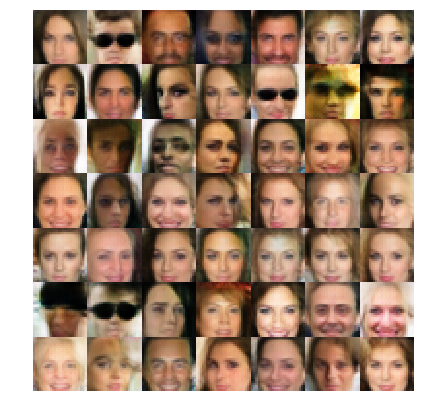

Epoch 4: Step 626... Discriminator Loss: 1.1662... Generator Loss: 0.7122
Epoch 4: Step 651... Discriminator Loss: 1.2279... Generator Loss: 0.8224
Epoch 4: Step 676... Discriminator Loss: 1.1534... Generator Loss: 0.9186
Epoch 4: Step 701... Discriminator Loss: 1.1901... Generator Loss: 1.0042


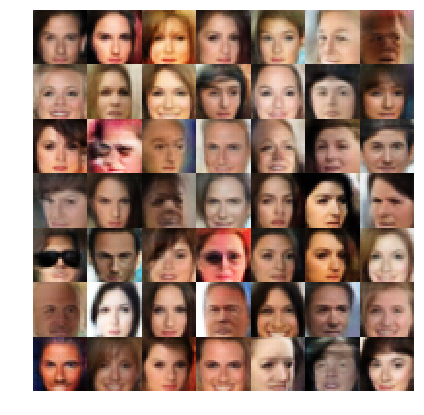

Epoch 4: Step 726... Discriminator Loss: 1.1994... Generator Loss: 0.8610
Epoch 4: Step 751... Discriminator Loss: 1.2733... Generator Loss: 0.8221
Epoch 4: Step 776... Discriminator Loss: 1.2684... Generator Loss: 0.7960
Epoch 4: Step 801... Discriminator Loss: 1.2730... Generator Loss: 0.8620


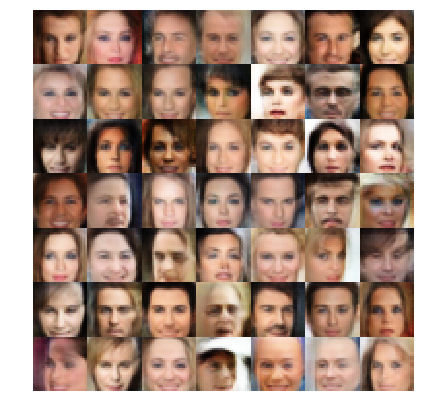

Epoch 4: Step 826... Discriminator Loss: 1.1692... Generator Loss: 0.7383
Epoch 4: Step 851... Discriminator Loss: 1.1265... Generator Loss: 0.9478
Epoch 4: Step 876... Discriminator Loss: 1.2875... Generator Loss: 0.9298
Epoch 4: Step 901... Discriminator Loss: 1.2603... Generator Loss: 0.9834


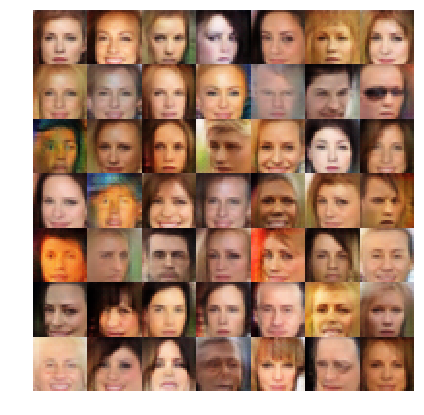

Epoch 4: Step 926... Discriminator Loss: 1.2897... Generator Loss: 0.7507
Epoch 4: Step 951... Discriminator Loss: 1.2537... Generator Loss: 1.3434
Epoch 4: Step 976... Discriminator Loss: 1.3758... Generator Loss: 0.6038
Epoch 4: Step 1001... Discriminator Loss: 1.2484... Generator Loss: 0.9111


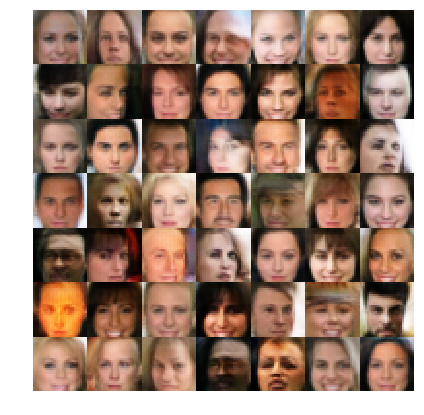

Epoch 4: Step 1026... Discriminator Loss: 1.2223... Generator Loss: 0.9634
Epoch 4: Step 1051... Discriminator Loss: 1.2636... Generator Loss: 1.4392
Epoch 4: Step 1076... Discriminator Loss: 1.1726... Generator Loss: 1.0294
Epoch 4: Step 1101... Discriminator Loss: 1.2556... Generator Loss: 0.9162


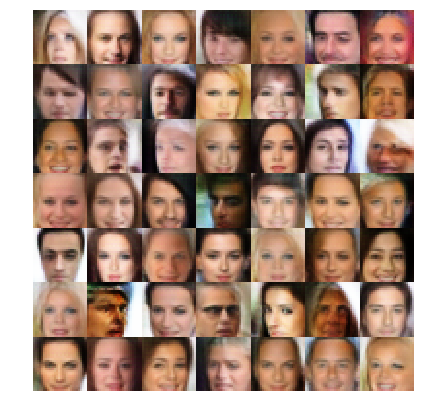

Epoch 4: Step 1126... Discriminator Loss: 1.3298... Generator Loss: 0.7320
Epoch 4: Step 1151... Discriminator Loss: 1.2427... Generator Loss: 1.1774
Epoch 4: Step 1176... Discriminator Loss: 1.3020... Generator Loss: 0.9678
Epoch 4: Step 1201... Discriminator Loss: 1.3273... Generator Loss: 1.1493


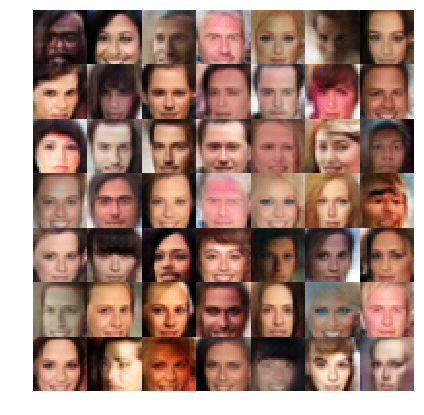

Epoch 4: Step 1226... Discriminator Loss: 1.1583... Generator Loss: 0.9967
Epoch 4: Step 1251... Discriminator Loss: 1.1553... Generator Loss: 1.0461
Epoch 4: Step 1276... Discriminator Loss: 1.2606... Generator Loss: 0.9400
Epoch 4: Step 1301... Discriminator Loss: 1.1257... Generator Loss: 1.1223


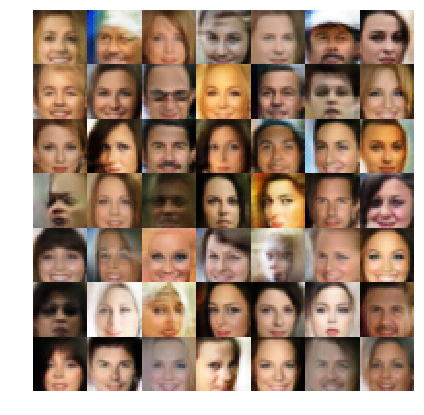

Epoch 4: Step 1326... Discriminator Loss: 1.2210... Generator Loss: 0.8974
Epoch 4: Step 1351... Discriminator Loss: 1.2231... Generator Loss: 0.8415
Epoch 4: Step 1376... Discriminator Loss: 1.1877... Generator Loss: 0.9615
Epoch 4: Step 1401... Discriminator Loss: 1.2471... Generator Loss: 1.0597


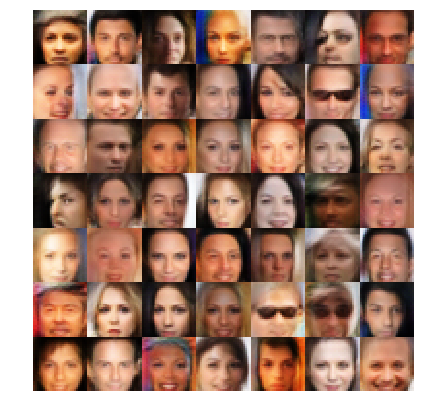

Epoch 4: Step 1426... Discriminator Loss: 1.2267... Generator Loss: 1.0438
Epoch 4: Step 1451... Discriminator Loss: 1.1657... Generator Loss: 0.6758
Epoch 4: Step 1476... Discriminator Loss: 1.2399... Generator Loss: 0.9186
Epoch 4: Step 1501... Discriminator Loss: 1.2002... Generator Loss: 0.9121


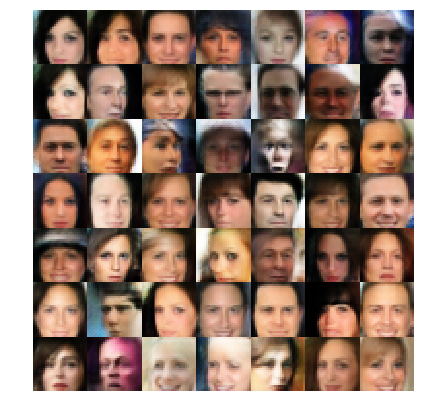

Epoch 4: Step 1526... Discriminator Loss: 1.1800... Generator Loss: 0.8046
Epoch 4: Step 1551... Discriminator Loss: 1.2724... Generator Loss: 1.0590
Epoch 4: Step 1576... Discriminator Loss: 1.2750... Generator Loss: 0.7728
Epoch 4: Step 1601... Discriminator Loss: 1.2495... Generator Loss: 1.3183


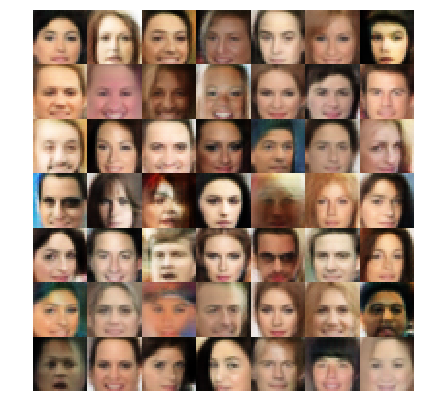

Epoch 4: Step 1626... Discriminator Loss: 1.2529... Generator Loss: 0.9720
Epoch 4: Step 1651... Discriminator Loss: 1.2348... Generator Loss: 0.9352
Epoch 4: Step 1676... Discriminator Loss: 1.2155... Generator Loss: 1.1783
Epoch 4: Step 1701... Discriminator Loss: 1.2280... Generator Loss: 0.7670


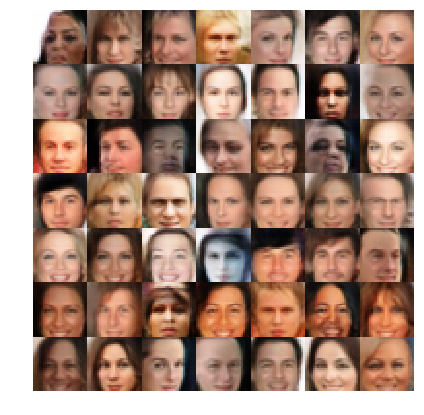

Epoch 4: Step 1726... Discriminator Loss: 1.2531... Generator Loss: 0.7260
Epoch 4: Step 1751... Discriminator Loss: 1.0221... Generator Loss: 1.0038
Epoch 4: Step 1776... Discriminator Loss: 1.1930... Generator Loss: 0.9919
Epoch 4: Step 1801... Discriminator Loss: 1.3318... Generator Loss: 1.1548


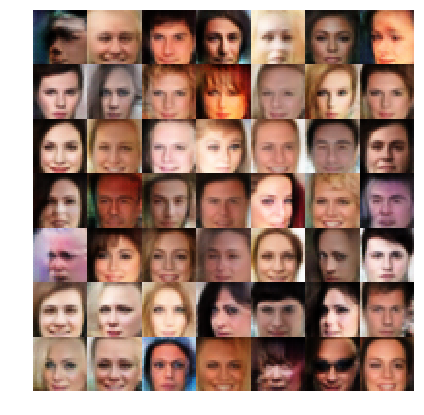

Epoch 4: Step 1826... Discriminator Loss: 1.1846... Generator Loss: 0.9277
Epoch 4: Step 1851... Discriminator Loss: 1.2488... Generator Loss: 0.8593
Epoch 4: Step 1876... Discriminator Loss: 1.3652... Generator Loss: 1.1518
Epoch 4: Step 1901... Discriminator Loss: 1.3001... Generator Loss: 1.1221


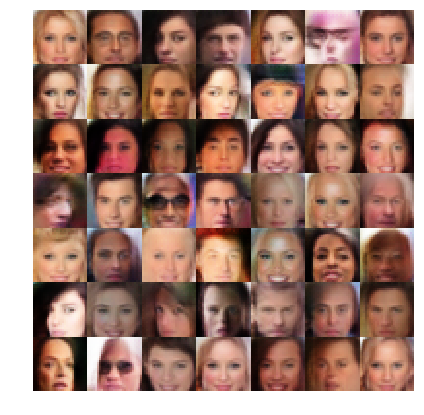

Epoch 4: Step 1926... Discriminator Loss: 1.3310... Generator Loss: 0.9363
Epoch 4: Step 1951... Discriminator Loss: 1.1672... Generator Loss: 0.8600
Epoch 4: Step 1976... Discriminator Loss: 1.2543... Generator Loss: 1.3876
Epoch 4: Step 2001... Discriminator Loss: 1.2950... Generator Loss: 0.9153


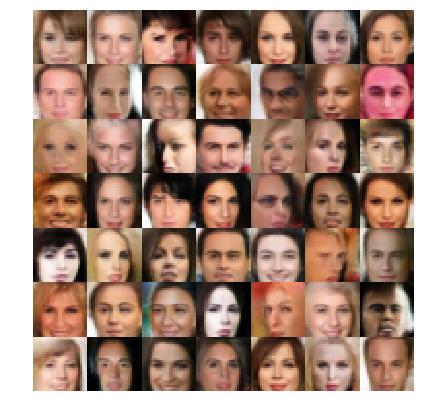

Epoch 4: Step 2026... Discriminator Loss: 1.3080... Generator Loss: 0.7804
Epoch 4: Step 2051... Discriminator Loss: 1.1662... Generator Loss: 1.2425
Epoch 4: Step 2076... Discriminator Loss: 1.1873... Generator Loss: 0.8138
Epoch 4: Step 2101... Discriminator Loss: 1.2253... Generator Loss: 1.1869


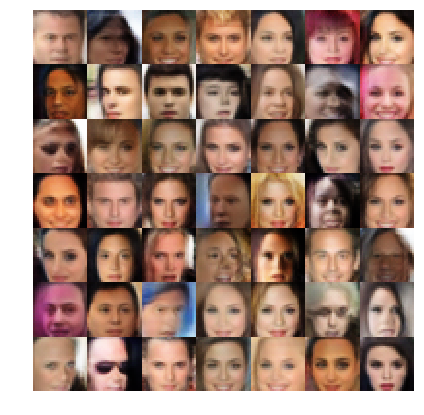

Epoch 4: Step 2126... Discriminator Loss: 1.0921... Generator Loss: 0.9819
Epoch 4: Step 2151... Discriminator Loss: 1.1478... Generator Loss: 0.9403
Epoch 4: Step 2176... Discriminator Loss: 1.0724... Generator Loss: 0.7453
Epoch 4: Step 2201... Discriminator Loss: 1.2297... Generator Loss: 1.2436


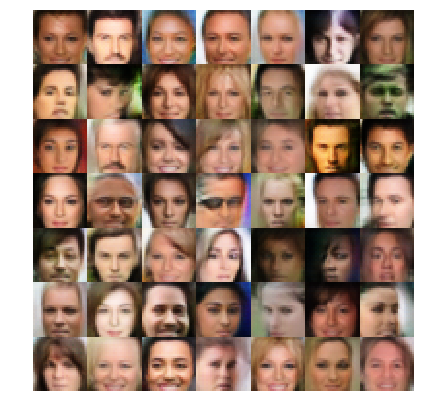

Epoch 4: Step 2226... Discriminator Loss: 1.2228... Generator Loss: 0.9248
Epoch 4: Step 2251... Discriminator Loss: 1.1388... Generator Loss: 0.9256
Epoch 4: Step 2276... Discriminator Loss: 1.2399... Generator Loss: 0.9631
Epoch 4: Step 2301... Discriminator Loss: 1.2816... Generator Loss: 0.6393


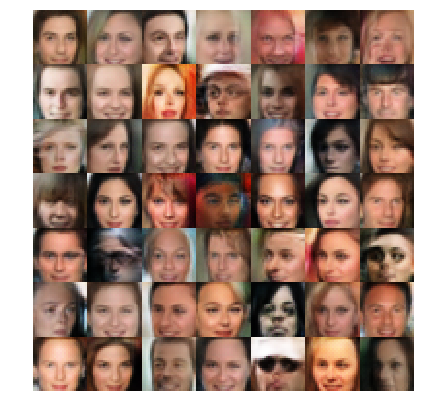

Epoch 4: Step 2326... Discriminator Loss: 1.1724... Generator Loss: 0.8252
Epoch 4: Step 2351... Discriminator Loss: 1.3619... Generator Loss: 0.9971
Epoch 4: Step 2376... Discriminator Loss: 1.2149... Generator Loss: 1.1035
Epoch 4: Step 2401... Discriminator Loss: 1.1529... Generator Loss: 0.8127


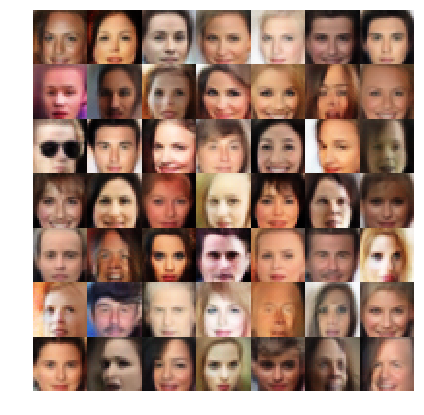

Epoch 4: Step 2426... Discriminator Loss: 1.1829... Generator Loss: 1.2951
Epoch 4: Step 2451... Discriminator Loss: 1.2759... Generator Loss: 1.5463
Epoch 4: Step 2476... Discriminator Loss: 1.1374... Generator Loss: 1.0150
Epoch 4: Step 2501... Discriminator Loss: 1.2164... Generator Loss: 1.5537


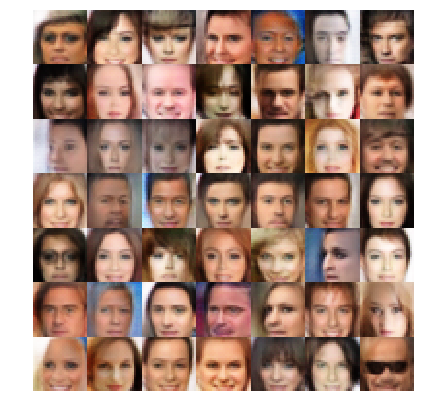

Epoch 4: Step 2526... Discriminator Loss: 1.0977... Generator Loss: 1.2240
Epoch 4: Step 2551... Discriminator Loss: 1.1758... Generator Loss: 1.0519
Epoch 4: Step 2576... Discriminator Loss: 1.0732... Generator Loss: 1.0546
Epoch 4: Step 2601... Discriminator Loss: 1.1546... Generator Loss: 1.1551


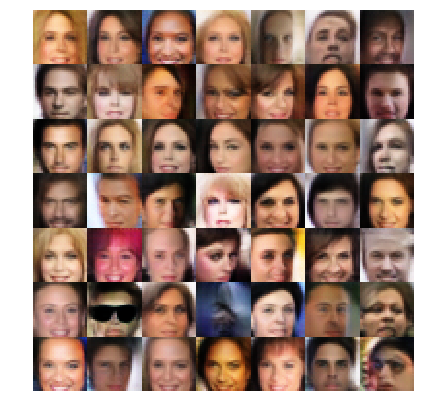

Epoch 4: Step 2626... Discriminator Loss: 1.2326... Generator Loss: 1.0905
Epoch 4: Step 2651... Discriminator Loss: 1.2885... Generator Loss: 1.4090
Epoch 4: Step 2676... Discriminator Loss: 1.1834... Generator Loss: 1.3790
Epoch 4: Step 2701... Discriminator Loss: 1.1705... Generator Loss: 1.0408


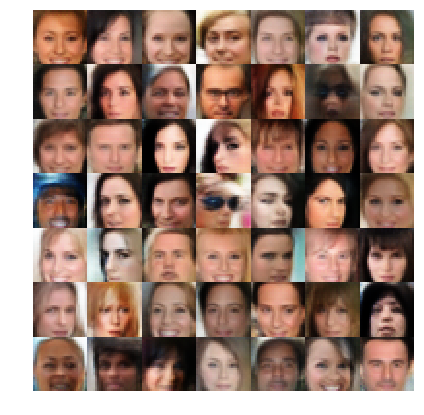

Epoch 4: Step 2726... Discriminator Loss: 1.2474... Generator Loss: 0.9475
Epoch 4: Step 2751... Discriminator Loss: 1.2253... Generator Loss: 1.3813
Epoch 4: Step 2776... Discriminator Loss: 1.1766... Generator Loss: 1.1200
Epoch 4: Step 2801... Discriminator Loss: 1.1349... Generator Loss: 1.5246


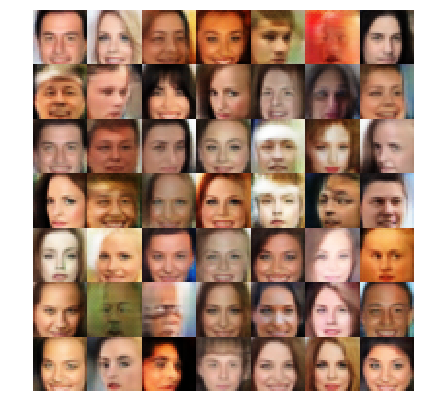

Epoch 4: Step 2826... Discriminator Loss: 1.0934... Generator Loss: 1.0960
Epoch 4: Step 2851... Discriminator Loss: 1.1387... Generator Loss: 1.1252
Epoch 4: Step 2876... Discriminator Loss: 1.1902... Generator Loss: 0.8287
Epoch 4: Step 2901... Discriminator Loss: 1.2761... Generator Loss: 1.3913


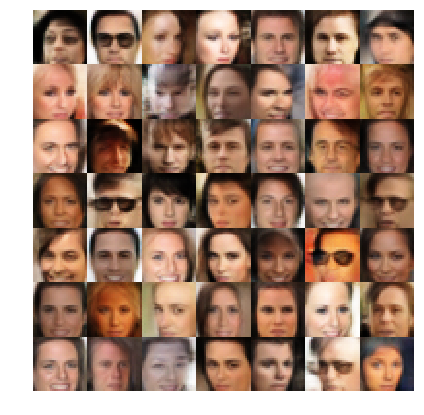

Epoch 4: Step 2926... Discriminator Loss: 1.2265... Generator Loss: 0.9868
Epoch 4: Step 2951... Discriminator Loss: 1.2503... Generator Loss: 0.7426
Epoch 4: Step 2976... Discriminator Loss: 1.1657... Generator Loss: 1.2188
Epoch 4: Step 3001... Discriminator Loss: 1.1669... Generator Loss: 0.9116


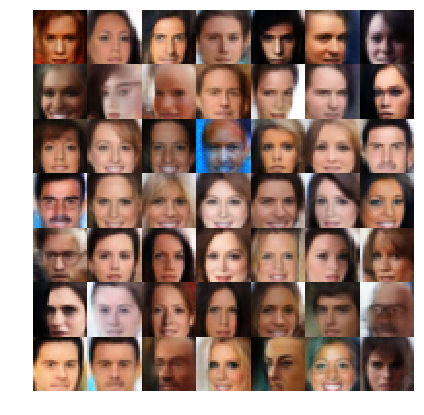

Epoch 4: Step 3026... Discriminator Loss: 1.1669... Generator Loss: 0.9311
Epoch 4: Step 3051... Discriminator Loss: 1.1223... Generator Loss: 1.3858
Epoch 4: Step 3076... Discriminator Loss: 1.0630... Generator Loss: 0.9013
Epoch 4: Step 3101... Discriminator Loss: 1.0993... Generator Loss: 1.2384


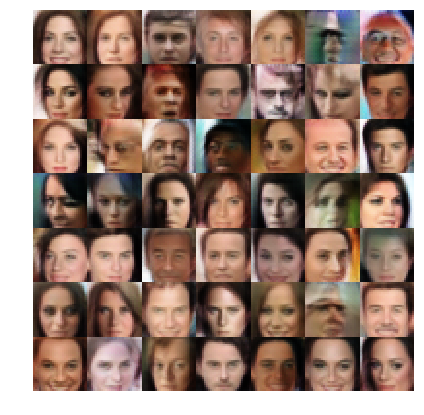

Epoch 4: Step 3126... Discriminator Loss: 1.1189... Generator Loss: 1.2896
Epoch 4: Step 3151... Discriminator Loss: 1.2054... Generator Loss: 0.6716
Epoch 5: Step 26... Discriminator Loss: 1.2474... Generator Loss: 0.8171
Epoch 5: Step 51... Discriminator Loss: 1.1163... Generator Loss: 0.7951
Epoch 5: Step 76... Discriminator Loss: 1.2705... Generator Loss: 0.7802
Epoch 5: Step 101... Discriminator Loss: 1.2085... Generator Loss: 0.8112


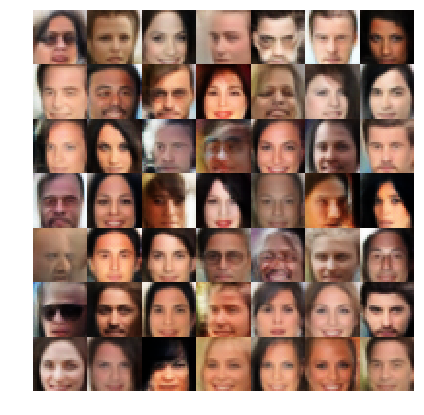

Epoch 5: Step 126... Discriminator Loss: 1.0954... Generator Loss: 1.0664
Epoch 5: Step 151... Discriminator Loss: 1.2645... Generator Loss: 1.1114
Epoch 5: Step 176... Discriminator Loss: 1.1010... Generator Loss: 0.8910
Epoch 5: Step 201... Discriminator Loss: 1.1495... Generator Loss: 1.2846


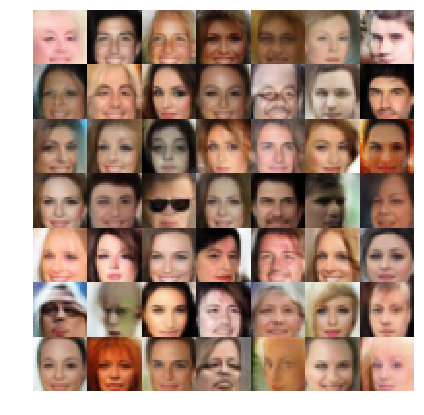

Epoch 5: Step 226... Discriminator Loss: 1.0185... Generator Loss: 1.4826
Epoch 5: Step 251... Discriminator Loss: 1.1411... Generator Loss: 0.9294
Epoch 5: Step 276... Discriminator Loss: 1.0744... Generator Loss: 1.3938
Epoch 5: Step 301... Discriminator Loss: 1.0260... Generator Loss: 1.0750


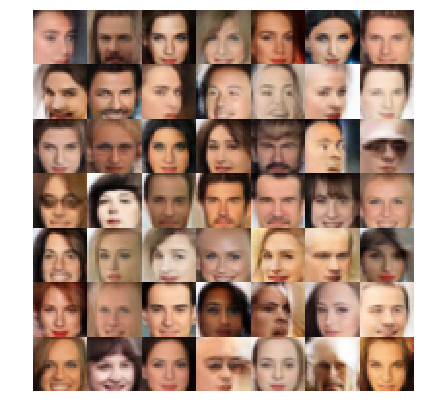

Epoch 5: Step 326... Discriminator Loss: 1.1511... Generator Loss: 0.8574
Epoch 5: Step 351... Discriminator Loss: 1.0940... Generator Loss: 1.5226
Epoch 5: Step 376... Discriminator Loss: 1.1683... Generator Loss: 1.1636
Epoch 5: Step 401... Discriminator Loss: 1.1918... Generator Loss: 0.9857


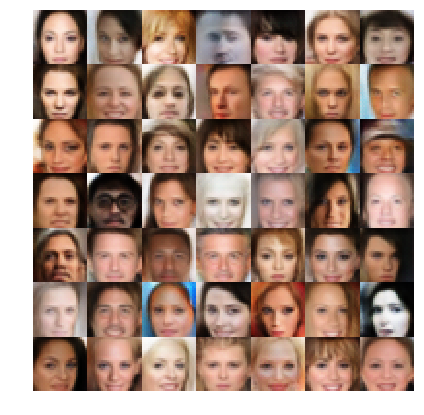

Epoch 5: Step 426... Discriminator Loss: 1.1916... Generator Loss: 0.9670
Epoch 5: Step 451... Discriminator Loss: 1.3087... Generator Loss: 0.7791
Epoch 5: Step 476... Discriminator Loss: 1.2108... Generator Loss: 0.7750
Epoch 5: Step 501... Discriminator Loss: 1.1648... Generator Loss: 1.0339


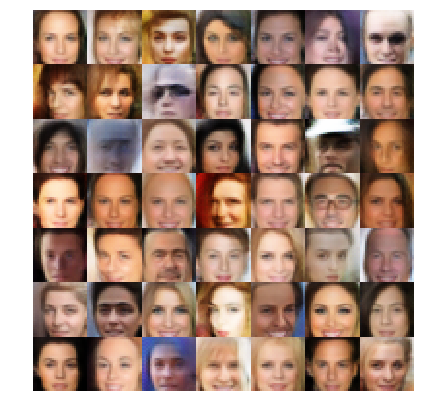

Epoch 5: Step 526... Discriminator Loss: 1.1528... Generator Loss: 1.2814
Epoch 5: Step 551... Discriminator Loss: 1.3913... Generator Loss: 0.6220
Epoch 5: Step 576... Discriminator Loss: 1.0243... Generator Loss: 1.2096
Epoch 5: Step 601... Discriminator Loss: 1.1070... Generator Loss: 1.1755


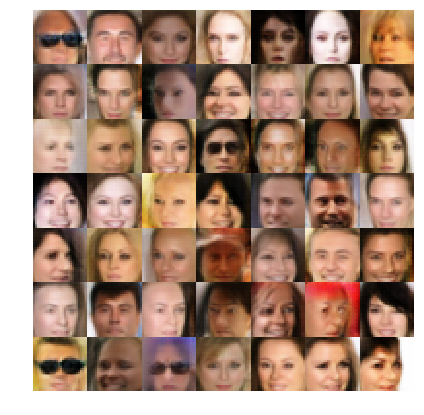

Epoch 5: Step 626... Discriminator Loss: 1.1558... Generator Loss: 0.8424
Epoch 5: Step 651... Discriminator Loss: 1.2484... Generator Loss: 0.8937
Epoch 5: Step 676... Discriminator Loss: 1.1576... Generator Loss: 0.9753
Epoch 5: Step 701... Discriminator Loss: 1.0644... Generator Loss: 1.3710


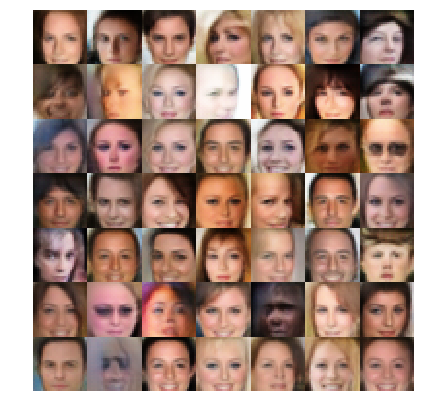

Epoch 5: Step 726... Discriminator Loss: 1.1067... Generator Loss: 1.4069
Epoch 5: Step 751... Discriminator Loss: 1.0058... Generator Loss: 1.4663
Epoch 5: Step 776... Discriminator Loss: 1.4465... Generator Loss: 0.5355
Epoch 5: Step 801... Discriminator Loss: 1.2562... Generator Loss: 0.9935


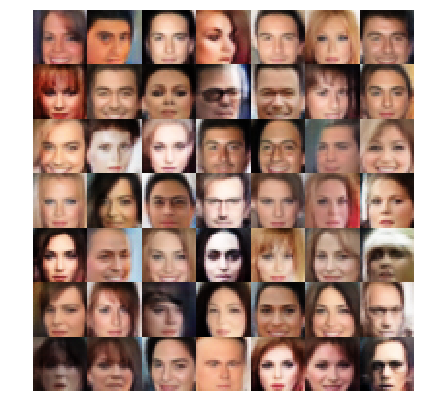

Epoch 5: Step 826... Discriminator Loss: 1.2992... Generator Loss: 1.4445
Epoch 5: Step 851... Discriminator Loss: 1.2163... Generator Loss: 0.8373
Epoch 5: Step 876... Discriminator Loss: 1.1325... Generator Loss: 1.3508
Epoch 5: Step 901... Discriminator Loss: 1.3958... Generator Loss: 0.6292


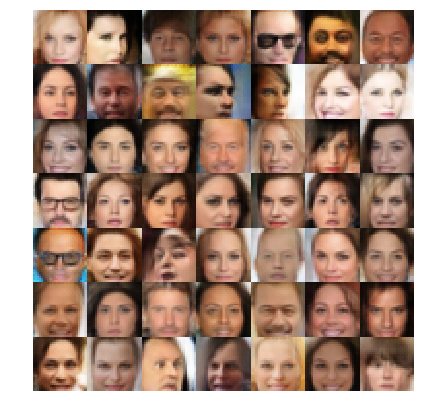

Epoch 5: Step 926... Discriminator Loss: 1.3402... Generator Loss: 0.8065
Epoch 5: Step 951... Discriminator Loss: 1.2694... Generator Loss: 1.0823
Epoch 5: Step 976... Discriminator Loss: 1.2196... Generator Loss: 0.8288
Epoch 5: Step 1001... Discriminator Loss: 1.1094... Generator Loss: 1.1313


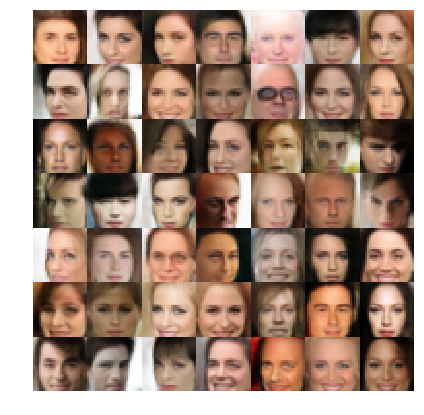

Epoch 5: Step 1026... Discriminator Loss: 1.1886... Generator Loss: 1.3185
Epoch 5: Step 1051... Discriminator Loss: 1.1736... Generator Loss: 1.4272
Epoch 5: Step 1076... Discriminator Loss: 1.1917... Generator Loss: 0.9452
Epoch 5: Step 1101... Discriminator Loss: 1.0946... Generator Loss: 1.0953


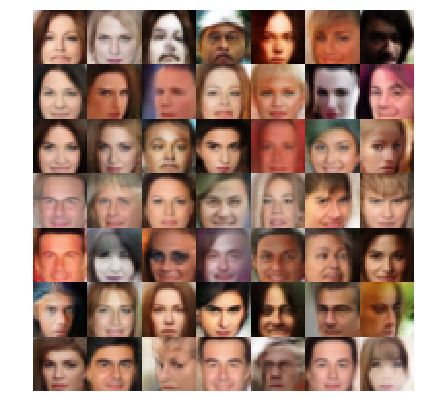

Epoch 5: Step 1126... Discriminator Loss: 1.2014... Generator Loss: 1.1244
Epoch 5: Step 1151... Discriminator Loss: 1.2391... Generator Loss: 0.9252
Epoch 5: Step 1176... Discriminator Loss: 1.2245... Generator Loss: 0.9054
Epoch 5: Step 1201... Discriminator Loss: 1.2098... Generator Loss: 1.0303


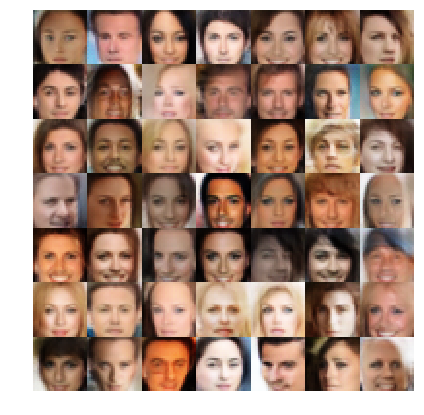

Epoch 5: Step 1226... Discriminator Loss: 1.2770... Generator Loss: 0.8781
Epoch 5: Step 1251... Discriminator Loss: 1.2137... Generator Loss: 0.9362
Epoch 5: Step 1276... Discriminator Loss: 1.1002... Generator Loss: 1.0473
Epoch 5: Step 1301... Discriminator Loss: 1.0891... Generator Loss: 1.1020


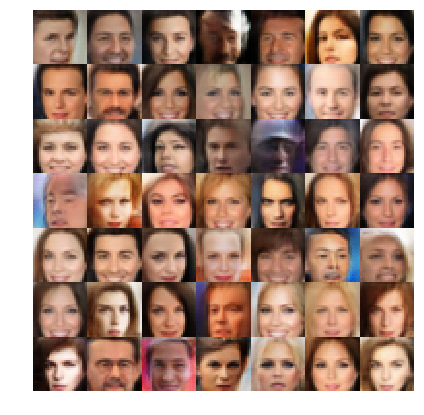

Epoch 5: Step 1326... Discriminator Loss: 1.0212... Generator Loss: 1.0264
Epoch 5: Step 1351... Discriminator Loss: 1.0466... Generator Loss: 1.1909
Epoch 5: Step 1376... Discriminator Loss: 1.0986... Generator Loss: 0.8538
Epoch 5: Step 1401... Discriminator Loss: 1.1580... Generator Loss: 1.3190


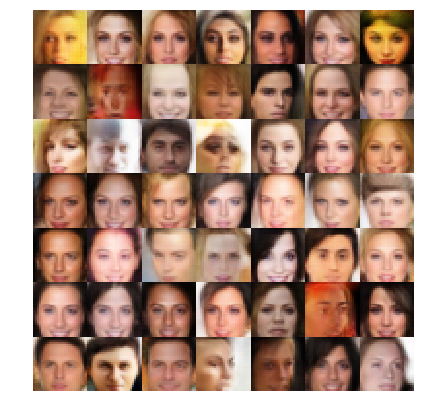

Epoch 5: Step 1426... Discriminator Loss: 1.1666... Generator Loss: 0.7864
Epoch 5: Step 1451... Discriminator Loss: 1.2185... Generator Loss: 0.8501
Epoch 5: Step 1476... Discriminator Loss: 1.0589... Generator Loss: 1.0002
Epoch 5: Step 1501... Discriminator Loss: 1.1390... Generator Loss: 0.8597


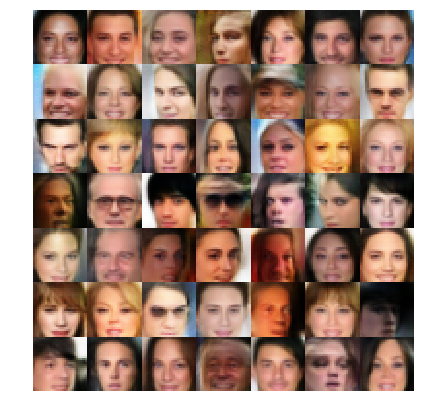

Epoch 5: Step 1526... Discriminator Loss: 1.1611... Generator Loss: 1.2803
Epoch 5: Step 1551... Discriminator Loss: 1.1984... Generator Loss: 1.2342
Epoch 5: Step 1576... Discriminator Loss: 1.0172... Generator Loss: 1.1902
Epoch 5: Step 1601... Discriminator Loss: 1.0975... Generator Loss: 1.7136


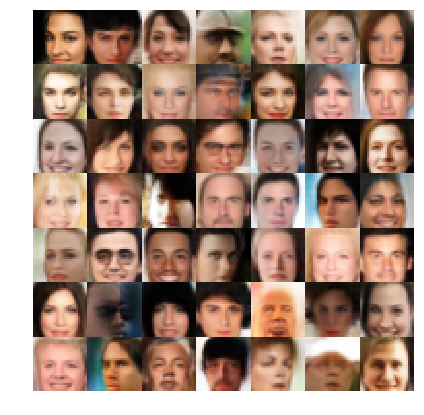

Epoch 5: Step 1626... Discriminator Loss: 1.1115... Generator Loss: 1.0690
Epoch 5: Step 1651... Discriminator Loss: 1.0763... Generator Loss: 1.2360
Epoch 5: Step 1676... Discriminator Loss: 1.0795... Generator Loss: 1.5114
Epoch 5: Step 1701... Discriminator Loss: 1.2954... Generator Loss: 1.2574


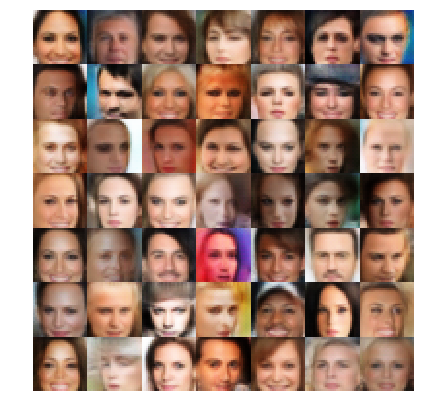

Epoch 5: Step 1726... Discriminator Loss: 1.1379... Generator Loss: 1.2212
Epoch 5: Step 1751... Discriminator Loss: 1.1808... Generator Loss: 1.4906
Epoch 5: Step 1776... Discriminator Loss: 0.9591... Generator Loss: 1.8432
Epoch 5: Step 1801... Discriminator Loss: 1.1865... Generator Loss: 0.8600


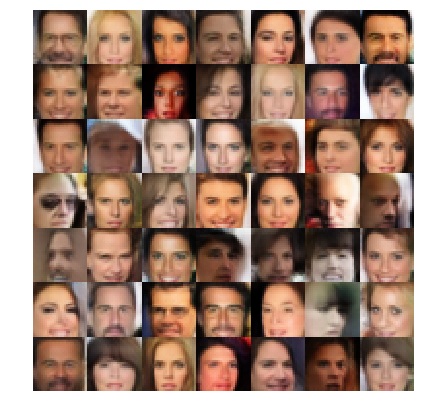

Epoch 5: Step 1826... Discriminator Loss: 1.0642... Generator Loss: 1.0884
Epoch 5: Step 1851... Discriminator Loss: 1.2462... Generator Loss: 1.2354
Epoch 5: Step 1876... Discriminator Loss: 1.1850... Generator Loss: 1.1795
Epoch 5: Step 1901... Discriminator Loss: 1.1443... Generator Loss: 1.4597


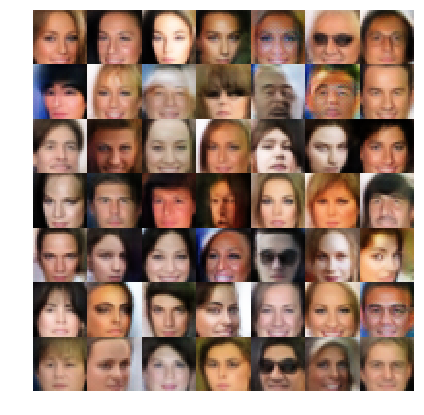

Epoch 5: Step 1926... Discriminator Loss: 1.0663... Generator Loss: 1.2717
Epoch 5: Step 1951... Discriminator Loss: 1.0705... Generator Loss: 1.1654
Epoch 5: Step 1976... Discriminator Loss: 1.1375... Generator Loss: 0.8045
Epoch 5: Step 2001... Discriminator Loss: 1.1142... Generator Loss: 1.1903


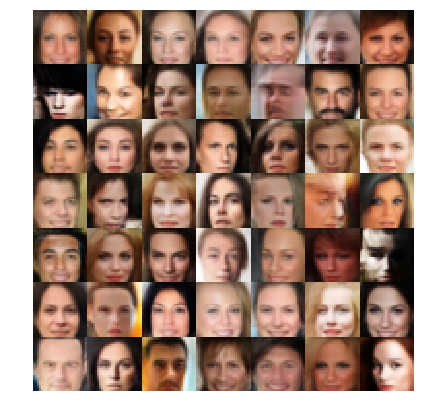

Epoch 5: Step 2026... Discriminator Loss: 0.9374... Generator Loss: 1.2186
Epoch 5: Step 2051... Discriminator Loss: 1.0828... Generator Loss: 1.6457
Epoch 5: Step 2076... Discriminator Loss: 0.9707... Generator Loss: 1.1808
Epoch 5: Step 2101... Discriminator Loss: 0.8510... Generator Loss: 1.6819


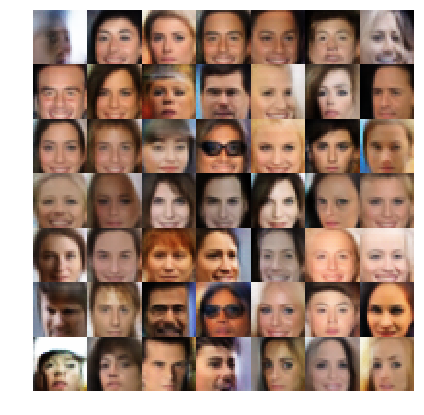

Epoch 5: Step 2126... Discriminator Loss: 0.9795... Generator Loss: 1.4997
Epoch 5: Step 2151... Discriminator Loss: 1.2343... Generator Loss: 1.0512
Epoch 5: Step 2176... Discriminator Loss: 1.1007... Generator Loss: 0.9890
Epoch 5: Step 2201... Discriminator Loss: 1.1165... Generator Loss: 0.8572


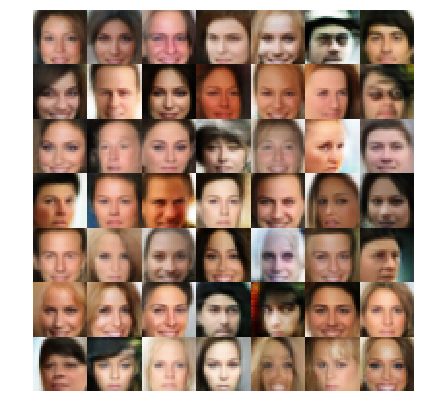

Epoch 5: Step 2226... Discriminator Loss: 1.1866... Generator Loss: 1.4652
Epoch 5: Step 2251... Discriminator Loss: 1.0262... Generator Loss: 1.1079
Epoch 5: Step 2276... Discriminator Loss: 1.1197... Generator Loss: 1.1392
Epoch 5: Step 2301... Discriminator Loss: 1.1224... Generator Loss: 1.0082


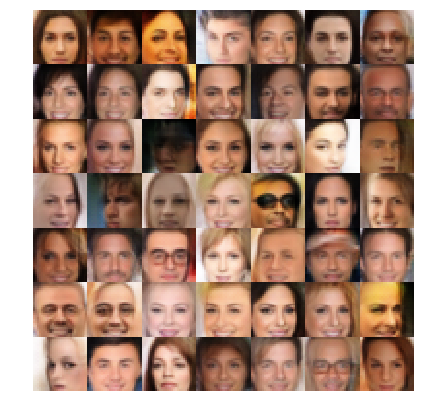

Epoch 5: Step 2326... Discriminator Loss: 1.2038... Generator Loss: 0.7875
Epoch 5: Step 2351... Discriminator Loss: 1.0849... Generator Loss: 1.0667
Epoch 5: Step 2376... Discriminator Loss: 1.2510... Generator Loss: 0.9012
Epoch 5: Step 2401... Discriminator Loss: 0.9680... Generator Loss: 1.0994


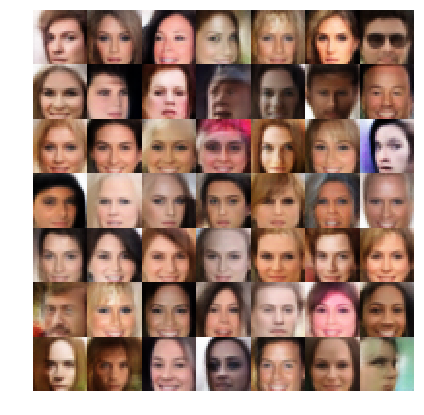

Epoch 5: Step 2426... Discriminator Loss: 1.1718... Generator Loss: 1.6700
Epoch 5: Step 2451... Discriminator Loss: 1.0182... Generator Loss: 1.1869
Epoch 5: Step 2476... Discriminator Loss: 1.0854... Generator Loss: 0.8470
Epoch 5: Step 2501... Discriminator Loss: 1.2305... Generator Loss: 0.9423


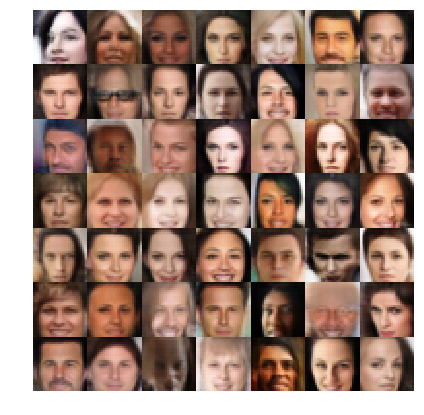

Epoch 5: Step 2526... Discriminator Loss: 1.1656... Generator Loss: 1.2679
Epoch 5: Step 2551... Discriminator Loss: 1.1229... Generator Loss: 1.2609
Epoch 5: Step 2576... Discriminator Loss: 1.2069... Generator Loss: 0.8520
Epoch 5: Step 2601... Discriminator Loss: 1.1024... Generator Loss: 1.4043


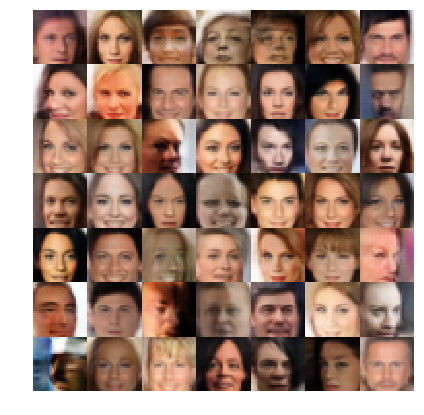

Epoch 5: Step 2626... Discriminator Loss: 1.1039... Generator Loss: 1.4678
Epoch 5: Step 2651... Discriminator Loss: 1.1659... Generator Loss: 1.1462
Epoch 5: Step 2676... Discriminator Loss: 1.0801... Generator Loss: 1.5682
Epoch 5: Step 2701... Discriminator Loss: 1.2016... Generator Loss: 0.9436


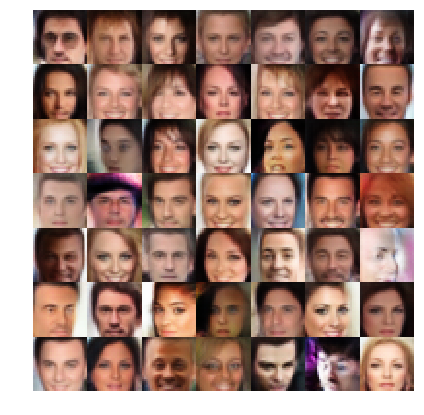

Epoch 5: Step 2726... Discriminator Loss: 1.1586... Generator Loss: 1.2561
Epoch 5: Step 2751... Discriminator Loss: 1.0304... Generator Loss: 1.2530
Epoch 5: Step 2776... Discriminator Loss: 1.0527... Generator Loss: 1.4913
Epoch 5: Step 2801... Discriminator Loss: 1.0295... Generator Loss: 1.1992


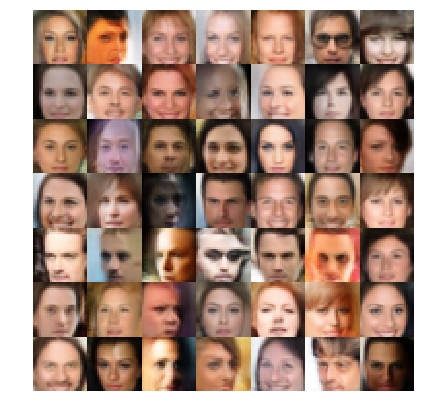

Epoch 5: Step 2826... Discriminator Loss: 1.1310... Generator Loss: 1.0549
Epoch 5: Step 2851... Discriminator Loss: 1.0997... Generator Loss: 1.4669
Epoch 5: Step 2876... Discriminator Loss: 1.2899... Generator Loss: 0.7969
Epoch 5: Step 2901... Discriminator Loss: 1.0840... Generator Loss: 1.2801


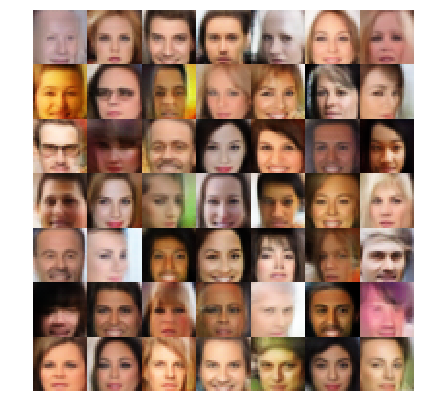

Epoch 5: Step 2926... Discriminator Loss: 1.0086... Generator Loss: 1.6545
Epoch 5: Step 2951... Discriminator Loss: 0.9466... Generator Loss: 1.2091
Epoch 5: Step 2976... Discriminator Loss: 1.3099... Generator Loss: 0.7438
Epoch 5: Step 3001... Discriminator Loss: 0.9613... Generator Loss: 1.5553


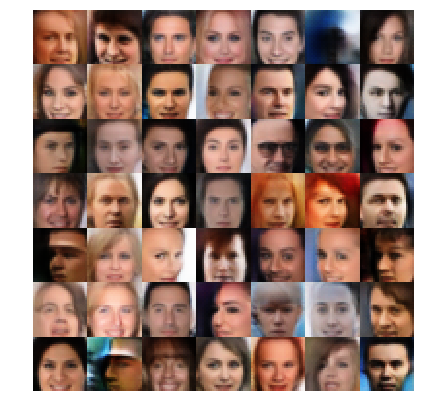

Epoch 5: Step 3026... Discriminator Loss: 1.1821... Generator Loss: 1.0390
Epoch 5: Step 3051... Discriminator Loss: 0.8934... Generator Loss: 1.6051
Epoch 5: Step 3076... Discriminator Loss: 1.1099... Generator Loss: 1.1473
Epoch 5: Step 3101... Discriminator Loss: 1.2341... Generator Loss: 0.6616


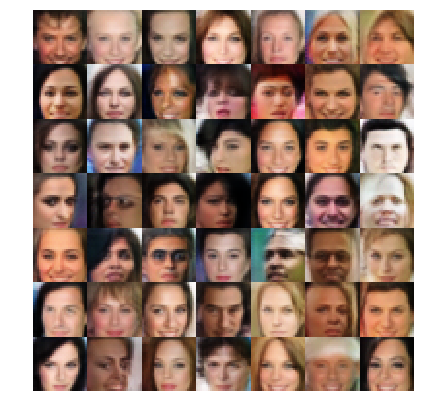

Epoch 5: Step 3126... Discriminator Loss: 0.9478... Generator Loss: 1.0945
Epoch 5: Step 3151... Discriminator Loss: 1.1085... Generator Loss: 0.8703
Epoch 6: Step 26... Discriminator Loss: 1.1203... Generator Loss: 1.4068
Epoch 6: Step 51... Discriminator Loss: 1.2031... Generator Loss: 0.9877
Epoch 6: Step 76... Discriminator Loss: 1.1558... Generator Loss: 1.0176
Epoch 6: Step 101... Discriminator Loss: 1.0044... Generator Loss: 1.1670


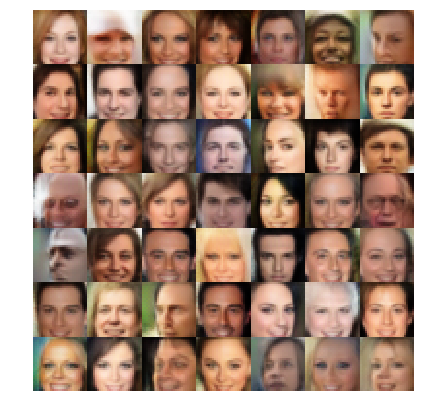

Epoch 6: Step 126... Discriminator Loss: 1.0556... Generator Loss: 1.0084
Epoch 6: Step 151... Discriminator Loss: 1.0985... Generator Loss: 1.6188
Epoch 6: Step 176... Discriminator Loss: 1.1396... Generator Loss: 1.5813
Epoch 6: Step 201... Discriminator Loss: 1.1849... Generator Loss: 0.9846


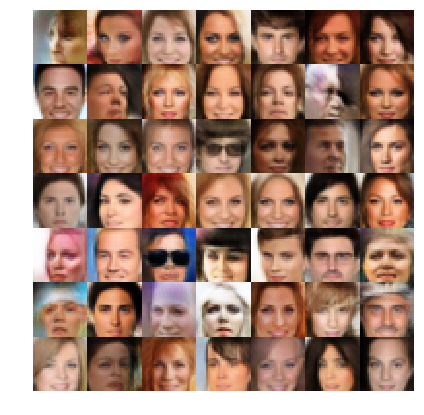

Epoch 6: Step 226... Discriminator Loss: 0.9304... Generator Loss: 1.4637
Epoch 6: Step 251... Discriminator Loss: 1.0295... Generator Loss: 1.1181
Epoch 6: Step 276... Discriminator Loss: 1.1884... Generator Loss: 0.9747
Epoch 6: Step 301... Discriminator Loss: 1.1800... Generator Loss: 1.8021


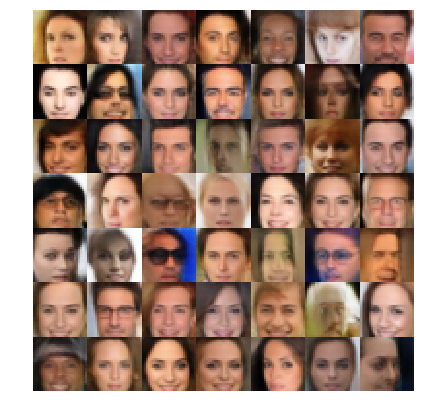

Epoch 6: Step 326... Discriminator Loss: 1.1788... Generator Loss: 1.2024
Epoch 6: Step 351... Discriminator Loss: 1.0848... Generator Loss: 0.9047
Epoch 6: Step 376... Discriminator Loss: 1.2390... Generator Loss: 1.1439
Epoch 6: Step 401... Discriminator Loss: 1.2209... Generator Loss: 1.2993


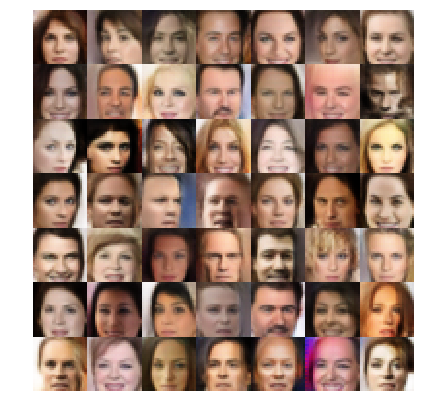

Epoch 6: Step 426... Discriminator Loss: 1.1209... Generator Loss: 0.8144
Epoch 6: Step 451... Discriminator Loss: 1.0365... Generator Loss: 1.3870
Epoch 6: Step 476... Discriminator Loss: 1.3542... Generator Loss: 1.9835
Epoch 6: Step 501... Discriminator Loss: 0.9963... Generator Loss: 1.0535


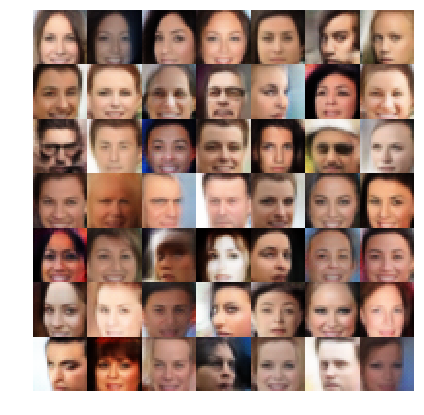

Epoch 6: Step 526... Discriminator Loss: 1.2456... Generator Loss: 1.1998
Epoch 6: Step 551... Discriminator Loss: 1.2453... Generator Loss: 0.8434
Epoch 6: Step 576... Discriminator Loss: 1.1180... Generator Loss: 1.7028
Epoch 6: Step 601... Discriminator Loss: 1.0375... Generator Loss: 1.5828


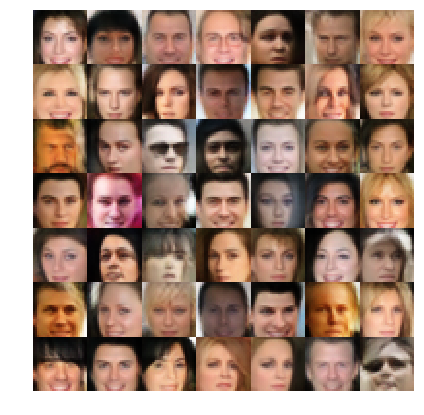

Epoch 6: Step 626... Discriminator Loss: 1.0582... Generator Loss: 0.9794
Epoch 6: Step 651... Discriminator Loss: 0.9755... Generator Loss: 1.1312
Epoch 6: Step 676... Discriminator Loss: 1.1490... Generator Loss: 1.3026
Epoch 6: Step 701... Discriminator Loss: 1.1157... Generator Loss: 1.3241


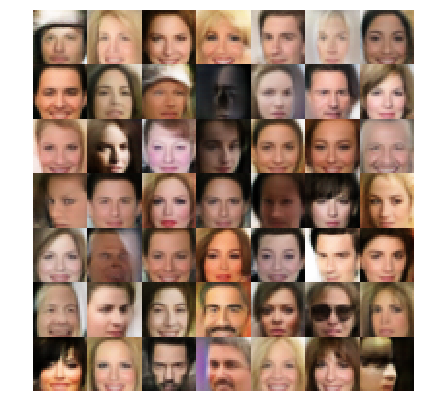

Epoch 6: Step 726... Discriminator Loss: 0.9998... Generator Loss: 2.0104
Epoch 6: Step 751... Discriminator Loss: 0.8824... Generator Loss: 1.6102
Epoch 6: Step 776... Discriminator Loss: 1.3919... Generator Loss: 0.9099
Epoch 6: Step 801... Discriminator Loss: 1.2713... Generator Loss: 0.8089


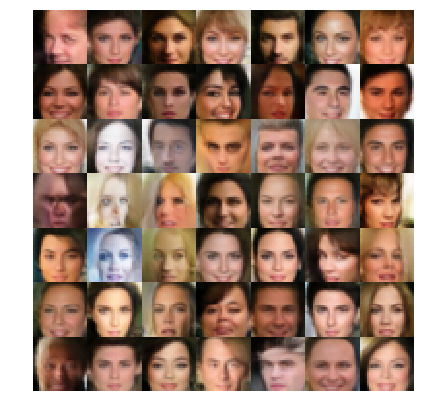

Epoch 6: Step 826... Discriminator Loss: 1.0177... Generator Loss: 1.5099
Epoch 6: Step 851... Discriminator Loss: 1.0552... Generator Loss: 1.1086
Epoch 6: Step 876... Discriminator Loss: 1.0848... Generator Loss: 1.2685
Epoch 6: Step 901... Discriminator Loss: 0.9874... Generator Loss: 1.1476


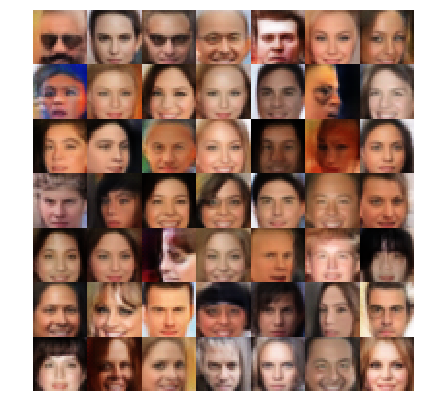

Epoch 6: Step 926... Discriminator Loss: 1.1959... Generator Loss: 0.8537
Epoch 6: Step 951... Discriminator Loss: 1.0183... Generator Loss: 1.4849
Epoch 6: Step 976... Discriminator Loss: 1.1216... Generator Loss: 1.0948
Epoch 6: Step 1001... Discriminator Loss: 1.1203... Generator Loss: 1.0070


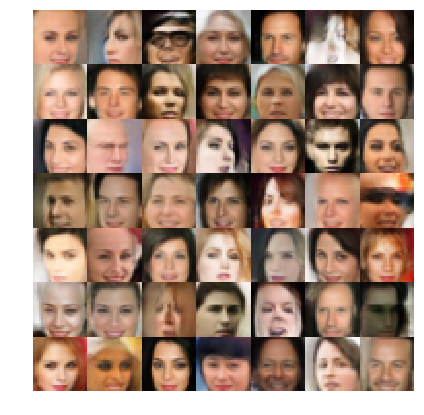

Epoch 6: Step 1026... Discriminator Loss: 0.9981... Generator Loss: 1.1037
Epoch 6: Step 1051... Discriminator Loss: 1.3896... Generator Loss: 2.1564
Epoch 6: Step 1076... Discriminator Loss: 1.1415... Generator Loss: 1.1876
Epoch 6: Step 1101... Discriminator Loss: 1.1643... Generator Loss: 1.7450


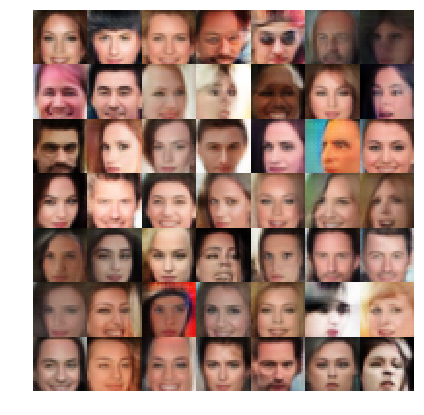

Epoch 6: Step 1126... Discriminator Loss: 0.9242... Generator Loss: 1.0408
Epoch 6: Step 1151... Discriminator Loss: 1.0326... Generator Loss: 0.9228
Epoch 6: Step 1176... Discriminator Loss: 1.5709... Generator Loss: 0.5260
Epoch 6: Step 1201... Discriminator Loss: 1.1864... Generator Loss: 1.1132


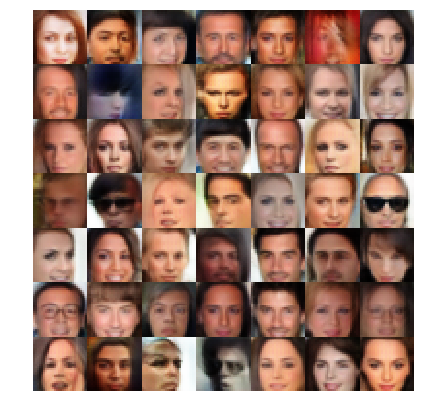

Epoch 6: Step 1226... Discriminator Loss: 1.1850... Generator Loss: 1.3128
Epoch 6: Step 1251... Discriminator Loss: 1.0810... Generator Loss: 1.6540
Epoch 6: Step 1276... Discriminator Loss: 0.9255... Generator Loss: 1.1727
Epoch 6: Step 1301... Discriminator Loss: 1.0593... Generator Loss: 1.1977


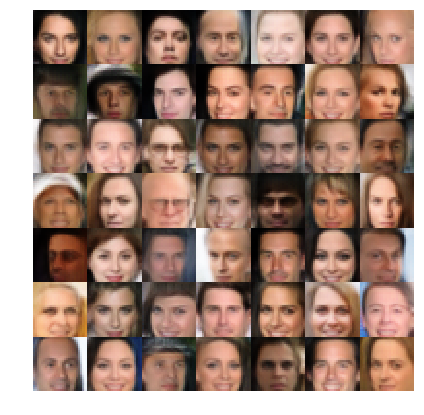

Epoch 6: Step 1326... Discriminator Loss: 0.9969... Generator Loss: 1.2245
Epoch 6: Step 1351... Discriminator Loss: 1.1804... Generator Loss: 1.1334
Epoch 6: Step 1376... Discriminator Loss: 1.0464... Generator Loss: 1.0865
Epoch 6: Step 1401... Discriminator Loss: 1.0139... Generator Loss: 1.2076


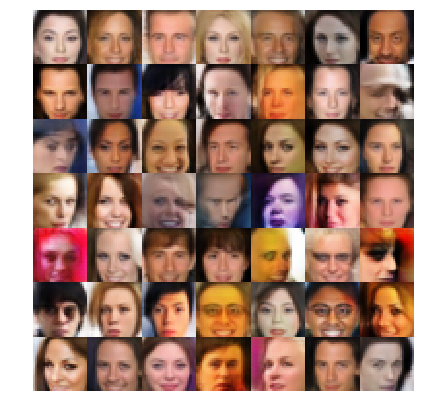

Epoch 6: Step 1426... Discriminator Loss: 1.1109... Generator Loss: 1.7957
Epoch 6: Step 1451... Discriminator Loss: 1.2749... Generator Loss: 0.8404
Epoch 6: Step 1476... Discriminator Loss: 0.9721... Generator Loss: 1.2311
Epoch 6: Step 1501... Discriminator Loss: 0.9572... Generator Loss: 1.2853


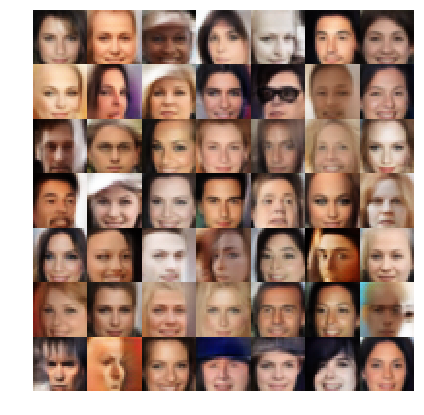

Epoch 6: Step 1526... Discriminator Loss: 1.0924... Generator Loss: 1.6460
Epoch 6: Step 1551... Discriminator Loss: 1.1927... Generator Loss: 1.1996
Epoch 6: Step 1576... Discriminator Loss: 0.8975... Generator Loss: 1.3704
Epoch 6: Step 1601... Discriminator Loss: 0.9377... Generator Loss: 1.2062


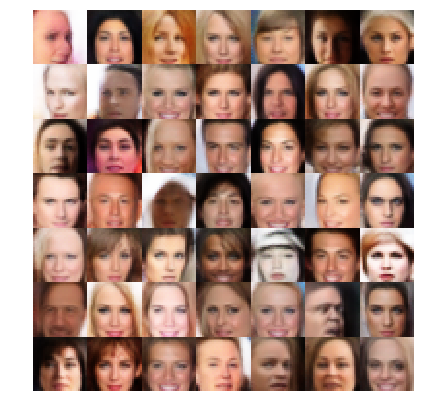

Epoch 6: Step 1626... Discriminator Loss: 1.0270... Generator Loss: 1.2844
Epoch 6: Step 1651... Discriminator Loss: 1.0222... Generator Loss: 1.2262
Epoch 6: Step 1676... Discriminator Loss: 0.8891... Generator Loss: 0.9422
Epoch 6: Step 1701... Discriminator Loss: 0.9290... Generator Loss: 1.2927


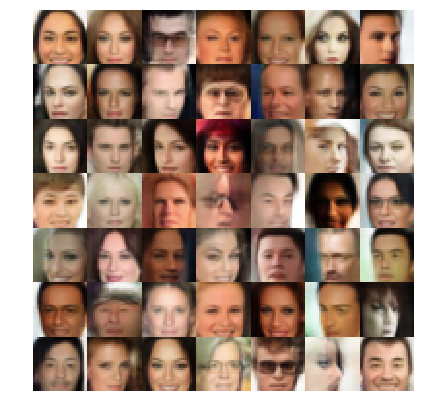

Epoch 6: Step 1726... Discriminator Loss: 1.0794... Generator Loss: 1.7089
Epoch 6: Step 1751... Discriminator Loss: 0.9978... Generator Loss: 1.4482
Epoch 6: Step 1776... Discriminator Loss: 1.0774... Generator Loss: 1.2272
Epoch 6: Step 1801... Discriminator Loss: 1.0877... Generator Loss: 1.2036


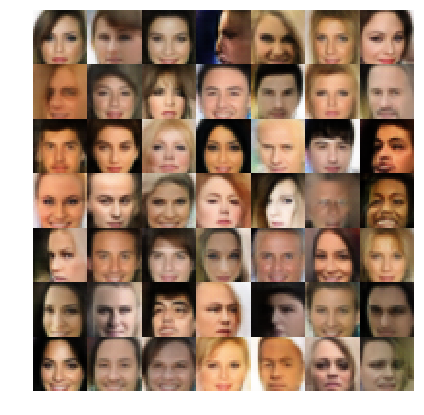

Epoch 6: Step 1826... Discriminator Loss: 1.1358... Generator Loss: 1.4921
Epoch 6: Step 1851... Discriminator Loss: 0.9699... Generator Loss: 1.1414
Epoch 6: Step 1876... Discriminator Loss: 1.0473... Generator Loss: 1.5799
Epoch 6: Step 1901... Discriminator Loss: 1.1665... Generator Loss: 1.0968


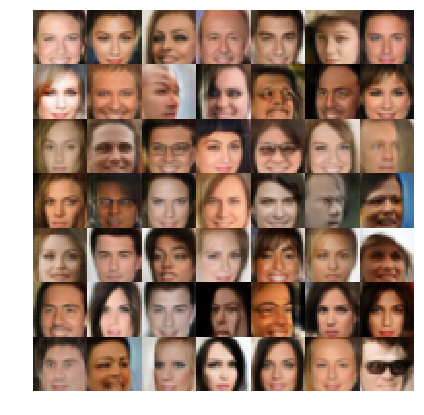

Epoch 6: Step 1926... Discriminator Loss: 0.9755... Generator Loss: 1.2088
Epoch 6: Step 1951... Discriminator Loss: 0.9144... Generator Loss: 1.1947
Epoch 6: Step 1976... Discriminator Loss: 0.9072... Generator Loss: 0.9552
Epoch 6: Step 2001... Discriminator Loss: 1.0708... Generator Loss: 1.7041


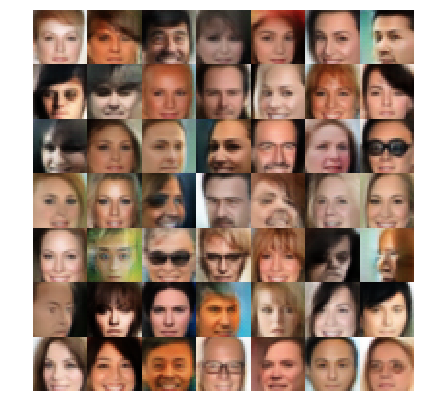

Epoch 6: Step 2026... Discriminator Loss: 0.9884... Generator Loss: 1.4488
Epoch 6: Step 2051... Discriminator Loss: 0.9733... Generator Loss: 1.0817
Epoch 6: Step 2076... Discriminator Loss: 0.9848... Generator Loss: 0.9906
Epoch 6: Step 2101... Discriminator Loss: 1.1666... Generator Loss: 1.3097


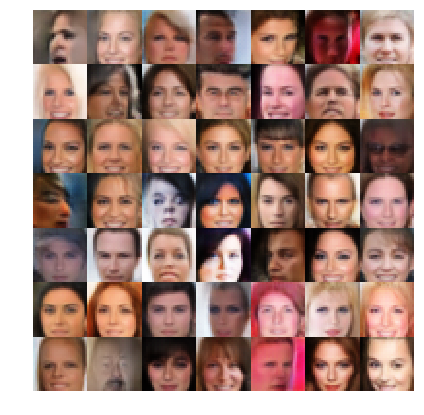

Epoch 6: Step 2126... Discriminator Loss: 1.1349... Generator Loss: 1.1764
Epoch 6: Step 2151... Discriminator Loss: 0.9893... Generator Loss: 1.8950
Epoch 6: Step 2176... Discriminator Loss: 1.0043... Generator Loss: 0.9479
Epoch 6: Step 2201... Discriminator Loss: 1.1402... Generator Loss: 2.1497


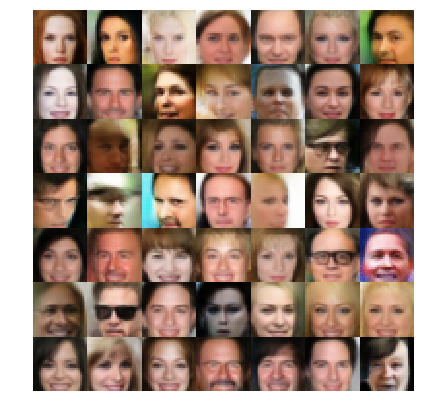

Epoch 6: Step 2226... Discriminator Loss: 0.9531... Generator Loss: 1.2102
Epoch 6: Step 2251... Discriminator Loss: 1.0836... Generator Loss: 1.2796
Epoch 6: Step 2276... Discriminator Loss: 1.0740... Generator Loss: 1.0156
Epoch 6: Step 2301... Discriminator Loss: 1.4662... Generator Loss: 0.8560


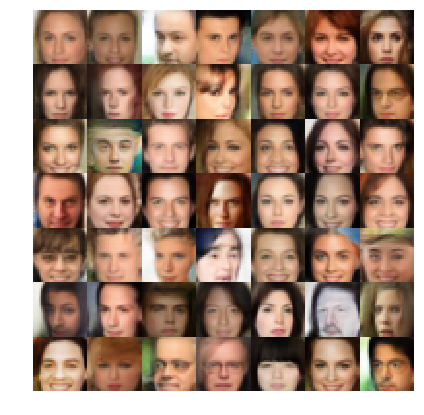

Epoch 6: Step 2326... Discriminator Loss: 1.1095... Generator Loss: 1.1670
Epoch 6: Step 2351... Discriminator Loss: 1.4180... Generator Loss: 0.9389
Epoch 6: Step 2376... Discriminator Loss: 1.0738... Generator Loss: 0.8193
Epoch 6: Step 2401... Discriminator Loss: 1.0179... Generator Loss: 0.7256


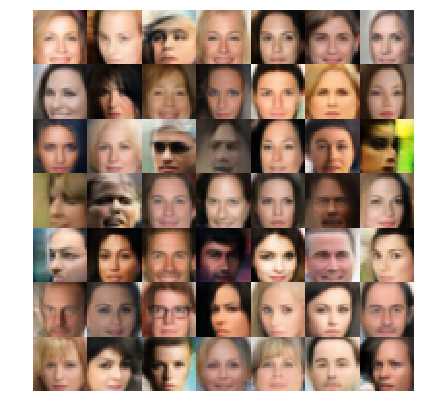

Epoch 6: Step 2426... Discriminator Loss: 1.0313... Generator Loss: 1.6513
Epoch 6: Step 2451... Discriminator Loss: 0.7671... Generator Loss: 2.0833
Epoch 6: Step 2476... Discriminator Loss: 1.1004... Generator Loss: 1.2691
Epoch 6: Step 2501... Discriminator Loss: 1.0170... Generator Loss: 1.1713


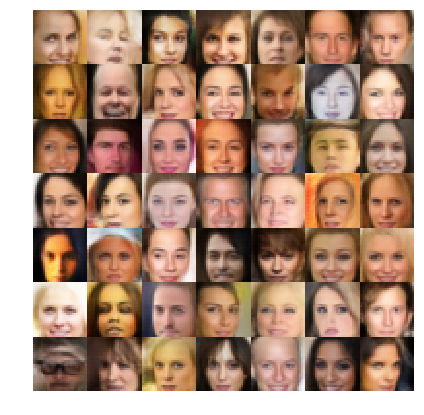

Epoch 6: Step 2526... Discriminator Loss: 0.9276... Generator Loss: 1.4309
Epoch 6: Step 2551... Discriminator Loss: 0.9095... Generator Loss: 1.2333
Epoch 6: Step 2576... Discriminator Loss: 1.2142... Generator Loss: 0.9187
Epoch 6: Step 2601... Discriminator Loss: 1.0887... Generator Loss: 1.3069


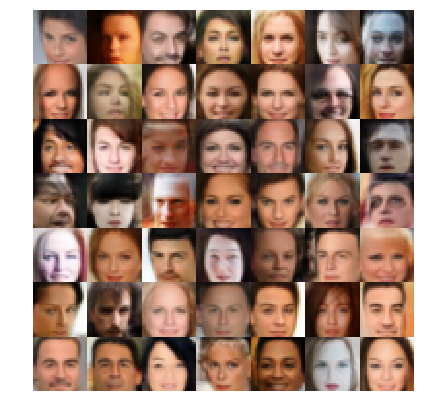

Epoch 6: Step 2626... Discriminator Loss: 0.8585... Generator Loss: 1.2740
Epoch 6: Step 2651... Discriminator Loss: 1.0659... Generator Loss: 1.0473
Epoch 6: Step 2676... Discriminator Loss: 0.8556... Generator Loss: 1.5521
Epoch 6: Step 2701... Discriminator Loss: 1.1335... Generator Loss: 0.8537


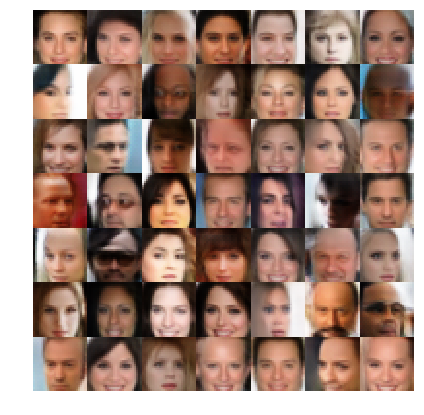

Epoch 6: Step 2726... Discriminator Loss: 0.9190... Generator Loss: 1.0067
Epoch 6: Step 2751... Discriminator Loss: 1.0407... Generator Loss: 1.7740
Epoch 6: Step 2776... Discriminator Loss: 1.0046... Generator Loss: 1.7431
Epoch 6: Step 2801... Discriminator Loss: 0.9492... Generator Loss: 1.9742


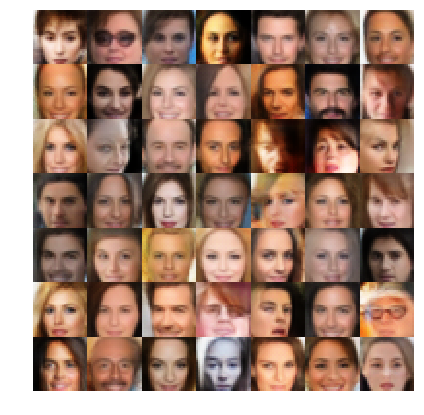

Epoch 6: Step 2826... Discriminator Loss: 1.0211... Generator Loss: 1.2456
Epoch 6: Step 2851... Discriminator Loss: 1.1035... Generator Loss: 1.1905
Epoch 6: Step 2876... Discriminator Loss: 0.8725... Generator Loss: 1.4721
Epoch 6: Step 2901... Discriminator Loss: 0.8629... Generator Loss: 1.3713


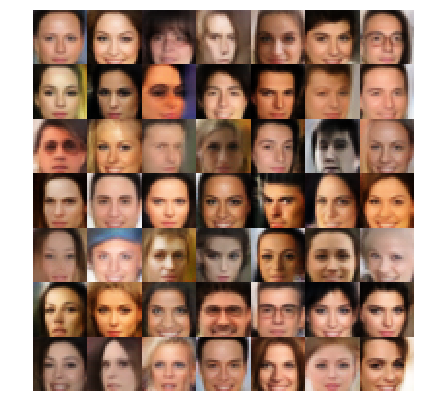

Epoch 6: Step 2926... Discriminator Loss: 0.9450... Generator Loss: 1.2631
Epoch 6: Step 2951... Discriminator Loss: 1.0418... Generator Loss: 1.0490
Epoch 6: Step 2976... Discriminator Loss: 1.1330... Generator Loss: 1.1820
Epoch 6: Step 3001... Discriminator Loss: 0.9985... Generator Loss: 1.2665


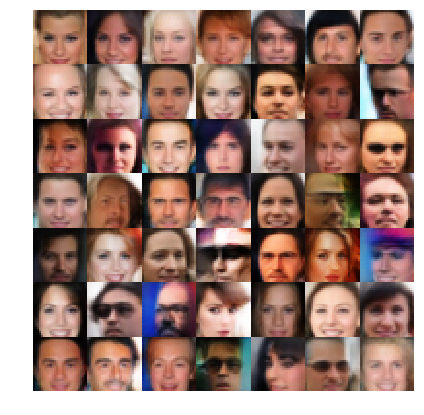

Epoch 6: Step 3026... Discriminator Loss: 1.3178... Generator Loss: 0.9609
Epoch 6: Step 3051... Discriminator Loss: 0.6186... Generator Loss: 2.2108
Epoch 6: Step 3076... Discriminator Loss: 0.9104... Generator Loss: 1.0462
Epoch 6: Step 3101... Discriminator Loss: 1.3207... Generator Loss: 0.7207


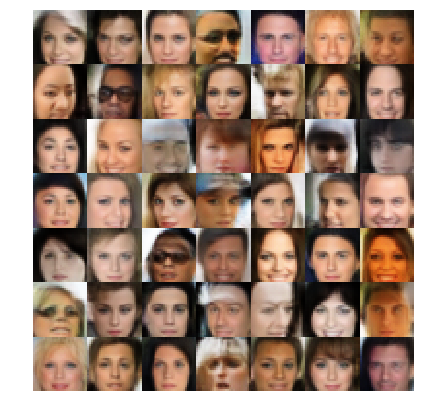

Epoch 6: Step 3126... Discriminator Loss: 0.8134... Generator Loss: 1.5396
Epoch 6: Step 3151... Discriminator Loss: 1.0839... Generator Loss: 1.1087
Epoch 7: Step 26... Discriminator Loss: 1.1253... Generator Loss: 1.5574
Epoch 7: Step 51... Discriminator Loss: 1.0755... Generator Loss: 1.5960
Epoch 7: Step 76... Discriminator Loss: 0.8766... Generator Loss: 1.5459
Epoch 7: Step 101... Discriminator Loss: 1.0757... Generator Loss: 1.8981


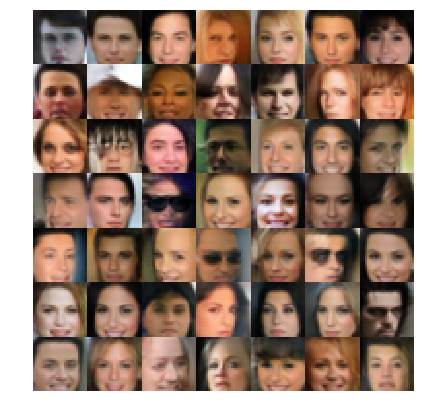

Epoch 7: Step 126... Discriminator Loss: 1.0003... Generator Loss: 1.4578
Epoch 7: Step 151... Discriminator Loss: 0.8684... Generator Loss: 1.3813
Epoch 7: Step 176... Discriminator Loss: 1.1971... Generator Loss: 0.7504
Epoch 7: Step 201... Discriminator Loss: 1.1782... Generator Loss: 0.9312


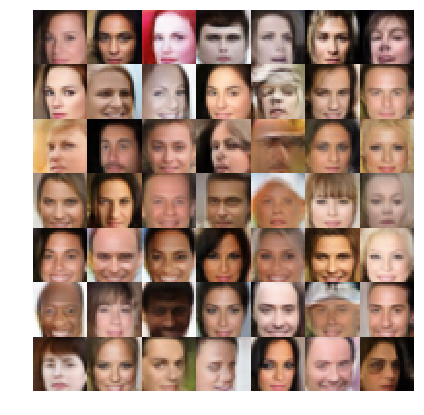

Epoch 7: Step 226... Discriminator Loss: 0.8378... Generator Loss: 1.8459
Epoch 7: Step 251... Discriminator Loss: 1.1290... Generator Loss: 1.1441
Epoch 7: Step 276... Discriminator Loss: 1.0003... Generator Loss: 0.8887
Epoch 7: Step 301... Discriminator Loss: 0.9038... Generator Loss: 1.7987


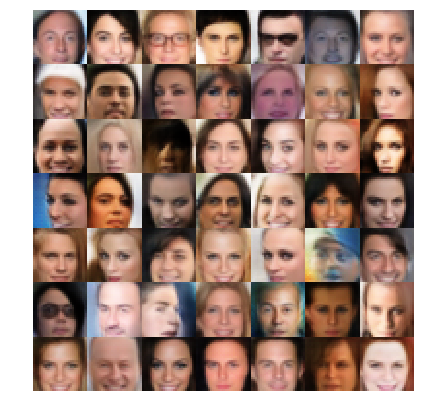

Epoch 7: Step 326... Discriminator Loss: 0.8515... Generator Loss: 1.9489
Epoch 7: Step 351... Discriminator Loss: 1.1048... Generator Loss: 0.7818
Epoch 7: Step 376... Discriminator Loss: 1.2345... Generator Loss: 1.9106
Epoch 7: Step 401... Discriminator Loss: 0.9158... Generator Loss: 1.5819


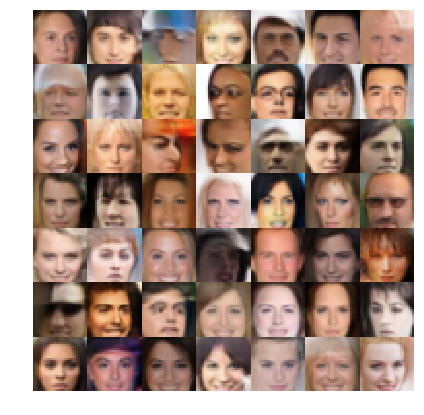

Epoch 7: Step 426... Discriminator Loss: 1.1794... Generator Loss: 0.8629
Epoch 7: Step 451... Discriminator Loss: 1.3074... Generator Loss: 1.3229
Epoch 7: Step 476... Discriminator Loss: 0.9420... Generator Loss: 1.1232
Epoch 7: Step 501... Discriminator Loss: 1.0942... Generator Loss: 1.5415


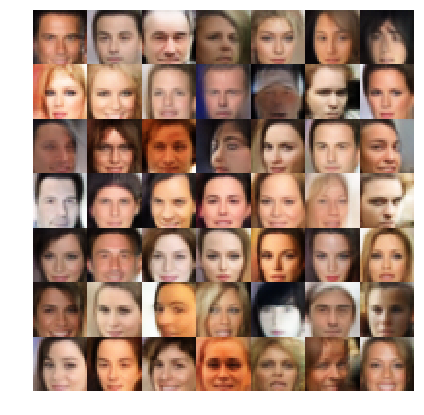

Epoch 7: Step 526... Discriminator Loss: 1.1094... Generator Loss: 1.2447
Epoch 7: Step 551... Discriminator Loss: 1.5344... Generator Loss: 0.5757
Epoch 7: Step 576... Discriminator Loss: 0.9222... Generator Loss: 1.2824
Epoch 7: Step 601... Discriminator Loss: 0.9244... Generator Loss: 1.3655


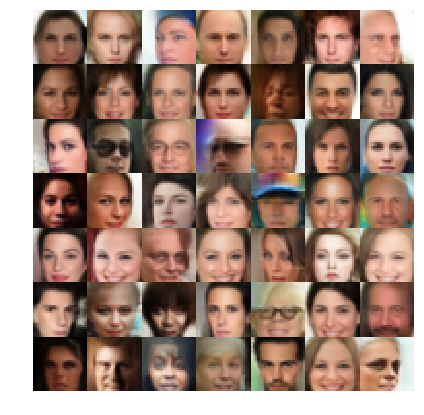

Epoch 7: Step 626... Discriminator Loss: 0.8290... Generator Loss: 1.3880
Epoch 7: Step 651... Discriminator Loss: 0.9412... Generator Loss: 1.1558
Epoch 7: Step 676... Discriminator Loss: 1.2572... Generator Loss: 0.7977
Epoch 7: Step 701... Discriminator Loss: 1.1745... Generator Loss: 1.4229


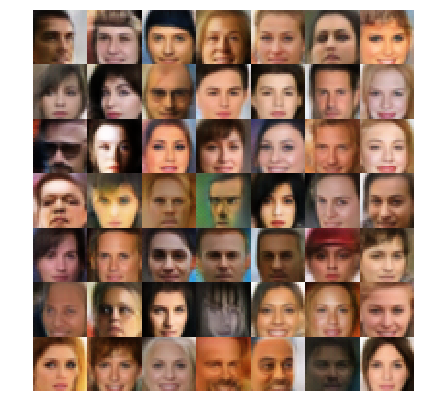

Epoch 7: Step 726... Discriminator Loss: 0.8797... Generator Loss: 1.5413
Epoch 7: Step 751... Discriminator Loss: 1.0531... Generator Loss: 2.1724
Epoch 7: Step 776... Discriminator Loss: 1.1032... Generator Loss: 0.9453
Epoch 7: Step 801... Discriminator Loss: 0.8557... Generator Loss: 1.2137


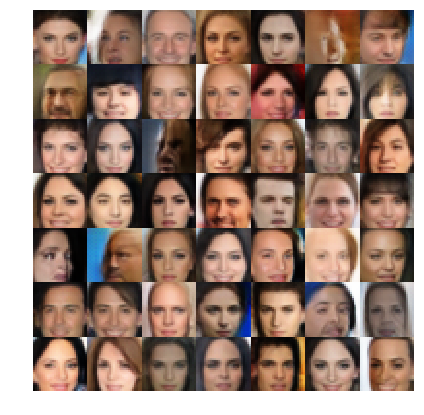

Epoch 7: Step 826... Discriminator Loss: 1.0183... Generator Loss: 1.8249
Epoch 7: Step 851... Discriminator Loss: 0.9049... Generator Loss: 1.3452
Epoch 7: Step 876... Discriminator Loss: 1.0879... Generator Loss: 1.0838
Epoch 7: Step 901... Discriminator Loss: 1.0368... Generator Loss: 1.9860


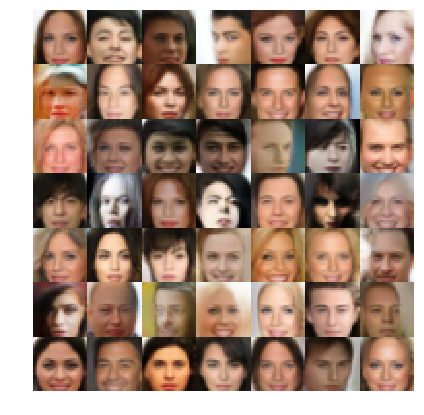

Epoch 7: Step 926... Discriminator Loss: 1.1653... Generator Loss: 0.9745
Epoch 7: Step 951... Discriminator Loss: 1.0695... Generator Loss: 2.1013
Epoch 7: Step 976... Discriminator Loss: 1.2291... Generator Loss: 0.6353
Epoch 7: Step 1001... Discriminator Loss: 1.2233... Generator Loss: 1.5305


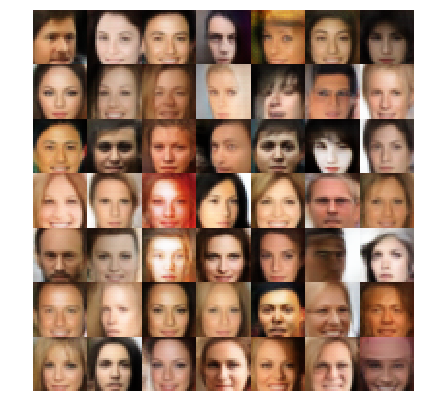

Epoch 7: Step 1026... Discriminator Loss: 0.9442... Generator Loss: 1.4703
Epoch 7: Step 1051... Discriminator Loss: 1.1377... Generator Loss: 1.5220
Epoch 7: Step 1076... Discriminator Loss: 1.0191... Generator Loss: 0.8500
Epoch 7: Step 1101... Discriminator Loss: 1.2222... Generator Loss: 0.9469


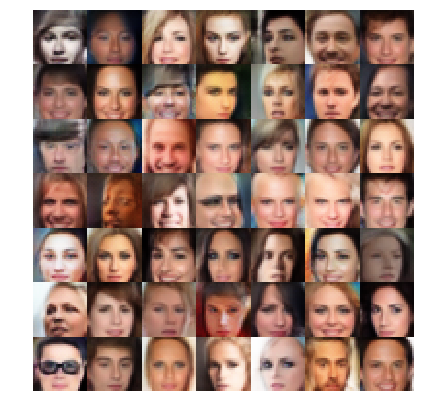

Epoch 7: Step 1126... Discriminator Loss: 0.9020... Generator Loss: 1.3334
Epoch 7: Step 1151... Discriminator Loss: 0.9094... Generator Loss: 1.5111
Epoch 7: Step 1176... Discriminator Loss: 1.0581... Generator Loss: 1.1409
Epoch 7: Step 1201... Discriminator Loss: 1.0612... Generator Loss: 1.2266


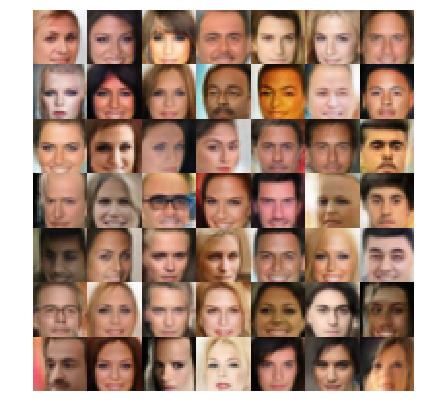

Epoch 7: Step 1226... Discriminator Loss: 0.8692... Generator Loss: 2.1451
Epoch 7: Step 1251... Discriminator Loss: 0.9552... Generator Loss: 1.5340
Epoch 7: Step 1276... Discriminator Loss: 0.9836... Generator Loss: 1.7751
Epoch 7: Step 1301... Discriminator Loss: 1.0145... Generator Loss: 2.5234


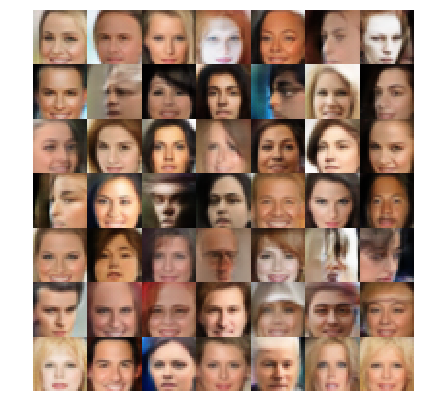

Epoch 7: Step 1326... Discriminator Loss: 1.2239... Generator Loss: 0.9984
Epoch 7: Step 1351... Discriminator Loss: 1.1045... Generator Loss: 2.1544
Epoch 7: Step 1376... Discriminator Loss: 1.2297... Generator Loss: 0.9631
Epoch 7: Step 1401... Discriminator Loss: 0.9534... Generator Loss: 1.0842


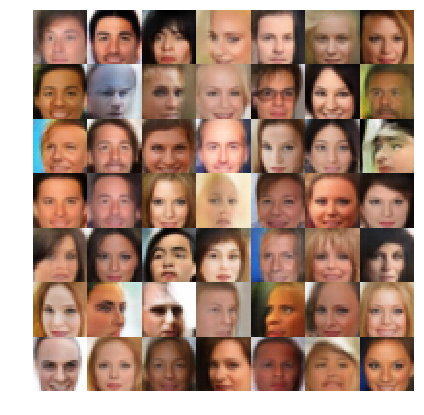

Epoch 7: Step 1426... Discriminator Loss: 0.7933... Generator Loss: 1.6242
Epoch 7: Step 1451... Discriminator Loss: 1.0923... Generator Loss: 0.9814
Epoch 7: Step 1476... Discriminator Loss: 0.8919... Generator Loss: 1.5087
Epoch 7: Step 1501... Discriminator Loss: 0.8890... Generator Loss: 1.8951


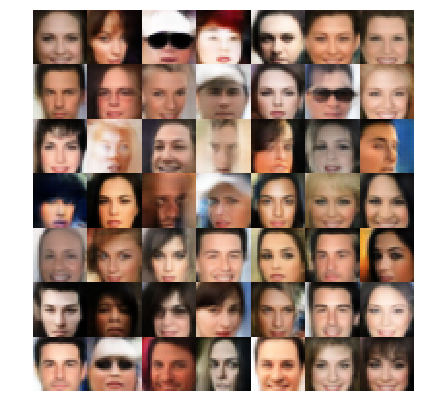

Epoch 7: Step 1526... Discriminator Loss: 1.0807... Generator Loss: 1.2720
Epoch 7: Step 1551... Discriminator Loss: 0.8868... Generator Loss: 1.3405
Epoch 7: Step 1576... Discriminator Loss: 0.8175... Generator Loss: 1.4190
Epoch 7: Step 1601... Discriminator Loss: 0.9004... Generator Loss: 1.5411


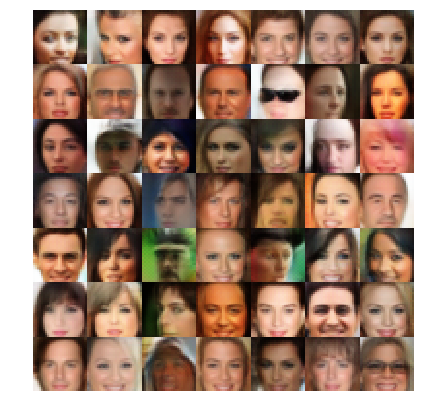

Epoch 7: Step 1626... Discriminator Loss: 1.0997... Generator Loss: 1.7103
Epoch 7: Step 1651... Discriminator Loss: 1.2236... Generator Loss: 0.4797
Epoch 7: Step 1676... Discriminator Loss: 0.9326... Generator Loss: 1.6099
Epoch 7: Step 1701... Discriminator Loss: 1.0737... Generator Loss: 0.9501


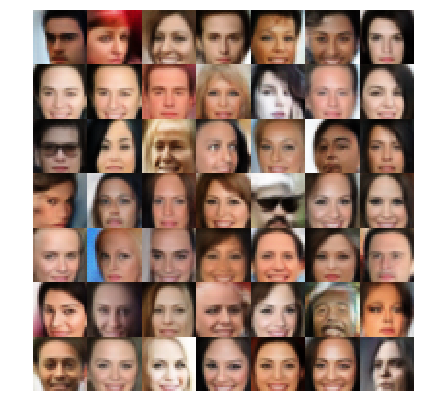

Epoch 7: Step 1726... Discriminator Loss: 0.9815... Generator Loss: 1.4480
Epoch 7: Step 1751... Discriminator Loss: 1.0334... Generator Loss: 1.4449
Epoch 7: Step 1776... Discriminator Loss: 0.8106... Generator Loss: 1.4204
Epoch 7: Step 1801... Discriminator Loss: 1.2583... Generator Loss: 1.3970


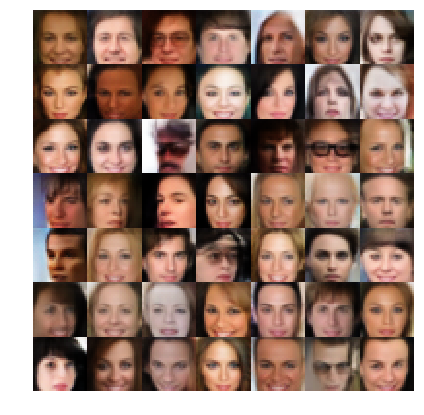

Epoch 7: Step 1826... Discriminator Loss: 1.0505... Generator Loss: 1.0560
Epoch 7: Step 1851... Discriminator Loss: 1.0434... Generator Loss: 1.2861
Epoch 7: Step 1876... Discriminator Loss: 1.1911... Generator Loss: 1.0476
Epoch 7: Step 1901... Discriminator Loss: 1.1389... Generator Loss: 0.8332


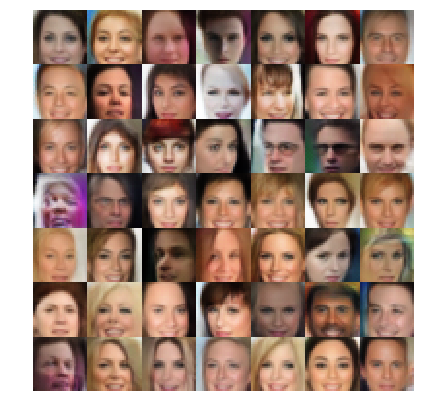

Epoch 7: Step 1926... Discriminator Loss: 1.0290... Generator Loss: 1.6896
Epoch 7: Step 1951... Discriminator Loss: 0.7887... Generator Loss: 2.0365
Epoch 7: Step 1976... Discriminator Loss: 1.1764... Generator Loss: 1.1515
Epoch 7: Step 2001... Discriminator Loss: 0.7945... Generator Loss: 1.8136


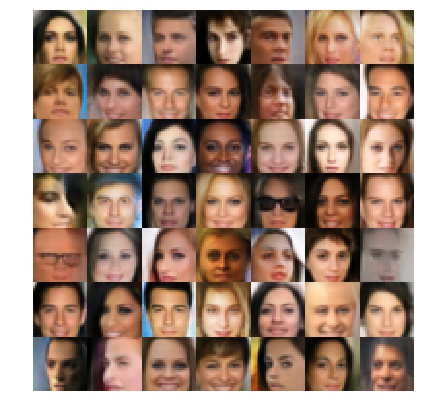

Epoch 7: Step 2026... Discriminator Loss: 1.0080... Generator Loss: 1.5727
Epoch 7: Step 2051... Discriminator Loss: 1.0565... Generator Loss: 1.1637
Epoch 7: Step 2076... Discriminator Loss: 0.9061... Generator Loss: 1.6043
Epoch 7: Step 2101... Discriminator Loss: 0.7583... Generator Loss: 1.4805


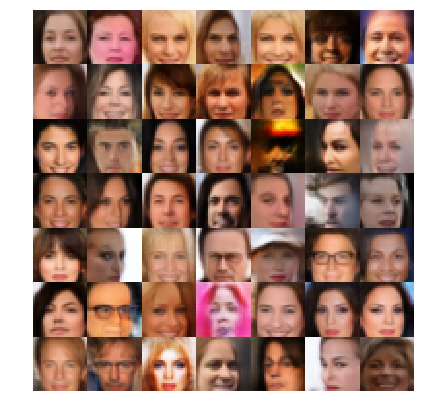

Epoch 7: Step 2126... Discriminator Loss: 0.6213... Generator Loss: 2.2547
Epoch 7: Step 2151... Discriminator Loss: 0.9374... Generator Loss: 1.4041
Epoch 7: Step 2176... Discriminator Loss: 0.9120... Generator Loss: 1.4119
Epoch 7: Step 2201... Discriminator Loss: 0.8695... Generator Loss: 1.3227


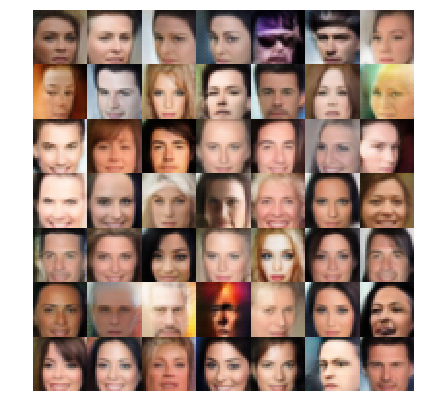

Epoch 7: Step 2226... Discriminator Loss: 0.9486... Generator Loss: 2.0670
Epoch 7: Step 2251... Discriminator Loss: 1.1606... Generator Loss: 1.0550
Epoch 7: Step 2276... Discriminator Loss: 1.0173... Generator Loss: 1.4059
Epoch 7: Step 2301... Discriminator Loss: 1.0360... Generator Loss: 1.4744


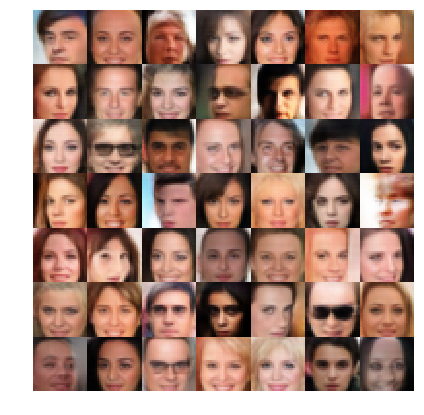

Epoch 7: Step 2326... Discriminator Loss: 0.8264... Generator Loss: 1.2967
Epoch 7: Step 2351... Discriminator Loss: 1.0962... Generator Loss: 0.9624
Epoch 7: Step 2376... Discriminator Loss: 0.9083... Generator Loss: 1.1980
Epoch 7: Step 2401... Discriminator Loss: 1.0229... Generator Loss: 0.9474


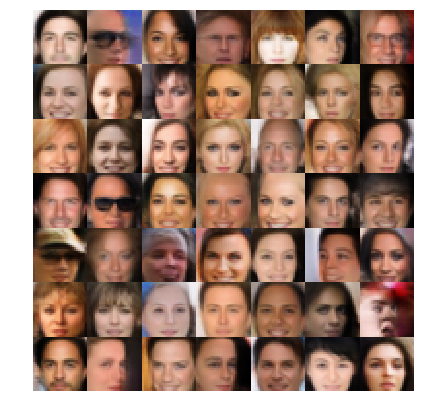

Epoch 7: Step 2426... Discriminator Loss: 1.1390... Generator Loss: 2.3150
Epoch 7: Step 2451... Discriminator Loss: 0.9408... Generator Loss: 0.8497
Epoch 7: Step 2476... Discriminator Loss: 0.9305... Generator Loss: 1.4362
Epoch 7: Step 2501... Discriminator Loss: 0.9724... Generator Loss: 2.6102


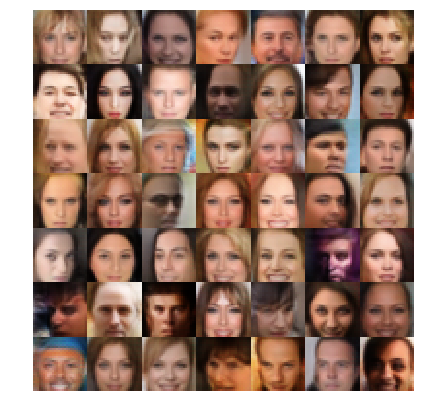

Epoch 7: Step 2526... Discriminator Loss: 0.9736... Generator Loss: 1.7523
Epoch 7: Step 2551... Discriminator Loss: 1.0577... Generator Loss: 1.4596
Epoch 7: Step 2576... Discriminator Loss: 1.1039... Generator Loss: 0.9095
Epoch 7: Step 2601... Discriminator Loss: 0.9077... Generator Loss: 1.7137


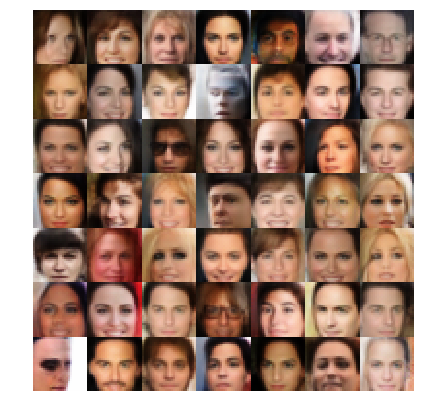

Epoch 7: Step 2626... Discriminator Loss: 0.6927... Generator Loss: 1.3574
Epoch 7: Step 2651... Discriminator Loss: 1.4221... Generator Loss: 0.8861
Epoch 7: Step 2676... Discriminator Loss: 1.2417... Generator Loss: 2.0735
Epoch 7: Step 2701... Discriminator Loss: 0.9458... Generator Loss: 1.3471


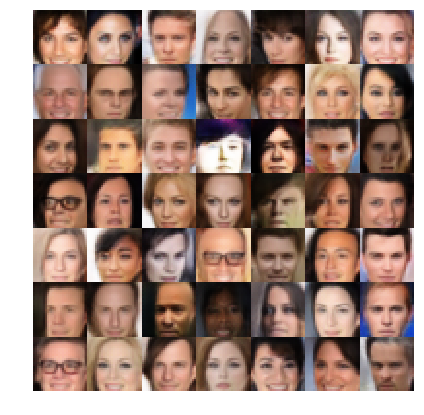

Epoch 7: Step 2726... Discriminator Loss: 1.0116... Generator Loss: 1.1348
Epoch 7: Step 2751... Discriminator Loss: 0.9935... Generator Loss: 2.0540
Epoch 7: Step 2776... Discriminator Loss: 0.9407... Generator Loss: 1.8391
Epoch 7: Step 2801... Discriminator Loss: 1.0247... Generator Loss: 1.9953


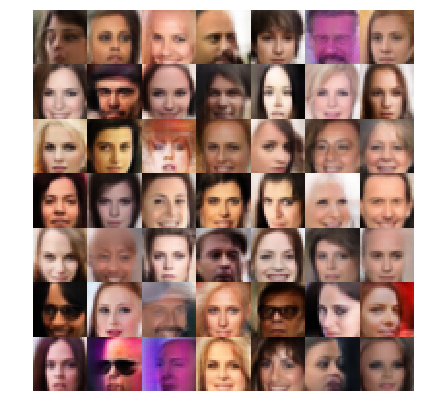

Epoch 7: Step 2826... Discriminator Loss: 0.8610... Generator Loss: 2.0678
Epoch 7: Step 2851... Discriminator Loss: 0.9319... Generator Loss: 1.3593
Epoch 7: Step 2876... Discriminator Loss: 1.3791... Generator Loss: 0.5489
Epoch 7: Step 2901... Discriminator Loss: 1.2609... Generator Loss: 0.9079


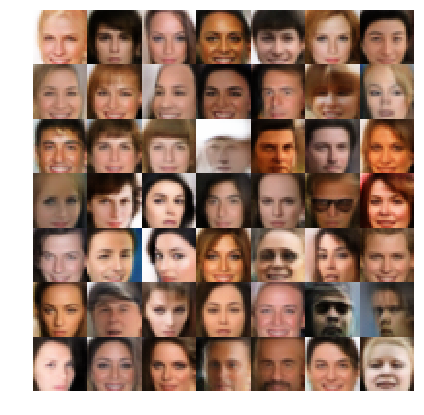

Epoch 7: Step 2926... Discriminator Loss: 0.9731... Generator Loss: 1.1216
Epoch 7: Step 2951... Discriminator Loss: 0.9545... Generator Loss: 1.0651
Epoch 7: Step 2976... Discriminator Loss: 0.8314... Generator Loss: 1.2647
Epoch 7: Step 3001... Discriminator Loss: 0.7428... Generator Loss: 2.5432


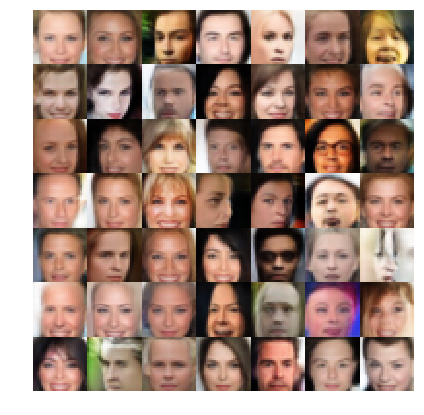

Epoch 7: Step 3026... Discriminator Loss: 0.9509... Generator Loss: 1.2514
Epoch 7: Step 3051... Discriminator Loss: 0.9284... Generator Loss: 1.6992
Epoch 7: Step 3076... Discriminator Loss: 0.9850... Generator Loss: 1.2176
Epoch 7: Step 3101... Discriminator Loss: 1.1330... Generator Loss: 1.5765


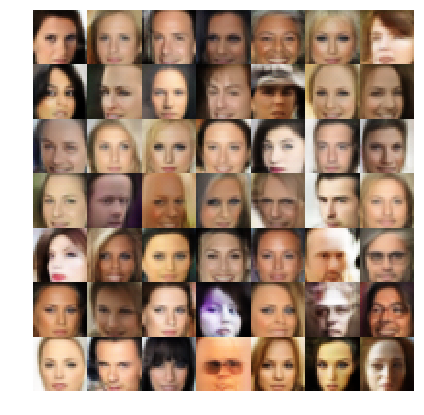

Epoch 7: Step 3126... Discriminator Loss: 0.9407... Generator Loss: 1.5099
Epoch 7: Step 3151... Discriminator Loss: 1.0693... Generator Loss: 1.7776


In [17]:
batch_size = 64
z_dim = 100
learning_rate = 0.0005  # was 0.001
beta1 = 0.28   # was 0.3?



epochs = 7

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    training_history = train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

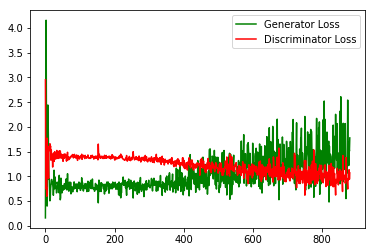

In [18]:
g_loss_log = training_history[1]
d_loss_log = training_history[0]
pyplot.plot(g_loss_log, 'g')
pyplot.plot(d_loss_log, 'r')
pyplot.legend(['Generator Loss', 'Discriminator Loss'])